In [1]:
import math
import random
from typing import Tuple
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
random.seed(10)

In [2]:
import pickle
from pathlib import Path

# Structure: (theta, phi) -> (theta_etilt, phi_scan)
saved_tp = dict()
saved_tp_file = Path("t3p3.pkl")
if saved_tp_file.is_file():
    with open(saved_tp_file, "rb") as f:
        saved_tp = pickle.load(f)
        
# Structure: (segment, polygon) -> (boolean True or False)
saved_los = dict()

saved_los_file = Path("los3.pkl")
if saved_los_file.is_file():
    with open(saved_los_file, "rb") as f:
        saved_los = pickle.load(f)

In [3]:
!pip install Geometry3D shapely

In [4]:
from Geometry3D import *
from shapely import geometry

In [5]:
data = pd.read_csv("C:\\Users\\tniloy\\Downloads\\opencellid dataset\\310.csv", names=['radio', 'mcc', 'mnc', 'lac', 'cid', 'unit', 'longitude', 'latitude', 'range', 'samples', 'changeable', 'created', 'updated', 'averageSignal'])

In [6]:
data.head (10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
0,GSM,310,260,32192,22568,0,-73.858566,40.898438,1779,12,1,1459696254,1489125559,0
1,GSM,310,260,22629,61562,0,-95.876501,41.286475,3367,17,1,1459810860,1609205988,0
2,GSM,310,260,51052,44152,0,-71.084483,42.381728,1000,44,1,1459812328,1514115939,0
3,GSM,310,260,51051,40311,0,-71.085559,42.381356,1000,52,1,1459812328,1527695374,0
4,GSM,310,260,5973,60092,0,-95.570630,29.735371,1000,22,1,1459692332,1490851584,0
5,GSM,310,410,19007,7133,0,-87.258205,40.153886,19135,6,1,1459699529,1472415099,0
6,GSM,310,410,53005,50671,0,-95.563889,30.280380,1000,1,1,1459775023,1459775023,0
7,GSM,310,260,46136,15418,0,-76.999741,39.160080,1000,1,1,1459663271,1459663271,0
8,GSM,310,410,27672,59021,0,-81.741964,26.213691,1000,11,1,1459687298,1491031828,0
9,GSM,310,260,5973,50942,0,-95.560226,29.736557,1000,6,1,1459692332,1469493454,0


In [7]:
# center_x = 0
# center_y = 0
# center_z = 0
# FSS POsition:
lat_FSS= 37.20250
lon_FSS= -80.43444
R  = 6.371e6  #Radius of the earth

x_FSS = R * math.cos(math.radians(lat_FSS)) * math.cos(math.radians(lon_FSS))
y_FSS = R * math.cos(math.radians(lat_FSS)) * math.sin(math.radians(lon_FSS))
z_FSS = R * math.sin(math.radians(lat_FSS))

print("X, Y, Z = "+ str([x_FSS, y_FSS, z_FSS]))


radius=5000 #radius of the inclusion zone
latitude_range = radius / 110574
longitude_range = radius/(111320*math.cos(math.radians(latitude_range)))
print("Total area of inclusion zone is = " + str(radius*radius*math.pi))

X, Y, Z = [843264.3231973607, -5003968.368478095, 3852122.3823358943]
Total area of inclusion zone is = 78539816.33974482


In [8]:
print(latitude_range)
print(longitude_range)

0.04521858664785573
0.044915572737550945


In [9]:
data_within_zone = data[(data['radio'] == 'GSM') & (data['longitude'] <= (lon_FSS + longitude_range)) & (data['longitude'] >= (lon_FSS - longitude_range)) & (data['latitude'] <= (lat_FSS + latitude_range)) & (data['latitude'] >= (lat_FSS - latitude_range))]

data_within_zone.head(10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
780410,GSM,310,260,37630,43582,0,-80.393175,37.196127,8733,3992,1,1413757287,1435049916,0
1813932,GSM,310,260,32453,43561,0,-80.421524,37.189560,1000,9,1,1458834001,1491931840,0
1813934,GSM,310,260,32453,43602,0,-80.410309,37.233810,1000,6,1,1458834001,1479555225,0
1814053,GSM,310,260,32453,43822,0,-80.406704,37.227516,1000,8,1,1458834001,1479576548,0
1814075,GSM,310,260,32453,43583,0,-80.461073,37.203233,2207,15,1,1458834001,1477155991,0
1814213,GSM,310,260,32453,43581,0,-80.409897,37.217972,1000,5,1,1458834001,1473235293,0
1814220,GSM,310,260,32453,43601,0,-80.425186,37.236099,1000,6,1,1458834001,1473191254,0
1814361,GSM,310,260,32453,43562,0,-80.391645,37.165063,1000,11,1,1458834001,1489446412,0
1814366,GSM,310,260,32453,43603,0,-80.425415,37.222710,1000,4,1,1458834001,1474352285,0
1814368,GSM,310,260,32453,43621,0,-80.393486,37.224279,1033,56,1,1458834001,1482422269,0


In [10]:
len(data_within_zone)

33

In [11]:
import json
with open ('C:\\Users\\tniloy\\Downloads\\export (1).geojson') as f:
    df=json.load(f)
    data1=pd.json_normalize(df,record_path=['features'])
data1.head(10)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Feature,relation/548333,relation/548333,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Feature,relation/548339,relation/548339,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Feature,relation/548344,relation/548344,1406,Giles Road,church,NaN,Blacksburg First Wesleyan Church,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Feature,relation/548347,relation/548347,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Feature,relation/548348,relation/548348,NaN,NaN,residential,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Feature,relation/548371,relation/548371,1416,Palmer Drive,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Feature,relation/548372,relation/548372,900,Dickerson Lane,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Feature,relation/548373,relation/548373,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Feature,relation/548386,relation/548386,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
data1[data1["properties.height"].notnull()].head(20)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,Feature,relation/1360465,relation/1360465,NaN,NaN,university,14.86,East Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34,Feature,relation/1360466,relation/1360466,NaN,NaN,dormitory,14.86,West Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,Feature,relation/1360467,relation/1360467,NaN,NaN,dormitory,11.27,Slusher Wing,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36,Feature,relation/1360468,relation/1360468,NaN,NaN,dormitory,33.59,Slusher Tower,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37,Feature,relation/1360469,relation/1360469,NaN,NaN,dormitory,14.86,Main Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,Feature,way/26210227,way/26210227,NaN,NaN,university,15.47,Cheatham Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
67,Feature,way/26210236,way/26210236,285,Ag Quad Lane,university,11.57,Dietrick Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,Feature,way/32709325,way/32709325,570,Washington Street Southwest,dormitory,25.82,Hoge Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98,Feature,way/32953606,way/32953606,210,Drillfield Drive,university,11.61,Sandy Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
data1["geometry.coordinates"].head(10)

0    [[[-80.4194702, 37.2238774], [-80.4194505, 37....
1    [[[-80.4070717, 37.2320238], [-80.4069865, 37....
2    [[[-80.4068521, 37.2319488], [-80.4069373, 37....
3    [[[-80.4104274, 37.2506844], [-80.4104412, 37....
4    [[[-80.4355296, 37.2138316], [-80.4355103, 37....
5    [[[-80.4416012, 37.2238365], [-80.4417281, 37....
6    [[[-80.3924701, 37.2185727], [-80.3923812, 37....
7    [[[-80.4121293, 37.2397986], [-80.4121648, 37....
8    [[[-80.4075916, 37.2253453], [-80.4076676, 37....
9    [[[-80.4071473, 37.2322051], [-80.4072218, 37....
Name: geometry.coordinates, dtype: object

In [14]:
class Building:
    def __init__(self, coordinates=None, height=None):
        self.coordinates = []
        if coordinates is not None:
            self.coordinates = coordinates
        
        if height is None or not str(height).isdigit():
            self.height = random.uniform(10, 40)
        else:
            self.height = height
        
        self.x_coord, self.y_coord, self.z_coord = self.latlon_to_XYZ()
        
        self.points = []
        for i in range(len(self.x_coord)):
            x, y, z = self.x_coord[i], self.y_coord[i], self.z_coord[i]
            self.points.append(Point(x,y,z))
        
        self.xy_points = np.array([(p.x, p.y) for p in self.points])
        self.xy_polygon = geometry.Polygon(self.xy_points)
        
        self.wall_polygons = self.get_wall_polygons()
    
    def latlon_to_XYZ(self):
        x_coord = np.array([])
        y_coord = np.array([])
        z_coord = np.array([])
        
        # bottom points of building at each coordinate
        for lon, lat in self.coordinates:
            x = R * math.cos(math.radians(lat)) * math.cos(math.radians(lon))
            y = R * math.cos(math.radians(lat)) * math.sin(math.radians(lon))
            x_coord = np.append(x_coord, x)
            y_coord = np.append(y_coord, y)
            z_coord = np.append(z_coord, 0)
            # z_coord = np.append(z_coord, self.height)
            
        # make coordinates to relative to FSS position
        x_coord -= x_FSS
        y_coord -= y_FSS
        
        return x_coord, y_coord, z_coord

    def get_wall_polygons(self):
        polygons = []

        # points = [Point(x,y,0) for x,y in p.boundary.coords]
        # polygons.append(ConvexPolygon(points))
        points = [Point(x,y,self.height) for x,y in self.xy_polygon.boundary.coords]
        # polygons.append(ConvexPolygon(points))

        for i in range(len(points)-1):
            high_point_1 = points[i]
            high_point_2 = points[i + 1]
            low_point_1 = Point(high_point_1.x, high_point_1.y, 0)
            low_point_2 = Point(high_point_2.x, high_point_2.y, 0)

            poly_points = [low_point_1, low_point_2, high_point_1, high_point_2]
            #print(poly_points)
            polygons.append(ConvexPolygon(poly_points))
            
        return polygons
        

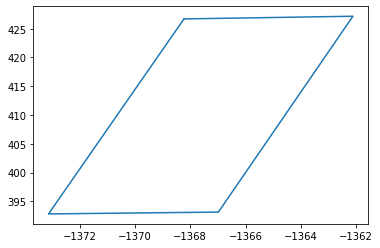

In [15]:
from shapely import geometry

b = Building(data1.iloc[500]["geometry.coordinates"][0], data1.iloc[500]["properties.height"])
x, y = b.xy_polygon.boundary.xy
plt.plot(x, y)

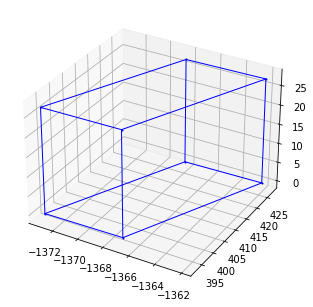

In [16]:
r = Renderer(backend='matplotlib')
for p in b.wall_polygons:
    r.add((p,'b',1),normal_length=0)
r.show()

In [17]:
from tqdm import tqdm
buildings = []

for i in tqdm(range(len(data1))):
    for coords in data1.iloc[i]["geometry.coordinates"]:
        try:
            buildings.append(Building(coords, data1.iloc[i]["properties.height"]))
        except:
            print(f"Skipping building {i}")

  1%|▌                                                                              | 64/8644 [00:00<00:40, 213.01it/s]

Skipping building 26
Skipping building 26
Skipping building 27
Skipping building 27
Skipping building 27
Skipping building 28
Skipping building 28
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 53
Skipping building 53
Skipping building 53
Skipping building 53


100%|█████████████████████████████████████████████████████████████████████████████| 8644/8644 [00:17<00:00, 493.93it/s]

Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8170
Skipping building 8170
Skipping building 8170
Skipping bu

In [18]:
class FSS_Channels:
  # channels start at 0, so a channel plan with 8 channels is from 0 to 7

  band_width = 240e6 # 240MHz

  # 10.7-12.7 GHz frequency range
  range_start = 10.7e9 # 10.7GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 8

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # FSS channel spacing should be 10MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel_start = int((0.5 + channel) * FSS_Channels.space_between_channels + channel * FSS_Channels.band_width)
    channel_end = channel_start + FSS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [19]:
class BS_Channels:
  # channels start at 1, so a channel plan with 5 channels is from 1 to 5

  band_width = 100e6 # 100MHz

  # 12.2-12.7 GHz frequency range
  range_start = 12.2e9 # 12.2GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 5

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # BS channel spacing should be 0MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel -= 1
    
    channel_start = int((0.5 + channel) * BS_Channels.space_between_channels + channel * BS_Channels.band_width)
    channel_end = channel_start + BS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [20]:
# class BS:
#   def __init__(self, radius, max_height, carr_freq, interference_type):
#     self.radius = radius
#     self.max_height = max_height
#     self.carr_freq = carr_freq
#     self.interference_type = interference_type
#     self.base_heights = {
#         'UMi': 10,
#         'UMa': 25,
#         'RMa': 35,
#         None: random.randint(10, 35)
#     }
#     self.BS_x = random.randint(-4000,4000) + 1000*random.random()
#     self.BS_y = random.randint(-4000,4000) + 1000*random.random()
#     self.BS_z = self.base_heights[self.interference_type]

#   def BS_random_co_ordinates(self):
#     return self.BS_x, self.BS_y, self.BS_z
 
#   def UE_random_co_ordinates(self):
#     UE_x = random.randint(-4000,4000) + 1000*random.random()
#     UE_y = random.randint(-4000,4000) + 1000*random.random()
#     UE_z = random.uniform(0,1.5)
    
#     return UE_x, UE_y, UE_z

# # Creating the FSS class
#   def FSS_random_co_ordinates(self):

#     FSS_x = random.randint(-4000,4000) + 1000*random.random()
#     FSS_y = random.randint(-4000,4000) + 1000*random.random()
#     FSS_z = random.choice([1.5,4.5])
    
#     return FSS_x, FSS_y, FSS_z


In [21]:
def path_loss_UMi(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##UMi
##LOS,SF=4:

##(10m<=d_2D)<=D_BP:
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y-BS_Y)**2)+((4.5-10)**2))
    hBs=10
    fc=12
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL1umi=32.4+ 21*math.log10(d_3D)+ 20*math.log10(fc)
    
##(D_BP<=d_2D)<=5000m:
    hBs=10
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL2umi=32.4+40*math.log10(d_3D)+20*math.log10(fc)-9.5*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMiLOS=PL1umi
    elif D_BP<=d_2D and  d_2D<=5000:
        PLUMiLOS= PL2umi  
    else:
        PLUMiLOS=1

##NLOS,SF=7.82:
    PL1umiNLOS= 35.3*math.log10(d_3D)+22.4+21.3*math.log10(fc)-0.3*(hUT-1.5)
    PLUMiNLOS= max(PLUMiLOS,PL1umiNLOS)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, 10), Point(FSS_X, FSS_Y, 4.5))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMi = PLUMiNLOS
                    line_of_sight = False
                else:
                    path_loss_UMi = PLUMiLOS
#                     line_of_sight = True
    
 # intersection(line, polygon): [Intersection], None
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMi = PLUMiNLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMi = PLUMiLOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
    
# #Loss Probability:
#     if d_2D>18:
#         PrLosUmi=(18/d_2D)+math.exp((-(d_2D/36))*(1-(18/d_2D)))     
#     else:
#         PrLosUmi=1 ##d_2d<=18     
#     if PrLosUmi > random.random():
#         path_loss_UMi = PLUMiLOS   
#     else:
#         path_loss_UMi = PLUMiNLOS   
##path_loss 
#     path_loss_UMi= PL2umi*PrLosUmi+PL1umiNLOS*(1-PrLosUmi)
    
    return path_loss_UMi, d_2D, line_of_sight

In [22]:
def path_loss_UMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4:
##(10m<=d_2D)<=D_BP:
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+(FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2)
    hBs=25
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL3uma=28.0+22*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D) <=5000m:
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL4uma=28.0+40*math.log10(d_3D)+20*math.log10(fc)-9*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMALOS=PL3uma
    elif D_BP<=d_2D and d_2D<=5000:
         PLUMALOS= PL4uma  
    else:
        PLUMALOS=1
        
##NLOS,SF=6:
    PL1NLOSuma=13.54+39.08*math.log10(d_3D)+20*math.log10(fc)-0.6*(hUT-1.5)
    PLUMANLOS=max(PLUMALOS,PL1NLOSuma)
    
    line_of_sight = True

##NLOS,SF=7.8 (optional)
##PL_Optional=32.4+20*math.log(fc)+30*math.log(d_3D)


##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMa = PLUMANLOS
                    line_of_sight = False
                else:
                    path_loss_UMa = PLUMALOS
#                     line_of_sight = True
                
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMa = PLUMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMa = PLUMALOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False


##Loss Probability:
#     if d_2D >18:
#         if hUT<=13:
#             ChUT=0
#         elif 13<hUT and hUT<=23:
#             ChUT=((hUT-13)/10)**1.5  
#         PrLOSUma=((18/d_2D)+math.exp((-(d_2D/63))*(1-(18/d_2D))))*(1+ChUT*(5/4)*((d_2D/100)**3)*math.exp(-(d_2D/150)))
#     else:##18m<d_2D:
#         PrLOSUma=1
        
#     if PrLOSUma > random.random():
#         path_loss_UMa = PLUMALOS
    
#     else:
#         path_loss_UMa = PLUMANLOS
    
##Path Loss
#     path_loss_UMa= PL4uma*PrLOSUma+PL1NLOSuma*(1-PrLOSUma)
    return path_loss_UMa, d_2D, line_of_sight

In [23]:
def path_loss_RMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4(PL1),SF=6(PL2)
##10m<=d_2D<=d_BP: 
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2))
    hBs=35
    d_3D= math.sqrt(hBs**2+d_2D**2)
    PL1rma=20*math.log10((40*math.pi*d_3D*fc)/3)+ min(0.03*h**1.72,10)*math.log10(d_3D)-min(0.044*h**1.72,14.77)+0.002*math.log10(h)*d_3D
    
##d_BP<=d_2D<=10km:
    hUT=4.5
    c=3e8
    d_BP= (2*math.pi*hBs*hUT*12e9)/c
    PL2rma= PL1rma*(d_BP)+40*math.log10(d_3D/d_BP)

    if 10<=d_2D and d_2D <=d_BP:
        PLRMALOS=PL1rma
    elif d_BP<=d_2D and d_2D <=10000:
        PLRMALOS= PL2rma  
    else:
        PLRMALOS=1

##NLOS,SF=8:
    W=20
    h=5
    PL1NLOSrma= 161.04-7.11*math.log10(W)+7.5*math.log10(h)-(24.37-3.7*(h/hBs)**2)*math.log10(hBs)+(43.42-3.1*math.log10(hBs))*(math.log10(d_3D)-3)+20*math.log10(fc)-(3.2*(math.log10(11.75*hUT))**2-4.97)
    PLRMANLOS=max(PLRMALOS,PL1NLOSrma)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_RMa = PLRMANLOS
                    line_of_sight = False
                else:
                    path_loss_RMa = PLRMALOS
                    # line_of_sight = True
   
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_RMa = PLRMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_RMa = PLRMALOS
                # line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
                
    

# ##Loss Probability:
#     if d_2D>10:
#         PrLOSrma=math.exp(-((d_2D-10)/1000))
        
# ## 10m<d_2D:
#     else:
#         PrLOSrma=1
        
#     if PrLOSrma > random.random():
#         path_loss_RMa= PLRMALOS
    
#     else:
#         path_loss_RMa = PLRMANLOS

##PathLoss:
#     path_loss_RMa=PL2rma*PrLOSrma+PL1NLOSrma*(1-PrLOSrma)
    return path_loss_RMa, d_2D,  line_of_sight

In [24]:
def Interface_UMi_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMi,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        # theta_tilt, phi_scan = max_gain_5g_parameters(theta, phi)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, (10-4.5)

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if fss_phi_difference < 48:
            return None, None
#         print("Angle between interference axis and FSS main lobe:", fss_phi_difference)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)

        TXPower= -6.77     #8- 10* math.log10(30) #N=30, for 38dbm=8db
#         LBuildingLoss=1
        interface1=TXPower+ G_5G_R-pathloss_UMi- LBodyLoss + G_Rx_5G
        return interface1,pathloss_UMi

In [25]:
def Interface_UMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if fss_phi_difference < 48:
            return None, None
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= -6.77     #8- 10* math.log10(30) #N=30,  for 38dbm=8db
#         LBuildingLoss=1
        interface2=TXPower+ G_5G_R-pathloss_UMa- LBodyLoss + G_Rx_5G
        return interface2,pathloss_UMa

In [26]:
def Interface_RMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_RMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if fss_phi_difference < 48:
            return None, None
        if output: print("fss_phi_difference:", fss_phi_difference)

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= -6.77     #8- 10* math.log10(30) #N=30,  for 38dbm=8db
#         LBuildingLoss=1
        interface3=TXPower+ G_5G_R-pathloss_RMa-LBodyLoss + G_Rx_5G
        return interface3,pathloss_RMa

In [27]:
k = 1.38064852*10**(-23)
T=200
B=240e6
Noise = 10*math.log10(k*T*B)
Noise_W = 10 ** (Noise / 10)
print('Noise:', Noise)
print('Noise in Watts:', Noise_W)

Noise: -121.78675630934148
Noise in Watts: 6.627112895999999e-13


In [28]:
bs_ue_max_radius = 1000
bs_ue_min_radius= 1
base_station_count=33

# fss1 = BS(radius, max_height=1.5, carr_freq=12e3, interference_type=None)

x,y,z = 0,0,4.5

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}
  
exclusion_zones = [500, 1000, 2000, 3000, 4000]
        
def simulate(output=True):
    FSS_X=np.array([])
    FSS_Y=np.array([])
    FSS_Z=np.array([])
    FSS_CHANNELS = []
    for i in range (1):
        FSS_X = np.append(FSS_X, 0)
        FSS_Y = np.append(FSS_Y, 0)
        FSS_Z = np.append(FSS_Z, 4.5)
        # 0 means not in use, 1 means in use
        channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
        channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
        FSS_CHANNELS.append(channels_used)
        if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
    if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)

    # Create base stations
    BS_X=np.array([])
    BS_Y=np.array([])
    BS_Z=np.array([])
    
    # Randomly select base stations 
    # base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

    # for i in base_station_indexes:
    for i in range(base_station_count):
        lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#         bs1 = BS(radius, max_height=35, carr_freq=12e3, interference_type=None)
        x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
        y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
#         z_BS = R * math.sin(math.radians(lat_BS))

        BS_X = np.append(BS_X, x_BS - x_FSS)
        BS_Y = np.append(BS_Y, y_BS - y_FSS)
        BS_Z = np.append(BS_Z, 10)
        if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))
    
    if output: print(BS_X,BS_Y,BS_Z)

    # Create user equipment
    UE_X=np.array([])
    UE_Y=np.array([])
    UE_Z=np.array([])
    UE_CHANNEL=np.array([])
    for p in range (len(BS_X)):
        for i in range(3):
    # number of split regions
    # i is the sector number
            for j in range(10):
      # number of UEs per region
      # j is the number of the UE in one sector
                bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
                theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
                # 0-120, 120-240, 240-360
                radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

                x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
                y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

                UE_X = np.append(UE_X, x1)
                UE_Y = np.append(UE_Y, y1)
                UE_Z = np.append(UE_Z, 1.5)

                maximum_UEs_per_channel = 4

                if j > maximum_UEs_per_channel * BS_Channels.channel_count:
                    raise Exception(f"BS cannot support {j} UEs")

                count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

                channel = random.randint(1, BS_Channels.channel_count)

                while count[channel] >= maximum_UEs_per_channel:
                    channel = random.randint(1, BS_Channels.channel_count)

                count[channel] += 1

                UE_CHANNEL = np.append(UE_CHANNEL, channel)

                if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
            if output: print(UE_X,UE_Y,UE_Z)
        
    pathloss_UMa=np.empty([0])
    pathloss_UMi=np.empty([0])
    pathloss_RMa=np.empty([0])
    distance_UMa=np.empty([0])
    distance_UMi=np.empty([0])
    distance_RMa=np.empty([0])
    line_of_sight=np.empty([0])
    for i in range(len(BS_X)):
        for j in range (len(FSS_X)):
            pathlossumi,distance,los_single = path_loss_UMi(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5)
            pathlossuma,distance,los_single = path_loss_UMa(BS_X[i],BS_Y[i],25,FSS_X[j],FSS_Y[j],FSS_Z[j])
            pathlossrma,distance,los_single = path_loss_RMa(BS_X[i],BS_Y[i],35,FSS_X[j],FSS_Y[j],FSS_Z[j])
            if output: print("pathloss umi:", pathlossumi, "uma:", pathlossuma, "rma:", pathlossrma, "for distance", distance)
            
            pathloss_UMa=np.append(pathloss_UMa,pathlossuma)
            distance_UMa=np.append(distance_UMa,distance)
            pathloss_UMi=np.append(pathloss_UMi,pathlossumi)
            distance_UMi=np.append(distance_UMi,distance)
            pathloss_RMa=np.append(pathloss_RMa,pathlossrma)
            distance_RMa=np.append(distance_RMa,distance)
            
            line_of_sight=np.append(line_of_sight,los_single)
            

    if output: print(pathloss_UMi,distance_UMi)
    if output: print(pathloss_UMa,distance_UMa)
    if output: print(pathloss_RMa,distance_RMa)

    interface_UMi_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_UMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_RMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    for i in range(len(BS_X)):
        interface_UMi_BS=np.empty([0])
        interface_UMa_BS=np.empty([0])
        interface_RMa_BS=np.empty([0])
        for j in range(len(FSS_X)):
            print(f"BS {i}, FSS {j}, pathloss {pathloss_UMi[i*len(FSS_X)+j]}")
            for k in random.sample(range(len(UE_X)),30):
                # channel check
                # if UE is using channel 1, the start is 12.2GHz and the end is 12.3GHz
                bs_channel_start, bs_channel_end = BS_Channels.getChannelRange(UE_CHANNEL[k])
                bs_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))

                interference_found = False

                for fss_channel in FSS_CHANNELS[j]:
                    # if fss_channel >= 6:
                    fss_channel_start, fss_channel_end = FSS_Channels.getChannelRange(fss_channel)
                    fss_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))
                    
                    bs_set = set(bs_channel_range)
                    if len(bs_set.intersection(fss_channel_range)):
                        interference_found = True

                if not interference_found:
#                    
                    continue

                for interference_type in ["UMi", "UMa", "RMa"]:
                    if interference_type == "UMi":
                        BS_Z = np.array([10 for i in range(len(BS_X))])
                    elif interference_type == "UMa":
                        BS_Z = np.array([25 for i in range(len(BS_X))])
                    elif interference_type == "RMa":
                        BS_Z = np.array([35 for i in range(len(BS_X))])
                    # bs_ue_x, bs_ue_y, bs_ue_z = BS_X-UE_X, BS_Y-UE_Y, BS_Z-UE_Z
                    bs_ue_x, bs_ue_y, bs_ue_z = UE_X[k]-BS_X[i], UE_Y[k]-BS_Y[i], UE_Z[k]-BS_Z[i]

                    theta_bs_ue = np.arctan(bs_ue_y/bs_ue_x)
                    phi_bs_ue = np.sqrt(bs_ue_x**2 + bs_ue_y**2) / bs_ue_z

                    theta_bs_ue = np.degrees(theta_bs_ue) % 360
                    phi_bs_ue = np.degrees(phi_bs_ue) % 360
                    if output: print("theta_bs_ue:", theta_bs_ue, "phi_bs_ue:", phi_bs_ue)

                    theta_tilt, phi_scan = max_gain_5g_parameters(theta_bs_ue, phi_bs_ue)
                    theta_tilt=10
                    
                    
#                     x, y, z = BS_X[i]-FSS_X[j], BS_Y[i]-FSS_Y[j], (10-4.5)
#                     theta_bs_es = math.degrees(math.atan(y/x)) % 360
#                     phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
#                     Angle_interferences_beam = (phi_bs_ue + phi_bs_es) 
#                     print("Angle between interference axis and Beams:",  Angle_interferences_beam )
#                     if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        

                    if interference_type == "UMi":
                        interfaceumi,pathloss_UMi_x= Interface_UMi_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMi'],pathloss_UMi[i*len(FSS_X)+j],theta_tilt,phi_scan)
                        print("UE:", k, "/ interference umi:", interfaceumi, "/ pathloss:", pathlossumi)
                        if interfaceumi is not None:
                            interface_UMi_BS=np.append(interface_UMi_BS,interfaceumi)
#                     elif interference_type == "UMa":
#                         interfaceuma,pathloss_UMa_x= Interface_UMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMa'],pathloss_UMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         if output: print("interference uma:", interfaceuma, "pathloss:", pathlossuma)
#                         interface_UMa_BS=np.append(interface_UMa_BS,interfaceuma)
#                     elif interference_type == "RMa":
#                         interfacerma,pathloss_RMa_x= Interface_RMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['RMa'],pathloss_RMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         if output: print("interference rma:", interfacerma, "pathloss:", pathlossrma)
#                         interface_RMa_BS=np.append(interface_RMa_BS,interfacerma)

        for exclusion_zone in exclusion_zones:
            if distance_UMi[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMi_W[exclusion_zone] = np.append(interface_UMi_W[exclusion_zone], np.sum(10 ** (interface_UMi_BS / 10)))
            if distance_UMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMa_W[exclusion_zone] = np.append(interface_UMa_W[exclusion_zone], np.sum(10 ** (interface_UMa_BS / 10)))
            if distance_RMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_RMa_W[exclusion_zone] = np.append(interface_RMa_W[exclusion_zone], np.sum(10 ** (interface_RMa_BS / 10)))
    
    
    if output: print(interface_UMi_W,pathloss_UMi)
    if output: print(interface_UMa_W,pathloss_UMa)
    if output: print(interface_RMa_W,pathloss_RMa)

    # I_N_UMi = np.array([interfaceumi-Noise for interfaceumi in interface_UMi])
    I_N_UMi, I_N_UMa, I_N_RMa = dict(), dict(), dict()
    for exclusion_zone in exclusion_zones:
        I_N_UMi[exclusion_zone] = interface_UMi_W[exclusion_zone] / Noise_W
    if output: print('I/N UMi:', I_N_UMi) 
    for exclusion_zone in exclusion_zones:
        I_N_UMa[exclusion_zone] = interface_UMa_W[exclusion_zone] / Noise_W  
    if output: print('I/N UMa:', I_N_UMa)
    for exclusion_zone in exclusion_zones:
        I_N_RMa[exclusion_zone] = interface_RMa_W[exclusion_zone] / Noise_W
    if output: print('I/N RMa:', I_N_RMa)  

    return distance_RMa, I_N_RMa, distance_UMa, I_N_UMa, distance_UMi, I_N_UMi, line_of_sight

In [29]:
# Prototype functions to calculate antenna gain of 5G base station and FSS earth station

import math, cmath
from scipy import optimize

# gain is in dBi

# 3GPP TR 38.901
# https://www.etsi.org/deliver/etsi_tr/138900_138999/138901/14.00.00_60/tr_138901v140000p.pdf
antenna_gain_max = 8

# values recommended by Dr. Zoheb
rows = 16  # Nv
cols = 16  # Nh
hspace = 0.5  # dh/λ
vspace = 0.5  # dv/λ

# constant values based on ECC Rep 281
phi_3db = 80  # degrees
theta_3db = 65  # degrees
front_to_back_ratio = 30  # dB
side_lobe_level_limit = 30  # dB

# antenna horizontal pattern
def gain_antenna_element_horizontal(phi) -> float:
    return -min(
                12 * (phi / phi_3db)**2, 
                front_to_back_ratio
            )

# antenna vertical pattern
def gain_antenna_element_vertical(theta) -> float:
    return -min(
                12 * ((theta - 90) / theta_3db)**2,
                side_lobe_level_limit
            )

# antenna element gain of elevation and azimuth plane
def gain_antenna_element(theta, phi) -> float:
    return antenna_gain_max - \
            min(
                -(gain_antenna_element_horizontal(phi) + gain_antenna_element_vertical(theta)), 
                front_to_back_ratio
            )

def superposition(n, m, theta, phi, hspace, vspace) -> complex:
    return cmath.exp(complex(0, 2 * math.pi * \
                (
                    (n-1) * vspace * math.cos(math.radians(theta)) + \
                    (m-1) * hspace * math.sin(math.radians(theta)) * math.sin(math.radians(phi))
                )
            ))

def weighting(n, m, theta_tilt, phi_scan, hspace, vspace) -> complex:
    return cmath.exp(complex(0, -2 * math.pi * \
                (
                    (n-1) * vspace * math.sin(math.radians(theta_tilt)) + \
                    (m-1) * hspace * math.cos(math.radians(theta_tilt)) * math.sin(math.radians(phi_scan))
                )
            )) / cmath.sqrt(rows * cols)

# returns theta_tilt and phi_scan which yield maximum antenna gain given theta and phi
def max_gain_5g_parameters(theta, phi, coarse=True, rounding_precision=0) -> tuple:
    if coarse:
        theta = round(theta, rounding_precision)
        phi = round(phi, rounding_precision)
    if (theta, phi) in saved_tp:
        # print(f'match found for ({theta}, {phi}), using that')
        return saved_tp.get((theta, phi))
    
    
    
    # return max_parameters
    # scipy's optimization can only find the minimum, so we pass a function which returns the negative of the weighting function
    result = optimize.brute(
        lambda x: -beam_pattern_5g(theta, phi, x[0], x[1]),  # x[0] = theta_tilt, x[1] = phi_scan
        # theta_tilt is between -90 and 90 degrees, phi_scan is between -180 and 180 degrees
        ranges = [(-90, 90), (-180, 180)]
        
    )
    saved_tp[(theta, phi)] = tuple(x for x in result)
    
    return saved_tp[(theta, phi)]


# a_A, the directional pattern from beam forming with an array of elements
def beam_pattern_5g(theta, phi, theta_tilt, phi_scan) -> float:
    summation = 0
    # weighting multiplied by the superposition vector
    for n in range(1, rows+1):
        for m in range(1, cols+1):
            # print(f"{theta_tilt}, {phi_scan}, {abs(weighting(n, m, theta_tilt, phi_scan, hspace, vspace))}")
            summation += weighting(n, m, theta_tilt, phi_scan, hspace, vspace) * superposition(n, m, theta, phi, hspace, vspace)

    return abs(summation)**2

# antenna gain of 5G base station (represented by a single beam i)
def gain_5g(theta, phi, theta_tilt, phi_scan) -> float:
    beam_pattern = beam_pattern_5g(theta, phi, theta_tilt, phi_scan)

    return gain_antenna_element(theta, phi) + \
           10 * math.log10(beam_pattern)

# space refers to D/λ
def get_phi_min(space) -> float:
    # Rec. ITU-R S.465-6
    if space >= 50:
        return max(1.0, 100 * (1 / space))
    else:
        return max(2.0, 114 * (space ** -1.09))

# receiving antenna gain of FSS earth station
# phi is an angle between base station antenna direction and FSS ES antenna's main axis (elevation angle)
def gain_fss_s1428(phi, phi_min) -> float:

    if 0 < phi < phi_min:
        return 32 - 25 * math.log10(phi_min)
    elif phi_min <= phi < 48:
        return 32 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -10

    # This function is only defined where phi is within (0, 180]
    raise ValueError(f'Angle phi must be within the interval (0, 180] degrees, was {phi} degrees instead')

# co-polarized components only
# https://www.etsi.org/deliver/etsi_en/303900_303999/303981/01.02.01_60/en_303981v010201p.pdf
def gain_fss_wbes_b(phi) -> float:
    if 0 <= phi < 6:
        return 20
    elif 6 <= phi < 48:
        return 40 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -2
    elif 180 <= phi <= 360:
        return gain_fss_wbes_b(360 - phi)

    # This function is only defined where phi is within [6, 180]
    raise ValueError(f'Angle phi must be within the interval [6, 180] degrees, was {phi} degrees instead')
    

In [30]:
# from tqdm import tqdm
# distance_RMa, I_N_RMa_W, I_N_RMa_noAverage, distance_UMa, I_N_UMa_W, I_N_UMa_noAverage, distance_UMi, I_N_UMi_W, I_N_UMi_noAverage, line_of_sight = [np.empty([0]) for x in range(10)]
# simulation_count = 10
# for i in tqdm(range(simulation_count)):
#    distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)

#    distance_RMa = np.append(distance_RMa, distance_RMa_single)
#    # print(I_N_RMa_single_W)
#    I_N_RMa_W = np.append(I_N_RMa_W, I_N_RMa_single_W)
#    I_N_RMa_noAverage = np.append(I_N_RMa_noAverage, 10 * np.log10(I_N_RMa_single_W))
   
#    distance_UMa = np.append(distance_UMa, distance_UMa_single)
#    I_N_UMa_W = np.append(I_N_UMa_W, I_N_UMa_single_W)
#    I_N_UMa_noAverage = np.append(I_N_UMa_noAverage, 10 * np.log10(I_N_UMa_single_W))

#    distance_UMi = np.append(distance_UMi, distance_UMi_single)
#    I_N_UMi_W = np.append(I_N_UMi_W, I_N_UMi_single_W)
#    I_N_UMi_noAverage = np.append(I_N_UMi_noAverage, 10 * np.log10(I_N_UMi_single_W))
    
#    line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
# for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
#     arr[arr == -np.inf]=0
    
# I_N_RMa = 10 * np.log10(np.average(I_N_RMa_W))
# I_N_UMa = 10 * np.log10(np.average(I_N_UMa_W))
# I_N_UMi = 10 * np.log10(np.average(I_N_UMi_W))

# pairs = {
#   'RMa': (np.average(distance_RMa), I_N_RMa),
#   'UMa': (np.average(distance_UMa), I_N_UMa),
#   'UMi': (np.average(distance_UMi), I_N_UMi)
# }

# pairs_noAverage = {
#   'RMa': (distance_RMa, I_N_RMa_noAverage),
#   'UMa': (distance_UMa, I_N_UMa_noAverage),
#   'UMi': (distance_UMi, I_N_UMi_noAverage)
# }


In [31]:
from tqdm import tqdm
distance_RMa, distance_UMa, distance_UMi, line_of_sight = [np.empty([0]) for x in range(4)]
I_N_RMa_W, I_N_RMa_noAverage, I_N_UMa_W, I_N_UMa_noAverage, I_N_UMi_W, I_N_UMi_noAverage = [{exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones} for x in range(6)]

simulation_count = 10
for i in tqdm(range(simulation_count)):
    distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)
    distance_RMa = np.append(distance_RMa, distance_RMa_single)
    distance_UMa = np.append(distance_UMa, distance_UMa_single)
    distance_UMi = np.append(distance_UMi, distance_UMi_single)

    I_N_groups = [
      (I_N_RMa_W, I_N_RMa_noAverage, I_N_RMa_single_W),
      (I_N_UMa_W, I_N_UMa_noAverage, I_N_UMa_single_W),
      (I_N_UMi_W, I_N_UMi_noAverage, I_N_UMi_single_W)
   ]
    for I_N_W, I_N_noAverage, I_N_single_W in I_N_groups:
        for exclusion_zone in exclusion_zones:
            I_N_W[exclusion_zone] = np.append(I_N_W[exclusion_zone], I_N_single_W[exclusion_zone])
            I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
    
    line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
    arr[arr == -np.inf]=0

# for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
#     for exclusion_zone in exclusion_zones:
#         arr[exclusion_zone][arr[exclusion_zone] == -np.inf]=0
    
I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}
I_N_UMi = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMi_W[exclusion_zone])) for exclusion_zone in I_N_UMi_W}

pairs = {
  'RMa': (np.average(distance_RMa), I_N_RMa),
  'UMa': (np.average(distance_UMa), I_N_UMa),
  'UMi': (np.average(distance_UMi), I_N_UMi)
}

pairs_noAverage = {
  'RMa': (distance_RMa, I_N_RMa_noAverage),
  'UMa': (distance_UMa, I_N_UMa_noAverage),
  'UMi': (distance_UMi, I_N_UMi_noAverage)
}


 39%|██████████████████████████████                                               | 3198/8177 [00:08<00:14, 345.73it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6822/8177 [00:15<00:02, 523.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 449.75it/s]

 25%|███████████████████▏                                                         | 2039/8177 [00:04<00:13, 463.60it/s]


 68%|████████████████████████████████████████████████████▏                        | 5547/8177 [00:12<00:05, 524.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 434.14it/s]

  3%|██▏                                                                           | 230/8177 [00:01<00:32, 248.22it/s]


 39%|█████████████████████████████▉                                               | 3185/8177 [00:09<00:14, 341.57it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6756/8177 [00:16<00:02, 514.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 422.26it/s]

 24%|██████████████████                                                           | 1923/8177 [00:04<00:12, 488.66it/s]


 66%|██████████████████████████████████████████████████▊                          | 5402/8177 [00:11<00:05, 523.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.79it/s]

  7%|█████▏                                                                        | 549/8177 [00:01<00:22, 337.38it/s]


 51%|███████████████████████████████████████▏                                     | 4163/8177 [00:09<00:07, 525.54it/s]


 96%|█████████████████████████████████████████████████████████████████████████▌   | 7812/8177 [00:16<00:00, 404.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.96it/s]

 36%|████████████████████████████                                                 | 2981/8177 [00:06<00:14, 358.65it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6557/8177 [00:14<00:03, 517.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.90it/s]

 21%|███████████████▉                                                             | 1691/8177 [00:04<00:13, 491.97it/s]


 63%|████████████████████████████████████████████████▏                            | 5117/8177 [00:11<00:06, 460.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 450.01it/s]

  3%|██▌                                                                           | 264/8177 [00:00<00:21, 366.11it/s]


 44%|█████████████████████████████████▉                                           | 3602/8177 [00:08<00:08, 540.25it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7136/8177 [00:15<00:02, 400.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 450.23it/s]

 28%|█████████████████████▊                                                       | 2317/8177 [00:05<00:12, 454.56it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5751/8177 [00:12<00:05, 478.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 450.94it/s]

  9%|███████▏                                                                      | 748/8177 [00:02<00:15, 468.14it/s]


 53%|████████████████████████████████████████▍                                    | 4299/8177 [00:09<00:07, 543.12it/s]


 96%|█████████████████████████████████████████████████████████████████████████▌   | 7814/8177 [00:17<00:00, 394.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 451.77it/s]

 36%|███████████████████████████▌                                                 | 2922/8177 [00:06<00:14, 371.05it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6390/8177 [00:13<00:03, 559.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 454.86it/s]

 19%|██████████████▋                                                              | 1566/8177 [00:03<00:11, 552.99it/s]


 62%|███████████████████████████████████████████████▋                             | 5058/8177 [00:11<00:06, 489.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 455.11it/s]

  3%|██▌                                                                           | 272/8177 [00:00<00:21, 373.56it/s]


 45%|██████████████████████████████████▊                                          | 3698/8177 [00:08<00:08, 555.12it/s]


 90%|█████████████████████████████████████████████████████████████████████▎       | 7358/8177 [00:15<00:01, 559.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 442.99it/s]

 31%|███████████████████████▌                                                     | 2505/8177 [00:05<00:12, 443.41it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6098/8177 [00:13<00:03, 553.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.12it/s]

 16%|███████████▉                                                                 | 1271/8177 [00:03<00:13, 504.33it/s]


 60%|██████████████████████████████████████████████▏                              | 4904/8177 [00:10<00:06, 474.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.34it/s]

  2%|█▋                                                                            | 181/8177 [00:00<00:27, 291.41it/s]


 45%|██████████████████████████████████▎                                          | 3643/8177 [00:08<00:08, 563.07it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7272/8177 [00:15<00:02, 451.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.60it/s]

 31%|███████████████████████▋                                                     | 2515/8177 [00:05<00:13, 418.08it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6073/8177 [00:13<00:03, 531.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.56it/s]

 16%|████████████▎                                                                | 1303/8177 [00:03<00:13, 504.53it/s]


 59%|█████████████████████████████████████████████▏                               | 4803/8177 [00:10<00:06, 500.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 453.96it/s]

  1%|▌                                                                              | 56/8177 [00:00<00:35, 231.07it/s]


 39%|██████████████████████████████▍                                              | 3227/8177 [00:08<00:16, 296.71it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6676/8177 [00:15<00:03, 449.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 438.46it/s]

 20%|███████████████▌                                                             | 1656/8177 [00:04<00:14, 458.92it/s]


 62%|███████████████████████████████████████████████▎                             | 5029/8177 [00:11<00:06, 455.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 438.00it/s]

  2%|█▏                                                                            | 130/8177 [00:00<00:38, 208.97it/s]


 41%|███████████████████████████████▊                                             | 3379/8177 [00:08<00:11, 413.67it/s]


 84%|████████████████████████████████████████████████████████████████▋            | 6875/8177 [00:15<00:02, 505.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 440.42it/s]

 24%|██████████████████▋                                                          | 1987/8177 [00:04<00:12, 503.49it/s]


 66%|██████████████████████████████████████████████████▊                          | 5401/8177 [00:12<00:05, 513.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 455.53it/s]

  7%|█████▎                                                                        | 553/8177 [00:01<00:22, 340.57it/s]


 51%|██████████████████████████████████████▉                                      | 4130/8177 [00:09<00:07, 518.90it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7724/8177 [00:16<00:01, 316.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.40it/s]

 35%|███████████████████████████▎                                                 | 2902/8177 [00:06<00:12, 409.79it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6455/8177 [00:13<00:03, 538.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.47it/s]

 19%|██████████████▉                                                              | 1591/8177 [00:03<00:14, 466.91it/s]


 63%|████████████████████████████████████████████████▌                            | 5157/8177 [00:11<00:06, 476.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.64it/s]

  5%|███▋                                                                          | 388/8177 [00:01<00:21, 367.47it/s]


 46%|███████████████████████████████████▎                                         | 3749/8177 [00:08<00:08, 548.52it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7299/8177 [00:16<00:01, 498.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 451.01it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:05<00:12, 440.20it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6070/8177 [00:13<00:03, 537.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.45it/s]

 15%|███████████▋                                                                 | 1238/8177 [00:03<00:14, 471.51it/s]


 58%|████████████████████████████████████████████▊                                | 4760/8177 [00:10<00:06, 498.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 456.63it/s]

  1%|▌                                                                              | 55/8177 [00:00<00:34, 234.08it/s]


 41%|███████████████████████████████▎                                             | 3326/8177 [00:08<00:12, 374.56it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6878/8177 [00:15<00:02, 521.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 453.57it/s]

 25%|███████████████████                                                          | 2026/8177 [00:04<00:13, 467.64it/s]


 67%|███████████████████████████████████████████████████▎                         | 5455/8177 [00:12<00:05, 525.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 453.52it/s]

  6%|█████                                                                         | 530/8177 [00:01<00:22, 333.47it/s]


 49%|█████████████████████████████████████▌                                       | 3989/8177 [00:09<00:08, 505.85it/s]


 92%|██████████████████████████████████████████████████████████████████████▉      | 7536/8177 [00:16<00:01, 486.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 448.60it/s]

 31%|████████████████████████▏                                                    | 2571/8177 [00:06<00:12, 448.16it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5991/8177 [00:13<00:04, 492.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 448.33it/s]

 13%|██████████                                                                   | 1067/8177 [00:02<00:13, 543.02it/s]


 56%|██████████████████████████████████████████▉                                  | 4565/8177 [00:10<00:06, 527.20it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8017/8177 [00:17<00:00, 429.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 447.18it/s]

 39%|██████████████████████████████▏                                              | 3200/8177 [00:07<00:14, 351.02it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6905/8177 [00:14<00:02, 528.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.49it/s]

 25%|███████████████████▍                                                         | 2058/8177 [00:04<00:13, 451.63it/s]


 67%|███████████████████████████████████████████████████▎                         | 5453/8177 [00:12<00:05, 504.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 456.19it/s]

  7%|█████▌                                                                        | 587/8177 [00:01<00:23, 318.47it/s]


 52%|████████████████████████████████████████▎                                    | 4278/8177 [00:09<00:07, 546.79it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7934/8177 [00:16<00:00, 461.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.91it/s]

 38%|█████████████████████████████▏                                               | 3105/8177 [00:07<00:12, 413.67it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6729/8177 [00:14<00:02, 519.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.41it/s]

 24%|██████████████████▎                                                          | 1950/8177 [00:04<00:11, 527.89it/s]


 67%|███████████████████████████████████████████████████▎                         | 5446/8177 [00:11<00:05, 540.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 456.73it/s]

  6%|████▉                                                                         | 516/8177 [00:01<00:22, 344.69it/s]


 50%|██████████████████████████████████████▊                                      | 4117/8177 [00:09<00:07, 518.77it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7749/8177 [00:16<00:01, 340.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.90it/s]

 36%|███████████████████████████▋                                                 | 2943/8177 [00:06<00:14, 373.30it/s]


 79%|█████████████████████████████████████████████████████████████                | 6487/8177 [00:13<00:03, 508.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.98it/s]

 21%|████████████████▏                                                            | 1721/8177 [00:04<00:12, 515.66it/s]


 64%|█████████████████████████████████████████████████▌                           | 5265/8177 [00:11<00:05, 513.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.84it/s]

  6%|████▌                                                                         | 484/8177 [00:01<00:22, 338.55it/s]


 50%|██████████████████████████████████████▎                                      | 4062/8177 [00:09<00:07, 534.30it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7706/8177 [00:16<00:01, 307.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.62it/s]

 35%|███████████████████████████▎                                                 | 2896/8177 [00:06<00:11, 442.84it/s]


 79%|████████████████████████████████████████████████████████████▍                | 6419/8177 [00:13<00:03, 531.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.22it/s]

 19%|██████████████▌                                                              | 1553/8177 [00:03<00:12, 544.99it/s]


 63%|████████████████████████████████████████████████▏                            | 5115/8177 [00:11<00:06, 468.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.07it/s]

  4%|███                                                                           | 317/8177 [00:01<00:20, 387.96it/s]


 47%|███████████████████████████████████▊                                         | 3805/8177 [00:08<00:08, 535.26it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7415/8177 [00:15<00:01, 601.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.88it/s]

 31%|███████████████████████▌                                                     | 2502/8177 [00:05<00:13, 428.87it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6034/8177 [00:13<00:04, 534.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 458.89it/s]

 14%|███████████                                                                  | 1180/8177 [00:03<00:16, 434.74it/s]


 58%|████████████████████████████████████████████▋                                | 4751/8177 [00:10<00:06, 527.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.53it/s]

  1%|▊                                                                              | 81/8177 [00:00<00:41, 196.71it/s]


 42%|████████████████████████████████▎                                            | 3431/8177 [00:08<00:10, 436.52it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7070/8177 [00:15<00:02, 370.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.46it/s]

 28%|█████████████████████▊                                                       | 2315/8177 [00:05<00:12, 476.68it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5860/8177 [00:12<00:04, 490.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.16it/s]

 13%|█████████▉                                                                   | 1050/8177 [00:02<00:12, 580.55it/s]


 57%|████████████████████████████████████████████▏                                | 4694/8177 [00:10<00:06, 535.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.58it/s]

  1%|▌                                                                              | 54/8177 [00:00<00:35, 229.58it/s]


 42%|████████████████████████████████                                             | 3399/8177 [00:07<00:10, 441.38it/s]


 87%|██████████████████████████████████████████████████████████████████▌          | 7075/8177 [00:15<00:02, 367.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.07it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:05<00:12, 456.01it/s]


 73%|███████████████████████████████████████████████████████▊                     | 5930/8177 [00:12<00:04, 506.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.27it/s]

 15%|███████████▏                                                                 | 1191/8177 [00:03<00:15, 442.65it/s]


 59%|█████████████████████████████████████████████▋                               | 4854/8177 [00:10<00:06, 512.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.52it/s]

  2%|█▎                                                                            | 137/8177 [00:00<00:33, 237.06it/s]


 44%|██████████████████████████████████                                           | 3623/8177 [00:08<00:07, 586.14it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7251/8177 [00:15<00:02, 425.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.88it/s]

 30%|██████████████████████▉                                                      | 2436/8177 [00:05<00:15, 376.71it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6016/8177 [00:13<00:04, 533.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.30it/s]

 14%|███████████▏                                                                 | 1182/8177 [00:03<00:15, 437.34it/s]


 58%|████████████████████████████████████████████▋                                | 4746/8177 [00:10<00:06, 526.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.35it/s]

  1%|▊                                                                              | 81/8177 [00:00<00:39, 206.30it/s]


 42%|████████████████████████████████▍                                            | 3445/8177 [00:08<00:10, 442.91it/s]


 87%|███████████████████████████████████████████████████████████████████▎         | 7146/8177 [00:15<00:02, 405.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.37it/s]

 28%|█████████████████████▎                                                       | 2263/8177 [00:05<00:14, 398.76it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5694/8177 [00:12<00:04, 511.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 446.81it/s]

  8%|█████▉                                                                        | 624/8177 [00:02<00:23, 321.21it/s]


 51%|███████████████████████████████████████                                      | 4154/8177 [00:09<00:07, 528.06it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7661/8177 [00:17<00:01, 317.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 444.84it/s]

 33%|█████████████████████████▌                                                   | 2718/8177 [00:06<00:10, 505.12it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6112/8177 [00:13<00:04, 511.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 448.17it/s]

 14%|██████████▌                                                                  | 1126/8177 [00:03<00:16, 418.96it/s]


 57%|███████████████████████████████████████████▊                                 | 4652/8177 [00:10<00:06, 535.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 453.45it/s]



 39%|██████████████████████████████                                               | 3197/8177 [00:07<00:14, 355.37it/s]


 84%|████████████████████████████████████████████████████████████████▎            | 6836/8177 [00:14<00:02, 530.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 456.93it/s]

 25%|███████████████████                                                          | 2020/8177 [00:04<00:12, 475.38it/s]


 68%|████████████████████████████████████████████████████▏                        | 5548/8177 [00:12<00:04, 529.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.32it/s]

  8%|█████▉                                                                        | 628/8177 [00:01<00:22, 340.79it/s]


 52%|████████████████████████████████████████                                     | 4259/8177 [00:09<00:07, 540.44it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7829/8177 [00:17<00:00, 413.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.41it/s]

 37%|████████████████████████████▏                                                | 2988/8177 [00:06<00:14, 363.19it/s]


 81%|██████████████████████████████████████████████████████████████               | 6597/8177 [00:14<00:03, 432.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.46it/s]

 20%|███████████████▌                                                             | 1654/8177 [00:04<00:12, 521.11it/s]


 65%|█████████████████████████████████████████████████▉                           | 5300/8177 [00:11<00:05, 495.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.24it/s]

  7%|█████                                                                         | 532/8177 [00:01<00:22, 345.47it/s]


 51%|███████████████████████████████████████▏                                     | 4166/8177 [00:09<00:07, 552.55it/s]


 95%|█████████████████████████████████████████████████████████████████████████▌   | 7809/8177 [00:16<00:00, 400.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.83it/s]

 37%|████████████████████████████▍                                                | 3024/8177 [00:06<00:13, 371.26it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6662/8177 [00:14<00:03, 478.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.92it/s]

 23%|█████████████████▌                                                           | 1861/8177 [00:04<00:14, 450.14it/s]


 65%|██████████████████████████████████████████████████                           | 5317/8177 [00:12<00:05, 490.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.16it/s]

  6%|████▊                                                                         | 506/8177 [00:01<00:23, 324.09it/s]


 50%|██████████████████████████████████████▌                                      | 4099/8177 [00:09<00:07, 511.61it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7776/8177 [00:16<00:01, 363.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.10it/s]

 37%|████████████████████████████▏                                                | 2996/8177 [00:06<00:14, 361.20it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6632/8177 [00:14<00:03, 457.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.27it/s]

 23%|█████████████████▌                                                           | 1860/8177 [00:04<00:12, 516.72it/s]


 67%|███████████████████████████████████████████████████▍                         | 5461/8177 [00:11<00:04, 543.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.84it/s]

  8%|██████                                                                        | 629/8177 [00:01<00:22, 340.67it/s]


 53%|████████████████████████████████████████▊                                    | 4328/8177 [00:09<00:07, 505.34it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7994/8177 [00:17<00:00, 503.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.27it/s]

 39%|█████████████████████████████▊                                               | 3162/8177 [00:07<00:13, 383.93it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6884/8177 [00:14<00:02, 538.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.46it/s]

 26%|████████████████████                                                         | 2131/8177 [00:04<00:12, 483.78it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5775/8177 [00:12<00:04, 516.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.15it/s]

 13%|█████████▋                                                                   | 1030/8177 [00:02<00:11, 617.70it/s]


 58%|████████████████████████████████████████████▎                                | 4712/8177 [00:10<00:06, 558.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.60it/s]

  1%|▋                                                                              | 71/8177 [00:00<00:41, 196.34it/s]


 43%|████████████████████████████████▉                                            | 3502/8177 [00:08<00:09, 489.89it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7254/8177 [00:15<00:02, 433.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.34it/s]

 31%|███████████████████████▌                                                     | 2507/8177 [00:05<00:12, 450.55it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6130/8177 [00:12<00:03, 530.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.36it/s]

 18%|█████████████▌                                                               | 1445/8177 [00:03<00:12, 559.84it/s]


 63%|████████████████████████████████████████████████▎                            | 5132/8177 [00:10<00:06, 503.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.61it/s]

  6%|████▎                                                                         | 452/8177 [00:01<00:20, 371.90it/s]


 50%|██████████████████████████████████████▊                                      | 4127/8177 [00:09<00:07, 538.96it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7863/8177 [00:16<00:00, 437.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.89it/s]

 38%|█████████████████████████████▍                                               | 3122/8177 [00:07<00:12, 416.04it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6750/8177 [00:14<00:02, 532.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.41it/s]

 25%|███████████████████                                                          | 2027/8177 [00:04<00:12, 489.71it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5686/8177 [00:11<00:04, 534.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.55it/s]

  9%|██████▉                                                                       | 732/8177 [00:02<00:16, 459.64it/s]


 53%|████████████████████████████████████████▍                                    | 4296/8177 [00:09<00:07, 553.75it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7822/8177 [00:17<00:00, 395.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 451.90it/s]

 36%|███████████████████████████▉                                                 | 2971/8177 [00:06<00:14, 368.35it/s]


 82%|██████████████████████████████████████████████████████████████▉              | 6688/8177 [00:14<00:02, 501.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.22it/s]

 24%|██████████████████▋                                                          | 1988/8177 [00:04<00:11, 535.21it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5699/8177 [00:11<00:04, 564.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.53it/s]

 12%|█████████                                                                     | 953/8177 [00:02<00:13, 545.78it/s]


 58%|████████████████████████████████████████████▍                                | 4714/8177 [00:10<00:06, 559.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.07it/s]

  1%|█                                                                             | 116/8177 [00:00<00:33, 239.99it/s]


 45%|██████████████████████████████████▌                                          | 3668/8177 [00:08<00:07, 587.41it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7453/8177 [00:15<00:01, 612.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.43it/s]

 53%|████████████████████████████████████████▉                                    | 4347/8177 [00:05<00:04, 875.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.06it/s]

 22%|█████████████████▏                                                           | 1819/8177 [00:02<00:07, 860.84it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7635/8177 [00:09<00:00, 657.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.34it/s]

 58%|████████████████████████████████████████████▉                                | 4777/8177 [00:06<00:04, 826.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.86it/s]

 24%|██████████████████▊                                                          | 1998/8177 [00:02<00:07, 812.05it/s]


 84%|████████████████████████████████████████████████████████████████▋            | 6866/8177 [00:10<00:02, 550.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 663.98it/s]

 46%|███████████████████████████████████▎                                         | 3745/8177 [00:05<00:05, 823.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 718.74it/s]

  9%|██████▋                                                                       | 697/8177 [00:01<00:12, 619.37it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6037/8177 [00:08<00:02, 793.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 704.97it/s]

 23%|█████████████████▊                                                           | 1894/8177 [00:04<00:13, 471.50it/s]


 65%|██████████████████████████████████████████████████▎                          | 5348/8177 [00:12<00:05, 479.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 453.82it/s]

  6%|████▋                                                                         | 494/8177 [00:01<00:22, 336.45it/s]


 49%|█████████████████████████████████████▍                                       | 3982/8177 [00:09<00:08, 515.82it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7592/8177 [00:16<00:01, 483.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 456.96it/s]

 33%|█████████████████████████▌                                                   | 2710/8177 [00:06<00:10, 535.84it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6208/8177 [00:13<00:03, 547.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.10it/s]

 17%|█████████████▏                                                               | 1396/8177 [00:03<00:12, 532.78it/s]


 60%|██████████████████████████████████████████████                               | 4891/8177 [00:11<00:07, 458.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.02it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:35, 224.00it/s]


 43%|████████████████████████████████▉                                            | 3499/8177 [00:08<00:09, 473.53it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7094/8177 [00:15<00:03, 358.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 455.87it/s]

 28%|█████████████████████▏                                                       | 2253/8177 [00:05<00:14, 396.85it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5700/8177 [00:12<00:04, 528.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 454.45it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 94 / interference umi: -188.0766476508776 / pathloss: 125.47617490800064
UE: 136 / interference umi: -199.2166751695732 / pathloss: 125.47617490800064
UE: 575 / interference umi: -189.3641151218339 / pathloss: 125.47617490800064
UE: 573 / interference umi: -192.97958282173298 / pathloss: 125.47617490800064
UE: 697 / interference umi: -192.45923839374302 / pathloss: 125.47617490800064
UE: 478 / interference umi: -186.6196419994324 / pathloss: 125.47617490800064
UE: 359 / interference umi: -187.75397485359514 / pathloss: 125.47617490800064
UE: 807 / interference umi: -188.44063996494873 / pathloss: 125.47617490800064
UE: 45 / interference umi: -187.6865837277192 / pathloss: 125.47617490800064
UE: 903 / interference umi: -175.8039186027831 / pathloss: 125.47617490800064
UE: 731 / interference umi: -218.5960797455619 / pathloss: 125.47617490800064
UE: 773 / interference umi: -207.6814502164664 / pathloss: 125.47617490800064
UE: 278 / interferenc

UE: 449 / interference umi: -197.85648684634725 / pathloss: 125.47617490800064
UE: 318 / interference umi: -181.23622111347487 / pathloss: 125.47617490800064
BS 11, FSS 0, pathloss 123.1856342321195
UE: 774 / interference umi: None / pathloss: 125.47617490800064
UE: 965 / interference umi: None / pathloss: 125.47617490800064
UE: 251 / interference umi: None / pathloss: 125.47617490800064
UE: 642 / interference umi: None / pathloss: 125.47617490800064
UE: 63 / interference umi: None / pathloss: 125.47617490800064
UE: 751 / interference umi: None / pathloss: 125.47617490800064
UE: 243 / interference umi: None / pathloss: 125.47617490800064
UE: 401 / interference umi: None / pathloss: 125.47617490800064
UE: 978 / interference umi: None / pathloss: 125.47617490800064
UE: 985 / interference umi: None / pathloss: 125.47617490800064
UE: 320 / interference umi: None / pathloss: 125.47617490800064
UE: 612 / interference umi: None / pathloss: 125.47617490800064
UE: 741 / interference umi: None /

UE: 9 / interference umi: -181.90912907635777 / pathloss: 125.47617490800064
UE: 772 / interference umi: -191.06574542497563 / pathloss: 125.47617490800064
UE: 794 / interference umi: -186.35293401326868 / pathloss: 125.47617490800064
UE: 136 / interference umi: -181.0972517100396 / pathloss: 125.47617490800064
UE: 144 / interference umi: -176.97524261107918 / pathloss: 125.47617490800064
UE: 470 / interference umi: -178.6056920370536 / pathloss: 125.47617490800064
UE: 857 / interference umi: -179.5713979730736 / pathloss: 125.47617490800064
UE: 529 / interference umi: -202.94665474813056 / pathloss: 125.47617490800064
UE: 880 / interference umi: -185.00252140528306 / pathloss: 125.47617490800064
UE: 284 / interference umi: -176.74741805414564 / pathloss: 125.47617490800064
UE: 5 / interference umi: -155.03865033728013 / pathloss: 125.47617490800064
UE: 722 / interference umi: -176.82242947405047 / pathloss: 125.47617490800064
UE: 114 / interference umi: -171.20644250375614 / pathloss:

C:\Users\tniloy\AppData\Local\Temp\ipykernel_4616\1761302164.py:20: RuntimeWarning: divide by zero encountered in log10
  I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
 10%|███████▉                                                                       | 1/10 [28:40<4:18:03, 1720.37s/it]

 / pathloss: 125.47617490800064
UE: 270 / interference umi: -201.41758686584615 / pathloss: 125.47617490800064
UE: 264 / interference umi: -184.8101959879513 / pathloss: 125.47617490800064
UE: 961 / interference umi: -188.07226079269023 / pathloss: 125.47617490800064
UE: 380 / interference umi: -185.2712306760748 / pathloss: 125.47617490800064
UE: 143 / interference umi: -171.90393443546947 / pathloss: 125.47617490800064
UE: 827 / interference umi: -196.48289834582928 / pathloss: 125.47617490800064
UE: 690 / interference umi: -192.4521503872893 / pathloss: 125.47617490800064
UE: 69 / interference umi: -194.53995775860614 / pathloss: 125.47617490800064
UE: 173 / interference umi: -195.1965777853705 / pathloss: 125.47617490800064
UE: 205 / interference umi: -208.5326274978773 / pathloss: 125.47617490800064
UE: 770 / interference umi: -196.18920605554507 / pathloss: 125.47617490800064
UE: 584 / interference umi: -203.7858728461872 / pathloss: 125.47617490800064
UE: 659 / interference umi:


 65%|██████████████████████████████████████████████████▎                          | 5341/8177 [00:07<00:03, 818.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.50it/s]

 34%|██████████████████████████                                                   | 2771/8177 [00:03<00:06, 799.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.31it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:16, 478.63it/s]


 71%|███████████████████████████████████████████████████████                      | 5844/8177 [00:07<00:02, 815.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.11it/s]

 38%|█████████████████████████████▎                                               | 3115/8177 [00:04<00:07, 661.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.44it/s]

  7%|█████                                                                         | 536/8177 [00:00<00:13, 580.51it/s]


 78%|████████████████████████████████████████████████████████████                 | 6379/8177 [00:08<00:02, 893.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.80it/s]

 45%|██████████████████████████████████▉                                          | 3706/8177 [00:05<00:05, 864.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.30it/s]

 13%|█████████▊                                                                   | 1047/8177 [00:01<00:08, 888.24it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6857/8177 [00:08<00:01, 849.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.22it/s]

 50%|██████████████████████████████████████▌                                      | 4098/8177 [00:05<00:04, 877.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.43it/s]

 18%|██████████████                                                               | 1500/8177 [00:02<00:07, 861.83it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 708.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.81it/s]

 56%|███████████████████████████████████████████▍                                 | 4618/8177 [00:06<00:04, 886.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.51it/s]

 24%|██████████████████▌                                                          | 1973/8177 [00:02<00:07, 819.42it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7755/8177 [00:10<00:00, 593.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.38it/s]

 62%|███████████████████████████████████████████████▍                             | 5038/8177 [00:06<00:03, 835.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.47it/s]

 29%|██████████████████████▍                                                      | 2387/8177 [00:03<00:09, 591.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.04it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▏                        | 5545/8177 [00:07<00:03, 858.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.40it/s]

 36%|███████████████████████████▋                                                 | 2937/8177 [00:04<00:08, 652.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.80it/s]

  4%|███▎                                                                          | 352/8177 [00:00<00:12, 622.61it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6112/8177 [00:07<00:02, 879.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.20it/s]

 41%|███████████████████████████████▊                                             | 3375/8177 [00:04<00:07, 671.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.44it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 699.96it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6604/8177 [00:08<00:02, 765.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.82it/s]

 48%|█████████████████████████████████████▏                                       | 3954/8177 [00:05<00:04, 890.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.77it/s]

 16%|████████████▍                                                                | 1327/8177 [00:01<00:08, 834.29it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7140/8177 [00:09<00:01, 674.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.93it/s]

 55%|██████████████████████████████████████████▎                                  | 4499/8177 [00:06<00:03, 920.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.39it/s]

 23%|█████████████████▊                                                           | 1887/8177 [00:02<00:07, 815.51it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7713/8177 [00:10<00:00, 575.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.38it/s]

 62%|███████████████████████████████████████████████▍                             | 5034/8177 [00:06<00:03, 827.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.94it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 605.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.76it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 67%|███████████████████████████████████████████████████▋                         | 5492/8177 [00:07<00:03, 853.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.86it/s]

 35%|██████████████████████████▉                                                  | 2865/8177 [00:03<00:07, 758.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.05it/s]

  3%|██▋                                                                           | 284/8177 [00:00<00:13, 598.39it/s]


 71%|███████████████████████████████████████████████████████                      | 5845/8177 [00:07<00:02, 778.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.01it/s]

 37%|████████████████████████████▊                                                | 3066/8177 [00:04<00:08, 637.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.96it/s]

  4%|███▎                                                                          | 343/8177 [00:00<00:12, 611.03it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5914/8177 [00:07<00:02, 792.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.50it/s]

 37%|████████████████████████████▋                                                | 3045/8177 [00:04<00:08, 616.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.42it/s]

  4%|███▏                                                                          | 336/8177 [00:00<00:13, 600.78it/s]


 72%|███████████████████████████████████████████████████████                      | 5848/8177 [00:08<00:02, 777.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.28it/s]

 37%|████████████████████████████▏                                                | 2987/8177 [00:04<00:08, 614.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.67it/s]

  3%|██▌                                                                           | 270/8177 [00:00<00:14, 559.55it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5786/8177 [00:07<00:02, 807.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.46it/s]

 37%|████████████████████████████▏                                                | 2993/8177 [00:04<00:08, 605.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.56it/s]

  3%|██▋                                                                           | 276/8177 [00:00<00:13, 576.22it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5823/8177 [00:07<00:02, 801.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.48it/s]

 37%|████████████████████████████▏                                                | 2997/8177 [00:04<00:08, 611.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.14it/s]

  4%|███▎                                                                          | 344/8177 [00:00<00:12, 612.59it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5903/8177 [00:07<00:02, 797.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.25it/s]

 38%|█████████████████████████████▌                                               | 3135/8177 [00:04<00:07, 647.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.39it/s]

  6%|████▍                                                                         | 467/8177 [00:00<00:13, 555.93it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6098/8177 [00:08<00:02, 855.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.61it/s]

 39%|██████████████████████████████                                               | 3188/8177 [00:04<00:08, 611.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.47it/s]

  6%|████▍                                                                         | 466/8177 [00:00<00:13, 555.50it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6108/8177 [00:08<00:02, 845.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.93it/s]

 39%|██████████████████████████████▏                                              | 3208/8177 [00:04<00:08, 591.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.48it/s]

  6%|█████                                                                         | 531/8177 [00:00<00:13, 560.46it/s]


 75%|██████████████████████████████████████████████████████████                   | 6166/8177 [00:08<00:02, 854.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.13it/s]

 40%|██████████████████████████████▊                                              | 3271/8177 [00:04<00:08, 560.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.54it/s]

  7%|█████                                                                         | 534/8177 [00:00<00:13, 573.52it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6192/8177 [00:08<00:02, 861.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.06it/s]

 41%|███████████████████████████████▍                                             | 3344/8177 [00:04<00:07, 635.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.23it/s]

  7%|█████▋                                                                        | 591/8177 [00:01<00:14, 525.21it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6246/8177 [00:08<00:02, 890.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.11it/s]

 41%|███████████████████████████████▌                                             | 3357/8177 [00:04<00:07, 639.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.97it/s]

  7%|█████▍                                                                        | 574/8177 [00:01<00:14, 536.53it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6296/8177 [00:08<00:02, 881.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.63it/s]

 41%|███████████████████████████████▎                                             | 3329/8177 [00:05<00:07, 614.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 726.97it/s]

  7%|█████▌                                                                        | 581/8177 [00:01<00:14, 536.32it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6257/8177 [00:08<00:02, 900.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.28it/s]

 41%|███████████████████████████████▋                                             | 3359/8177 [00:04<00:07, 641.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.47it/s]

  8%|██████▍                                                                       | 678/8177 [00:01<00:12, 607.74it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6358/8177 [00:08<00:02, 875.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.74it/s]

 42%|████████████████████████████████▍                                            | 3445/8177 [00:05<00:06, 696.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.95it/s]

  9%|███████▏                                                                      | 752/8177 [00:01<00:10, 710.58it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6449/8177 [00:08<00:02, 854.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.54it/s]

 45%|██████████████████████████████████▎                                          | 3640/8177 [00:05<00:05, 844.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.92it/s]

 10%|███████▊                                                                      | 822/8177 [00:01<00:11, 648.10it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6537/8177 [00:08<00:01, 820.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.46it/s]

 44%|██████████████████████████████████▏                                          | 3636/8177 [00:05<00:05, 851.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.76it/s]

 11%|████████▊                                                                     | 920/8177 [00:01<00:09, 738.11it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6616/8177 [00:08<00:02, 752.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.51it/s]

 46%|███████████████████████████████████                                          | 3729/8177 [00:05<00:05, 841.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.73it/s]

 11%|████████▊                                                                     | 920/8177 [00:01<00:09, 739.63it/s]


 81%|██████████████████████████████████████████████████████████████               | 6590/8177 [00:08<00:02, 750.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.91it/s]

 45%|██████████████████████████████████▉                                          | 3712/8177 [00:05<00:05, 843.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.51it/s]

 11%|████████▌                                                                     | 897/8177 [00:01<00:10, 700.44it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6569/8177 [00:08<00:01, 816.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.09it/s]

 46%|███████████████████████████████████▏                                         | 3731/8177 [00:05<00:05, 844.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.77it/s]

 10%|████████                                                                      | 842/8177 [00:01<00:11, 662.73it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6174/8177 [00:08<00:02, 796.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 709.55it/s]

 40%|██████████████████████████████▍                                              | 3230/8177 [00:04<00:09, 526.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.96it/s]

  6%|████▍                                                                         | 465/8177 [00:00<00:13, 563.80it/s]


 74%|█████████████████████████████████████████████████████████▎                   | 6091/8177 [00:08<00:02, 852.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.71it/s]

 39%|██████████████████████████████                                               | 3190/8177 [00:04<00:08, 607.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.50it/s]

  6%|████▎                                                                         | 458/8177 [00:00<00:13, 567.82it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6108/8177 [00:08<00:02, 853.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.09it/s]

 40%|██████████████████████████████▌                                              | 3252/8177 [00:04<00:09, 537.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.34it/s]

  7%|█████▍                                                                        | 572/8177 [00:01<00:14, 525.91it/s]


 76%|██████████████████████████████████████████████████████████▋                  | 6233/8177 [00:08<00:02, 861.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.33it/s]

 41%|███████████████████████████████▌                                             | 3353/8177 [00:04<00:07, 639.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.27it/s]

  8%|██████▍                                                                       | 680/8177 [00:01<00:12, 612.40it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6349/8177 [00:08<00:02, 862.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.93it/s]

 41%|███████████████████████████████▌                                             | 3357/8177 [00:05<00:07, 604.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 720.60it/s]

  5%|████▏                                                                         | 444/8177 [00:00<00:13, 560.84it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5868/8177 [00:08<00:03, 761.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 716.57it/s]

 36%|███████████████████████████▍                                                 | 2911/8177 [00:04<00:07, 672.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.31it/s]

  2%|█▊                                                                            | 195/8177 [00:00<00:17, 467.55it/s]


 69%|█████████████████████████████████████████████████████▌                       | 5683/8177 [00:07<00:02, 839.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.35it/s]

 35%|██████████████████████████▊                                                  | 2847/8177 [00:04<00:07, 730.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.07it/s]

  1%|▉                                                                              | 91/8177 [00:00<00:22, 356.92it/s]


 68%|████████████████████████████████████████████████████▌                        | 5582/8177 [00:07<00:03, 850.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.28it/s]

 34%|██████████████████████████                                                   | 2762/8177 [00:03<00:06, 786.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.56it/s]

  1%|▉                                                                              | 91/8177 [00:00<00:23, 350.24it/s]


 68%|████████████████████████████████████████████████████▌                        | 5578/8177 [00:07<00:03, 856.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.25it/s]

 35%|██████████████████████████▊                                                  | 2842/8177 [00:04<00:07, 726.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.68it/s]

  2%|█▏                                                                            | 131/8177 [00:00<00:22, 364.70it/s]


 69%|█████████████████████████████████████████████████████▏                       | 5642/8177 [00:07<00:03, 836.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.24it/s]

 35%|██████████████████████████▊                                                  | 2848/8177 [00:04<00:07, 736.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.03it/s]

  2%|█▎                                                                            | 134/8177 [00:00<00:21, 380.27it/s]


 69%|█████████████████████████████████████████████████████▎                       | 5665/8177 [00:07<00:02, 843.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.47it/s]

 36%|███████████████████████████▌                                                 | 2922/8177 [00:04<00:08, 654.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.83it/s]

  2%|█▉                                                                            | 197/8177 [00:00<00:16, 474.80it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5755/8177 [00:07<00:02, 819.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.94it/s]

 36%|███████████████████████████▌                                                 | 2931/8177 [00:04<00:08, 638.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.78it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:16, 473.11it/s]


 70%|██████████████████████████████████████████████████████                       | 5738/8177 [00:07<00:02, 819.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.47it/s]

 36%|███████████████████████████▌                                                 | 2922/8177 [00:04<00:07, 659.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.18it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:16, 471.08it/s]


 70%|██████████████████████████████████████████████████████                       | 5747/8177 [00:07<00:02, 817.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.34it/s]

 37%|████████████████████████████▏                                                | 2993/8177 [00:04<00:08, 601.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.83it/s]

  3%|██▌                                                                           | 274/8177 [00:00<00:13, 569.62it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5796/8177 [00:07<00:02, 801.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.49it/s]

 38%|█████████████████████████████▏                                               | 3100/8177 [00:04<00:07, 663.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.03it/s]

  7%|█████▏                                                                        | 541/8177 [00:00<00:13, 574.47it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6395/8177 [00:08<00:01, 902.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.10it/s]

 45%|██████████████████████████████████▊                                          | 3693/8177 [00:05<00:05, 866.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.33it/s]

 14%|██████████▊                                                                  | 1151/8177 [00:01<00:09, 736.21it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7025/8177 [00:09<00:01, 731.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.19it/s]

 54%|█████████████████████████████████████████▍                                   | 4404/8177 [00:05<00:04, 879.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.92it/s]

 22%|█████████████████▏                                                           | 1819/8177 [00:02<00:07, 862.63it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7686/8177 [00:10<00:00, 592.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.16it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 139 / interference umi: -187.76011632146376 / pathloss: 125.47617490800064
UE: 785 / interference umi: -179.34669815231956 / pathloss: 125.47617490800064
UE: 24 / interference umi: -191.2463045174136 / pathloss: 125.47617490800064
UE: 174 / interference umi: -188.4411793106682 / pathloss: 125.47617490800064
UE: 695 / interference umi: -191.47870515895093 / pathloss: 125.47617490800064
UE: 429 / interference umi: -193.8261145198578 / pathloss: 125.47617490800064
UE: 209 / interference umi: -242.3326685623473 / pathloss: 125.47617490800064
UE: 320 / interference umi: -164.58284192808722 / pathloss: 125.47617490800064
UE: 822 / interference umi: -188.4730549877238 / pathloss: 125.47617490800064
UE: 39 / interference umi: -204.4286233129946 / pathloss: 125.47617490800064
UE: 396 / interference umi: -199.8867508441923 / pathloss: 125.47617490800064
UE: 6 / interference umi: -193.44162178029922 / pathloss: 125.47617490800064
UE: 930 / interference

UE: 12 / interference umi: None / pathloss: 125.47617490800064
UE: 46 / interference umi: None / pathloss: 125.47617490800064
UE: 663 / interference umi: None / pathloss: 125.47617490800064
UE: 926 / interference umi: None / pathloss: 125.47617490800064
UE: 726 / interference umi: None / pathloss: 125.47617490800064
UE: 134 / interference umi: None / pathloss: 125.47617490800064
UE: 868 / interference umi: None / pathloss: 125.47617490800064
UE: 933 / interference umi: None / pathloss: 125.47617490800064
UE: 549 / interference umi: None / pathloss: 125.47617490800064
UE: 247 / interference umi: None / pathloss: 125.47617490800064
UE: 522 / interference umi: None / pathloss: 125.47617490800064
UE: 683 / interference umi: None / pathloss: 125.47617490800064
UE: 250 / interference umi: None / pathloss: 125.47617490800064
UE: 299 / interference umi: None / pathloss: 125.47617490800064
UE: 214 / interference umi: None / pathloss: 125.47617490800064
UE: 783 / interference umi: None / pathlos

 20%|███████████████▊                                                               | 2/10 [46:41<2:59:15, 1344.47s/it]

/ interference umi: -190.91724965872157 / pathloss: 125.47617490800064
UE: 86 / interference umi: -185.03784617884082 / pathloss: 125.47617490800064
UE: 757 / interference umi: -168.27002480769966 / pathloss: 125.47617490800064
UE: 78 / interference umi: -188.77248495726502 / pathloss: 125.47617490800064
UE: 344 / interference umi: -197.96680333708167 / pathloss: 125.47617490800064
UE: 242 / interference umi: -181.18399285656108 / pathloss: 125.47617490800064
UE: 690 / interference umi: -171.95483425306608 / pathloss: 125.47617490800064
UE: 284 / interference umi: -172.33132334180127 / pathloss: 125.47617490800064
UE: 406 / interference umi: -187.0461373255663 / pathloss: 125.47617490800064
UE: 899 / interference umi: -180.9885168732639 / pathloss: 125.47617490800064
UE: 635 / interference umi: -172.16210611642805 / pathloss: 125.47617490800064
UE: 553 / interference umi: -197.25769948644432 / pathloss: 125.47617490800064
UE: 288 / interference umi: -167.10701257272393 / pathloss: 125.


 67%|███████████████████████████████████████████████████▊                         | 5501/8177 [00:07<00:03, 858.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.76it/s]

 36%|███████████████████████████▊                                                 | 2956/8177 [00:04<00:07, 653.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.58it/s]

  4%|███▎                                                                          | 350/8177 [00:00<00:12, 619.68it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6148/8177 [00:07<00:02, 874.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.05it/s]

 43%|█████████████████████████████████                                            | 3514/8177 [00:04<00:06, 769.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.53it/s]

 12%|█████████▎                                                                    | 972/8177 [00:01<00:08, 835.32it/s]


 84%|████████████████████████████████████████████████████████████████▋            | 6863/8177 [00:08<00:01, 864.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.10it/s]

 52%|████████████████████████████████████████                                     | 4256/8177 [00:05<00:04, 897.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.36it/s]

 21%|████████████████▎                                                            | 1731/8177 [00:02<00:07, 857.37it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7593/8177 [00:09<00:00, 794.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.21it/s]

 61%|██████████████████████████████████████████████▊                              | 4969/8177 [00:06<00:03, 830.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.72it/s]

 28%|█████████████████████▋                                                       | 2297/8177 [00:03<00:07, 751.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.28it/s]



 67%|███████████████████████████████████████████████████▋                         | 5487/8177 [00:07<00:03, 868.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.18it/s]

 36%|███████████████████████████▊                                                 | 2947/8177 [00:04<00:08, 653.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.49it/s]

  5%|███▉                                                                          | 418/8177 [00:00<00:12, 598.71it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6204/8177 [00:08<00:02, 884.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.88it/s]

 43%|████████████████████████████████▉                                            | 3504/8177 [00:04<00:06, 764.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.79it/s]

 10%|████████▏                                                                     | 853/8177 [00:01<00:10, 720.51it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6760/8177 [00:08<00:01, 842.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.46it/s]

 50%|██████████████████████████████████████▌                                      | 4090/8177 [00:05<00:04, 881.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.18it/s]

 19%|██████████████▎                                                              | 1524/8177 [00:02<00:07, 877.37it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7402/8177 [00:09<00:00, 909.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.63it/s]

 59%|█████████████████████████████████████████████▏                               | 4803/8177 [00:06<00:03, 858.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.41it/s]

 27%|████████████████████▌                                                        | 2177/8177 [00:03<00:08, 749.49it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8043/8177 [00:10<00:00, 747.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.03it/s]

 66%|███████████████████████████████████████████████████                          | 5424/8177 [00:07<00:03, 849.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.15it/s]

 35%|██████████████████████████▉                                                  | 2864/8177 [00:03<00:07, 754.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.87it/s]

  4%|███▎                                                                          | 350/8177 [00:00<00:12, 618.60it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6030/8177 [00:07<00:02, 838.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.42it/s]

 41%|███████████████████████████████▏                                             | 3315/8177 [00:04<00:07, 629.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.70it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 699.77it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6666/8177 [00:08<00:01, 800.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.68it/s]

 49%|█████████████████████████████████████▋                                       | 4000/8177 [00:05<00:04, 869.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.55it/s]

 18%|█████████████▋                                                               | 1451/8177 [00:02<00:07, 873.18it/s]


 90%|████████████████████████████████████████████████████████████████████▉        | 7325/8177 [00:09<00:01, 808.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.63it/s]

 58%|████████████████████████████████████████████▌                                | 4733/8177 [00:06<00:03, 916.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.07it/s]

 27%|████████████████████▌                                                        | 2177/8177 [00:03<00:08, 747.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.97it/s]



 68%|████████████████████████████████████████████████████▎                        | 5559/8177 [00:07<00:02, 887.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.13it/s]

 37%|████████████████████████████▌                                                | 3027/8177 [00:04<00:08, 635.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.51it/s]

  6%|████▋                                                                         | 486/8177 [00:00<00:13, 574.90it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6331/8177 [00:08<00:02, 893.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.83it/s]

 45%|██████████████████████████████████▉                                          | 3713/8177 [00:05<00:05, 867.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.64it/s]

 14%|██████████▊                                                                  | 1146/8177 [00:01<00:09, 729.88it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7060/8177 [00:09<00:01, 680.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.98it/s]

 54%|█████████████████████████████████████████▊                                   | 4436/8177 [00:05<00:04, 895.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.68it/s]

 22%|████████████████▉                                                            | 1793/8177 [00:02<00:07, 865.20it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7679/8177 [00:10<00:00, 612.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.89it/s]

 63%|████████████████████████████████████████████████▏                            | 5120/8177 [00:06<00:03, 836.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.29it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 763.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.45it/s]

  2%|█▉                                                                            | 203/8177 [00:00<00:16, 489.18it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6003/8177 [00:07<00:02, 865.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.86it/s]

 41%|███████████████████████████████▎                                             | 3321/8177 [00:04<00:07, 638.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.97it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:10, 699.39it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6719/8177 [00:08<00:01, 839.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.14it/s]

 50%|██████████████████████████████████████▋                                      | 4105/8177 [00:05<00:04, 902.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.22it/s]

 20%|███████████████▏                                                             | 1615/8177 [00:02<00:08, 800.69it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7550/8177 [00:09<00:00, 825.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.52it/s]

 60%|██████████████████████████████████████████████▏                              | 4911/8177 [00:06<00:03, 829.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.39it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 714.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.53it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 469.03it/s]


 70%|██████████████████████████████████████████████████████                       | 5745/8177 [00:07<00:02, 860.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.22it/s]

 39%|█████████████████████████████▉                                               | 3177/8177 [00:04<00:07, 636.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.56it/s]

  9%|██████▋                                                                       | 703/8177 [00:01<00:11, 675.65it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6647/8177 [00:08<00:01, 790.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.48it/s]

 50%|██████████████████████████████████████▌                                      | 4101/8177 [00:05<00:04, 889.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.39it/s]

 20%|███████████████▌                                                             | 1658/8177 [00:02<00:07, 836.69it/s]


 92%|███████████████████████████████████████████████████████████████████████▏     | 7554/8177 [00:09<00:00, 827.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.48it/s]

 60%|██████████████████████████████████████████████▌                              | 4947/8177 [00:06<00:03, 849.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.19it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 621.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.73it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 461.41it/s]


 70%|██████████████████████████████████████████████████████                       | 5735/8177 [00:07<00:02, 962.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.95it/s]

 41%|███████████████████████████████▍                                             | 3333/8177 [00:04<00:07, 631.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.85it/s]

 13%|██████████▍                                                                  | 1103/8177 [00:01<00:08, 830.69it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7205/8177 [00:09<00:01, 737.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.21it/s]

 59%|█████████████████████████████████████████████▌                               | 4833/8177 [00:06<00:03, 883.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.47it/s]

 30%|██████████████████████▋                                                      | 2414/8177 [00:03<00:09, 626.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.90it/s]

  3%|██                                                                            | 217/8177 [00:00<00:15, 509.48it/s]


 77%|███████████████████████████████████████████████████████████                  | 6272/8177 [00:08<00:02, 910.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.85it/s]

 47%|████████████████████████████████████▏                                        | 3848/8177 [00:05<00:04, 882.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.94it/s]

 19%|██████████████▊                                                              | 1572/8177 [00:02<00:07, 857.19it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7661/8177 [00:09<00:00, 624.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.50it/s]

 64%|█████████████████████████████████████████████████▍                           | 5254/8177 [00:06<00:03, 833.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.65it/s]

 36%|███████████████████████████▉                                                 | 2963/8177 [00:04<00:07, 669.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.97it/s]

  7%|█████▊                                                                        | 611/8177 [00:01<00:13, 558.81it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6823/8177 [00:08<00:01, 841.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.64it/s]

 54%|█████████████████████████████████████████▉                                   | 4447/8177 [00:05<00:04, 905.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.27it/s]

 26%|███████████████████▉                                                         | 2120/8177 [00:02<00:07, 781.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.16it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5830/8177 [00:07<00:02, 831.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.12it/s]

 42%|████████████████████████████████▏                                            | 3421/8177 [00:04<00:06, 690.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.92it/s]

 15%|███████████▎                                                                 | 1205/8177 [00:01<00:09, 764.87it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7294/8177 [00:09<00:01, 754.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.73it/s]

 60%|██████████████████████████████████████████████                               | 4886/8177 [00:06<00:03, 863.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.88it/s]

 31%|███████████████████████▋                                                     | 2512/8177 [00:03<00:08, 706.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.81it/s]

  4%|██▉                                                                           | 303/8177 [00:00<00:13, 598.94it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6357/8177 [00:08<00:02, 899.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.39it/s]

 49%|█████████████████████████████████████▍                                       | 3980/8177 [00:05<00:04, 893.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.36it/s]

 21%|████████████████                                                             | 1710/8177 [00:02<00:07, 847.83it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7859/8177 [00:10<00:00, 685.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.05it/s]

 67%|███████████████████████████████████████████████████▍                         | 5462/8177 [00:07<00:03, 852.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.87it/s]

 38%|█████████████████████████████▎                                               | 3115/8177 [00:04<00:07, 655.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.19it/s]

 10%|███████▋                                                                      | 811/8177 [00:01<00:10, 672.92it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7026/8177 [00:09<00:01, 741.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.38it/s]

 56%|██████████████████████████████████████████▉                                  | 4562/8177 [00:06<00:04, 900.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.24it/s]

 27%|████████████████████▉                                                        | 2229/8177 [00:03<00:08, 692.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.57it/s]

  1%|▍                                                                              | 44/8177 [00:00<00:20, 402.37it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5811/8177 [00:07<00:02, 815.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.95it/s]

 40%|██████████████████████████████▍                                              | 3237/8177 [00:04<00:08, 565.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.81it/s]

 11%|████████▎                                                                     | 874/8177 [00:01<00:10, 729.14it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7061/8177 [00:09<00:01, 697.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.33it/s]

 58%|████████████████████████████████████████████▊                                | 4757/8177 [00:06<00:03, 887.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.23it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 617.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.11it/s]

  3%|██                                                                            | 214/8177 [00:00<00:15, 504.55it/s]


 76%|██████████████████████████████████████████████████████████▌                  | 6221/8177 [00:08<00:02, 887.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.02it/s]

 47%|████████████████████████████████████                                         | 3826/8177 [00:05<00:04, 875.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.42it/s]

 20%|███████████████▎                                                             | 1622/8177 [00:02<00:07, 819.82it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7717/8177 [00:10<00:00, 608.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.99it/s]

 64%|████████████████████████████████████████████████▉                            | 5200/8177 [00:06<00:03, 834.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.14it/s]

 35%|███████████████████████████                                                  | 2880/8177 [00:03<00:06, 792.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.29it/s]

  7%|█████▏                                                                        | 544/8177 [00:01<00:13, 574.05it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6610/8177 [00:08<00:01, 797.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.57it/s]

 52%|███████████████████████████████████████▊                                     | 4232/8177 [00:05<00:04, 875.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.76it/s]

 24%|██████████████████▋                                                          | 1985/8177 [00:02<00:07, 839.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.65it/s]



 70%|█████████████████████████████████████████████████████▊                       | 5720/8177 [00:07<00:02, 836.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.63it/s]

 40%|██████████████████████████████▌                                              | 3247/8177 [00:04<00:08, 563.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.09it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:10, 719.49it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7031/8177 [00:09<00:01, 716.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.93it/s]

 57%|███████████████████████████████████████████▊                                 | 4659/8177 [00:06<00:03, 887.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.78it/s]

 27%|█████████████████████                                                        | 2235/8177 [00:03<00:08, 690.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.13it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:22, 363.13it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6052/8177 [00:07<00:02, 887.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.40it/s]

 45%|██████████████████████████████████▍                                          | 3656/8177 [00:05<00:05, 856.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.02it/s]

 17%|█████████████▎                                                               | 1418/8177 [00:02<00:07, 846.50it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7596/8177 [00:09<00:00, 818.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.25it/s]

 63%|████████████████████████████████████████████████▋                            | 5168/8177 [00:06<00:03, 817.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.13it/s]

 34%|██████████████████████████▎                                                  | 2796/8177 [00:03<00:06, 807.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.92it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 383 / interference umi: -176.92931964041523 / pathloss: 125.47617490800064
UE: 15 / interference umi: -169.30938880357706 / pathloss: 125.47617490800064
UE: 159 / interference umi: -183.98786446902074 / pathloss: 125.47617490800064
UE: 595 / interference umi: -183.98785333867426 / pathloss: 125.47617490800064
UE: 449 / interference umi: -195.24177332474966 / pathloss: 125.47617490800064
UE: 250 / interference umi: -185.65418858514698 / pathloss: 125.47617490800064
UE: 668 / interference umi: -195.83740244714323 / pathloss: 125.47617490800064
UE: 32 / interference umi: -191.2464176852438 / pathloss: 125.47617490800064
UE: 33 / interference umi: -191.72012886093444 / pathloss: 125.47617490800064
UE: 204 / interference umi: -188.9089229604271 / pathloss: 125.47617490800064
UE: 111 / interference umi: -191.24617999656147 / pathloss: 125.47617490800064
UE: 331 / interference umi: -186.8438811312212 / pathloss: 125.47617490800064
UE: 849 / interfe

UE: 333 / interference umi: None / pathloss: 125.47617490800064
UE: 344 / interference umi: None / pathloss: 125.47617490800064
UE: 616 / interference umi: None / pathloss: 125.47617490800064
UE: 183 / interference umi: None / pathloss: 125.47617490800064
UE: 487 / interference umi: None / pathloss: 125.47617490800064
UE: 439 / interference umi: None / pathloss: 125.47617490800064
UE: 877 / interference umi: None / pathloss: 125.47617490800064
UE: 640 / interference umi: None / pathloss: 125.47617490800064
UE: 54 / interference umi: None / pathloss: 125.47617490800064
UE: 180 / interference umi: None / pathloss: 125.47617490800064
UE: 514 / interference umi: None / pathloss: 125.47617490800064
UE: 851 / interference umi: None / pathloss: 125.47617490800064
UE: 629 / interference umi: None / pathloss: 125.47617490800064
UE: 543 / interference umi: None / pathloss: 125.47617490800064
UE: 502 / interference umi: None / pathloss: 125.47617490800064
UE: 844 / interference umi: None / pathlo

 30%|███████████████████████                                                      | 3/10 [1:04:10<2:21:05, 1209.33s/it]

 / interference umi: None / pathloss: 125.47617490800064
UE: 517 / interference umi: None / pathloss: 125.47617490800064
UE: 837 / interference umi: None / pathloss: 125.47617490800064
UE: 652 / interference umi: None / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 961 / interference umi: -167.03436209539885 / pathloss: 125.47617490800064
UE: 332 / interference umi: -181.09734650442627 / pathloss: 125.47617490800064
UE: 957 / interference umi: -179.03151255838446 / pathloss: 125.47617490800064
UE: 227 / interference umi: -177.01979332337316 / pathloss: 125.47617490800064
UE: 240 / interference umi: -177.11239480616365 / pathloss: 125.47617490800064
UE: 295 / interference umi: -184.3791268402271 / pathloss: 125.47617490800064
UE: 948 / interference umi: -165.79767356652007 / pathloss: 125.47617490800064
UE: 767 / interference umi: -175.97114050656535 / pathloss: 125.47617490800064
UE: 444 / interference umi: -181.7238864816763 / pathloss: 125.47617490800064



 71%|██████████████████████████████████████████████████████▎                      | 5769/8177 [00:07<00:02, 858.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.68it/s]

 40%|██████████████████████████████▍                                              | 3234/8177 [00:04<00:08, 567.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.36it/s]

 13%|█████████▊                                                                   | 1047/8177 [00:01<00:08, 889.83it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7160/8177 [00:09<00:01, 695.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.99it/s]

 59%|█████████████████████████████████████████████▋                               | 4851/8177 [00:06<00:03, 885.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.57it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 617.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.36it/s]

  3%|█▉                                                                            | 205/8177 [00:00<00:16, 484.41it/s]


 76%|██████████████████████████████████████████████████████████▋                  | 6235/8177 [00:08<00:02, 895.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.71it/s]

 47%|████████████████████████████████████▍                                        | 3872/8177 [00:05<00:04, 888.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.18it/s]

 20%|███████████████▎                                                             | 1621/8177 [00:02<00:07, 830.23it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7693/8177 [00:10<00:00, 586.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.03it/s]

 64%|█████████████████████████████████████████████████▋                           | 5271/8177 [00:06<00:03, 835.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.60it/s]

 34%|██████████████████████████▍                                                  | 2811/8177 [00:03<00:06, 803.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.16it/s]

  6%|████▌                                                                         | 482/8177 [00:00<00:13, 578.98it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6499/8177 [00:08<00:01, 854.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.45it/s]

 50%|██████████████████████████████████████▎                                      | 4066/8177 [00:05<00:04, 897.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.41it/s]

 22%|████████████████▉                                                            | 1802/8177 [00:02<00:07, 870.74it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7965/8177 [00:10<00:00, 739.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.72it/s]

 68%|████████████████████████████████████████████████████▎                        | 5560/8177 [00:07<00:03, 872.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.66it/s]

 37%|████████████████████████████▍                                                | 3022/8177 [00:04<00:08, 628.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.68it/s]

  9%|███████                                                                       | 734/8177 [00:01<00:10, 704.23it/s]


 85%|█████████████████████████████████████████████████████████████████            | 6911/8177 [00:08<00:01, 846.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.39it/s]

 54%|█████████████████████████████████████████▋                                   | 4429/8177 [00:05<00:04, 909.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.79it/s]

 25%|███████████████████▎                                                         | 2045/8177 [00:02<00:07, 781.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.00it/s]



 70%|██████████████████████████████████████████████████████▏                      | 5760/8177 [00:07<00:02, 855.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.58it/s]

 39%|██████████████████████████████▎                                              | 3215/8177 [00:04<00:08, 578.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.02it/s]

 11%|████████▍                                                                     | 884/8177 [00:01<00:10, 723.55it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7099/8177 [00:09<00:01, 684.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.43it/s]

 57%|████████████████████████████████████████████                                 | 4679/8177 [00:06<00:03, 895.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.60it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 728.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.05it/s]

  2%|█▎                                                                            | 135/8177 [00:00<00:20, 387.09it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6178/8177 [00:07<00:02, 878.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.43it/s]

 46%|███████████████████████████████████▎                                         | 3745/8177 [00:05<00:05, 874.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.18it/s]

 19%|██████████████▍                                                              | 1534/8177 [00:02<00:07, 878.05it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7677/8177 [00:09<00:00, 616.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.67it/s]

 65%|██████████████████████████████████████████████████                           | 5313/8177 [00:06<00:03, 828.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.78it/s]

 36%|███████████████████████████▉                                                 | 2963/8177 [00:04<00:07, 664.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.91it/s]

  7%|█████▊                                                                        | 610/8177 [00:01<00:14, 537.41it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6811/8177 [00:08<00:01, 850.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.68it/s]

 54%|█████████████████████████████████████████▋                                   | 4429/8177 [00:05<00:04, 898.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.80it/s]

 27%|████████████████████▍                                                        | 2175/8177 [00:03<00:08, 741.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.56it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5776/8177 [00:07<00:02, 836.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.71it/s]

 39%|██████████████████████████████▍                                              | 3229/8177 [00:04<00:08, 566.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.41it/s]

 10%|███████▍                                                                      | 784/8177 [00:01<00:11, 655.56it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7028/8177 [00:08<00:01, 747.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.07it/s]

 57%|███████████████████████████████████████████▊                                 | 4654/8177 [00:06<00:03, 916.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.07it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 749.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.03it/s]

  2%|█▏                                                                            | 131/8177 [00:00<00:22, 364.95it/s]


 74%|█████████████████████████████████████████████████████████                    | 6057/8177 [00:07<00:02, 852.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.39it/s]

 45%|██████████████████████████████████▍                                          | 3652/8177 [00:05<00:05, 859.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.30it/s]

 16%|████████████▎                                                                | 1301/8177 [00:01<00:08, 800.92it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7514/8177 [00:09<00:00, 920.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.28it/s]

 62%|███████████████████████████████████████████████▉                             | 5088/8177 [00:06<00:03, 823.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.46it/s]

 34%|██████████████████████████▎                                                  | 2793/8177 [00:03<00:06, 811.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.66it/s]

  5%|████▏                                                                         | 437/8177 [00:00<00:12, 607.29it/s]


 80%|█████████████████████████████████████████████████████████████▏               | 6502/8177 [00:08<00:01, 866.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.83it/s]

 50%|██████████████████████████████████████▏                                      | 4058/8177 [00:05<00:04, 892.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.70it/s]

 22%|█████████████████                                                            | 1807/8177 [00:02<00:07, 851.28it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7855/8177 [00:10<00:00, 680.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.94it/s]

 67%|███████████████████████████████████████████████████▌                         | 5480/8177 [00:07<00:03, 873.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.94it/s]

 38%|█████████████████████████████▏                                               | 3098/8177 [00:04<00:07, 658.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.39it/s]

  9%|██████▊                                                                       | 719/8177 [00:01<00:10, 683.40it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6889/8177 [00:08<00:01, 850.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.06it/s]

 54%|█████████████████████████████████████████▉                                   | 4447/8177 [00:05<00:04, 903.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.33it/s]

 26%|████████████████████▍                                                        | 2166/8177 [00:03<00:07, 768.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.35it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:19, 419.64it/s]


 73%|████████████████████████████████████████████████████████                     | 5956/8177 [00:07<00:02, 831.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.37it/s]

 43%|█████████████████████████████████▎                                           | 3542/8177 [00:05<00:05, 776.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.03it/s]

 16%|████████████▎                                                                | 1313/8177 [00:01<00:08, 817.66it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7509/8177 [00:09<00:00, 912.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.63it/s]

 62%|███████████████████████████████████████████████▊                             | 5081/8177 [00:06<00:03, 838.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.40it/s]

 33%|█████████████████████████▌                                                   | 2710/8177 [00:03<00:06, 818.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.59it/s]

  5%|████                                                                          | 429/8177 [00:00<00:13, 575.55it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6448/8177 [00:08<00:01, 876.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.99it/s]

 48%|█████████████████████████████████████▎                                       | 3958/8177 [00:05<00:04, 882.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.22it/s]

 21%|███████████████▉                                                             | 1691/8177 [00:02<00:07, 825.24it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7776/8177 [00:10<00:00, 620.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.86it/s]

 66%|██████████████████████████████████████████████████▍                          | 5356/8177 [00:07<00:03, 810.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.94it/s]

 37%|████████████████████████████▍                                                | 3025/8177 [00:04<00:07, 651.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.33it/s]

  9%|██████▊                                                                       | 720/8177 [00:01<00:10, 689.38it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6941/8177 [00:08<00:01, 829.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.28it/s]

 56%|██████████████████████████████████████████▊                                  | 4552/8177 [00:06<00:03, 907.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.52it/s]

 27%|█████████████████████                                                        | 2241/8177 [00:03<00:08, 712.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.03it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:20, 385.11it/s]


 73%|████████████████████████████████████████████████████████                     | 5950/8177 [00:07<00:02, 809.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.49it/s]

 43%|█████████████████████████████████▍                                           | 3547/8177 [00:04<00:05, 778.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.05it/s]

 16%|████████████▌                                                                | 1330/8177 [00:01<00:08, 838.98it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7513/8177 [00:09<00:00, 912.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.78it/s]

 62%|███████████████████████████████████████████████▉                             | 5086/8177 [00:06<00:03, 826.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.10it/s]

 34%|██████████████████████████▍                                                  | 2801/8177 [00:03<00:06, 797.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.49it/s]

  6%|████▊                                                                         | 508/8177 [00:00<00:12, 592.10it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6661/8177 [00:08<00:01, 815.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.16it/s]

 52%|████████████████████████████████████████▏                                    | 4268/8177 [00:05<00:04, 899.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.45it/s]

 25%|██████████████████▉                                                          | 2010/8177 [00:02<00:07, 848.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.62it/s]



 70%|█████████████████████████████████████████████████████▋                       | 5700/8177 [00:07<00:02, 896.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.01it/s]

 40%|██████████████████████████████▌                                              | 3245/8177 [00:04<00:08, 574.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.13it/s]

 12%|█████████▌                                                                   | 1019/8177 [00:01<00:08, 887.72it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7172/8177 [00:09<00:01, 696.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.91it/s]

 59%|█████████████████████████████████████████████▌                               | 4833/8177 [00:06<00:03, 858.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.05it/s]

 31%|███████████████████████▌                                                     | 2504/8177 [00:03<00:08, 697.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.59it/s]

  4%|██▊                                                                           | 292/8177 [00:00<00:13, 599.37it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6182/8177 [00:08<00:02, 853.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.17it/s]

 45%|██████████████████████████████████▉                                          | 3708/8177 [00:05<00:05, 848.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.71it/s]

 15%|███████████▊                                                                 | 1252/8177 [00:01<00:09, 765.29it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7247/8177 [00:09<00:01, 688.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.42it/s]

 59%|█████████████████████████████████████████████▌                               | 4834/8177 [00:06<00:03, 857.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.24it/s]

 30%|███████████████████████▎                                                     | 2475/8177 [00:03<00:08, 696.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.91it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:16, 478.69it/s]


 77%|███████████████████████████████████████████████████████████                  | 6270/8177 [00:08<00:02, 915.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.67it/s]

 47%|████████████████████████████████████▎                                        | 3852/8177 [00:05<00:04, 876.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.25it/s]

 19%|██████████████▋                                                              | 1559/8177 [00:02<00:07, 871.58it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7666/8177 [00:09<00:00, 645.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.69it/s]

 64%|█████████████████████████████████████████████████▍                           | 5254/8177 [00:06<00:03, 822.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.74it/s]

 35%|███████████████████████████▏                                                 | 2883/8177 [00:03<00:06, 795.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.03it/s]

  6%|████▊                                                                         | 498/8177 [00:00<00:13, 571.07it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6641/8177 [00:08<00:01, 798.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.33it/s]

 52%|███████████████████████████████████████▉                                     | 4240/8177 [00:05<00:04, 884.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.94it/s]

 24%|██████████████████▊                                                          | 1995/8177 [00:02<00:07, 835.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.63it/s]



 70%|██████████████████████████████████████████████████████▏                      | 5752/8177 [00:07<00:02, 860.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.59it/s]

 40%|██████████████████████████████▌                                              | 3243/8177 [00:04<00:09, 546.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.57it/s]

 13%|█████████▉                                                                   | 1051/8177 [00:01<00:08, 873.04it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7094/8177 [00:09<00:01, 677.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.72it/s]

 58%|████████████████████████████████████████████▋                                | 4750/8177 [00:06<00:03, 892.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.02it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 612.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.69it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:16, 493.13it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6261/8177 [00:08<00:02, 920.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.65it/s]

 47%|████████████████████████████████████▎                                        | 3857/8177 [00:05<00:04, 867.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.89it/s]

 20%|███████████████▍                                                             | 1638/8177 [00:02<00:08, 806.22it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7751/8177 [00:10<00:00, 608.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.98it/s]

 66%|██████████████████████████████████████████████████▋                          | 5382/8177 [00:07<00:03, 837.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.15it/s]

 36%|███████████████████████████▉                                                 | 2965/8177 [00:04<00:07, 658.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.70it/s]

  7%|█████▊                                                                        | 608/8177 [00:01<00:13, 542.24it/s]


 84%|████████████████████████████████████████████████████████████████▎            | 6836/8177 [00:08<00:01, 861.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.72it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 291 / interference umi: -191.77015294709037 / pathloss: 125.47617490800064
UE: 981 / interference umi: -192.5567433079346 / pathloss: 125.47617490800064
UE: 164 / interference umi: -181.40492487546192 / pathloss: 125.47617490800064
UE: 559 / interference umi: -190.73970531361002 / pathloss: 125.47617490800064
UE: 551 / interference umi: -203.05489516747275 / pathloss: 125.47617490800064
UE: 9 / interference umi: -179.87523414481726 / pathloss: 125.47617490800064
UE: 906 / interference umi: -195.1348745288871 / pathloss: 125.47617490800064
UE: 937 / interference umi: -190.73968892429787 / pathloss: 125.47617490800064
UE: 715 / interference umi: -199.216675172542 / pathloss: 125.47617490800064
UE: 92 / interference umi: -189.85495191602791 / pathloss: 125.47617490800064
UE: 177 / interference umi: -190.1722283784896 / pathloss: 125.47617490800064
UE: 962 / interference umi: -187.75397873877978 / pathloss: 125.47617490800064
UE: 394 / interfere

UE: 115 / interference umi: None / pathloss: 125.47617490800064
UE: 759 / interference umi: None / pathloss: 125.47617490800064
UE: 663 / interference umi: None / pathloss: 125.47617490800064
UE: 464 / interference umi: None / pathloss: 125.47617490800064
UE: 587 / interference umi: None / pathloss: 125.47617490800064
UE: 689 / interference umi: None / pathloss: 125.47617490800064
UE: 768 / interference umi: None / pathloss: 125.47617490800064
UE: 282 / interference umi: None / pathloss: 125.47617490800064
UE: 684 / interference umi: None / pathloss: 125.47617490800064
UE: 144 / interference umi: None / pathloss: 125.47617490800064
UE: 899 / interference umi: None / pathloss: 125.47617490800064
UE: 523 / interference umi: None / pathloss: 125.47617490800064
UE: 637 / interference umi: None / pathloss: 125.47617490800064
UE: 117 / interference umi: None / pathloss: 125.47617490800064
UE: 99 / interference umi: None / pathloss: 125.47617490800064
UE: 713 / interference umi: None / pathlo

 40%|██████████████████████████████▊                                              | 4/10 [1:21:39<1:54:37, 1146.17s/it]

UE: 826 / interference umi: -189.89421297014107 / pathloss: 125.47617490800064
UE: 342 / interference umi: -186.54705169990194 / pathloss: 125.47617490800064
UE: 411 / interference umi: -193.14825965542434 / pathloss: 125.47617490800064
UE: 723 / interference umi: -163.6615100237694 / pathloss: 125.47617490800064
UE: 879 / interference umi: -180.41697631789452 / pathloss: 125.47617490800064
UE: 765 / interference umi: -176.51434116760242 / pathloss: 125.47617490800064
UE: 977 / interference umi: -186.18916738933495 / pathloss: 125.47617490800064
UE: 466 / interference umi: -167.6878191645602 / pathloss: 125.47617490800064
BS 23, FSS 0, pathloss 129.60745840929883
UE: 213 / interference umi: -194.8078253077415 / pathloss: 125.47617490800064
UE: 20 / interference umi: -193.3591529819055 / pathloss: 125.47617490800064
UE: 872 / interference umi: -194.37299528591075 / pathloss: 125.47617490800064
UE: 806 / interference umi: -188.17031382331004 / pathloss: 125.47617490800064
UE: 986 / inter


 69%|█████████████████████████████████████████████████████▍                       | 5678/8177 [00:07<00:02, 872.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.06it/s]

 39%|██████████████████████████████                                               | 3186/8177 [00:04<00:07, 647.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.71it/s]

 11%|████████▎                                                                     | 874/8177 [00:01<00:10, 718.58it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7081/8177 [00:09<00:01, 673.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.16it/s]

 58%|████████████████████████████████████████████▋                                | 4739/8177 [00:06<00:03, 891.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.36it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 625.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.01it/s]

  3%|██                                                                            | 214/8177 [00:00<00:15, 503.49it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6025/8177 [00:08<00:02, 870.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.43it/s]

 39%|█████████████████████████████▉                                               | 3176/8177 [00:05<00:12, 408.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 692.67it/s]

  6%|████▋                                                                         | 490/8177 [00:00<00:13, 566.59it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5859/8177 [00:08<00:03, 639.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 697.37it/s]

 42%|████████████████████████████████▎                                            | 3436/8177 [00:04<00:06, 698.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.27it/s]

 13%|█████████▋                                                                   | 1031/8177 [00:01<00:08, 889.72it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7182/8177 [00:09<00:01, 707.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.19it/s]

 59%|█████████████████████████████████████████████▌                               | 4840/8177 [00:06<00:03, 874.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.02it/s]

 31%|███████████████████████▍                                                     | 2495/8177 [00:03<00:08, 673.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.66it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:12, 612.86it/s]


 76%|██████████████████████████████████████████████████████████▋                  | 6228/8177 [00:08<00:02, 910.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.35it/s]

 46%|███████████████████████████████████▎                                         | 3745/8177 [00:05<00:05, 867.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.26it/s]

 19%|██████████████▍                                                              | 1536/8177 [00:02<00:07, 875.16it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7682/8177 [00:09<00:00, 600.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.90it/s]

 65%|█████████████████████████████████████████████████▊                           | 5285/8177 [00:06<00:03, 829.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.52it/s]

 36%|███████████████████████████▊                                                 | 2958/8177 [00:04<00:07, 657.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.78it/s]

  7%|█████▎                                                                        | 554/8177 [00:01<00:13, 570.40it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6706/8177 [00:08<00:01, 816.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.99it/s]

 53%|████████████████████████████████████████▉                                    | 4343/8177 [00:05<00:04, 893.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.60it/s]

 26%|███████████████████▋                                                         | 2086/8177 [00:02<00:07, 818.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.02it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5859/8177 [00:07<00:02, 840.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.81it/s]

 42%|████████████████████████████████▏                                            | 3421/8177 [00:04<00:06, 704.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.54it/s]

 15%|███████████▎                                                                 | 1199/8177 [00:01<00:09, 705.56it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7378/8177 [00:09<00:00, 860.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.33it/s]

 61%|███████████████████████████████████████████████▎                             | 5019/8177 [00:06<00:03, 845.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.90it/s]

 33%|█████████████████████████▌                                                   | 2718/8177 [00:03<00:06, 812.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.63it/s]

  5%|████                                                                          | 430/8177 [00:00<00:12, 600.87it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6544/8177 [00:08<00:01, 865.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.29it/s]

 51%|███████████████████████████████████████                                      | 4146/8177 [00:05<00:04, 891.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.02it/s]

 23%|█████████████████▉                                                           | 1911/8177 [00:02<00:07, 820.35it/s]


 97%|██████████████████████████████████████████████████████████████████████████▉  | 7954/8177 [00:10<00:00, 730.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.26it/s]

 68%|████████████████████████████████████████████████████▌                        | 5585/8177 [00:07<00:02, 872.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.84it/s]

 39%|█████████████████████████████▉                                               | 3179/8177 [00:04<00:07, 629.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.27it/s]

 11%|████████▍                                                                     | 881/8177 [00:01<00:10, 690.88it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7025/8177 [00:09<00:01, 739.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.24it/s]

 55%|██████████████████████████████████████████▎                                  | 4495/8177 [00:06<00:04, 905.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.03it/s]

 26%|███████████████████▊                                                         | 2098/8177 [00:02<00:07, 789.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.02it/s]



 71%|██████████████████████████████████████████████████████▍                      | 5778/8177 [00:07<00:02, 865.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.49it/s]

 41%|███████████████████████████████▍                                             | 3340/8177 [00:04<00:07, 632.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.68it/s]

 14%|██████████▌                                                                  | 1118/8177 [00:01<00:08, 821.42it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7273/8177 [00:09<00:01, 708.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.69it/s]

 60%|██████████████████████████████████████████████▍                              | 4930/8177 [00:06<00:03, 847.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.60it/s]

 32%|████████████████████████▎                                                    | 2588/8177 [00:03<00:07, 713.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.05it/s]

  5%|███▌                                                                          | 373/8177 [00:00<00:12, 620.37it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6438/8177 [00:08<00:01, 889.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.36it/s]

 49%|██████████████████████████████████████                                       | 4039/8177 [00:05<00:04, 871.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.80it/s]

 22%|█████████████████                                                            | 1816/8177 [00:02<00:07, 870.31it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7928/8177 [00:10<00:00, 722.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.72it/s]

 68%|████████████████████████████████████████████████████▋                        | 5592/8177 [00:07<00:02, 882.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.43it/s]

 39%|█████████████████████████████▊                                               | 3171/8177 [00:04<00:07, 640.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.80it/s]

 11%|████████▋                                                                     | 916/8177 [00:01<00:09, 763.63it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7091/8177 [00:09<00:01, 664.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.71it/s]

 58%|████████████████████████████████████████████▊                                | 4754/8177 [00:06<00:03, 891.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.47it/s]

 29%|██████████████████████▎                                                      | 2363/8177 [00:03<00:09, 641.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.93it/s]

  2%|█▏                                                                            | 131/8177 [00:00<00:21, 372.61it/s]


 74%|█████████████████████████████████████████████████████████                    | 6060/8177 [00:07<00:02, 859.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.57it/s]

 44%|██████████████████████████████████▏                                          | 3626/8177 [00:05<00:05, 859.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.18it/s]

 16%|████████████▌                                                                | 1333/8177 [00:01<00:08, 834.81it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7516/8177 [00:09<00:00, 892.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.22it/s]

 62%|████████████████████████████████████████████████                             | 5109/8177 [00:06<00:03, 831.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.67it/s]

 34%|██████████████████████████▎                                                  | 2794/8177 [00:03<00:06, 805.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.49it/s]

  6%|████▌                                                                         | 484/8177 [00:00<00:13, 563.49it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6648/8177 [00:08<00:01, 803.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.84it/s]

 51%|██████████████████████████████████████▉                                      | 4131/8177 [00:05<00:04, 865.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.26it/s]

 23%|██████████████████                                                           | 1913/8177 [00:02<00:07, 834.68it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8019/8177 [00:10<00:00, 718.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.00it/s]

 68%|████████████████████████████████████████████████████▌                        | 5577/8177 [00:07<00:02, 878.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.34it/s]

 38%|█████████████████████████████▏                                               | 3103/8177 [00:04<00:07, 652.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.12it/s]

 10%|███████▋                                                                      | 805/8177 [00:01<00:11, 665.69it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6992/8177 [00:08<00:01, 839.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.54it/s]

 57%|███████████████████████████████████████████▊                                 | 4652/8177 [00:06<00:03, 908.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.44it/s]

 29%|█████████████████████▉                                                       | 2335/8177 [00:03<00:08, 707.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.19it/s]

  2%|█▎                                                                            | 132/8177 [00:00<00:21, 374.46it/s]


 75%|██████████████████████████████████████████████████████████                   | 6166/8177 [00:07<00:02, 868.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.56it/s]

 46%|███████████████████████████████████▎                                         | 3749/8177 [00:05<00:05, 883.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.14it/s]

 19%|██████████████▌                                                              | 1553/8177 [00:02<00:07, 883.76it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7682/8177 [00:09<00:00, 612.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.59it/s]

 64%|█████████████████████████████████████████████████▋                           | 5273/8177 [00:06<00:03, 817.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.54it/s]

 35%|███████████████████████████▏                                                 | 2884/8177 [00:03<00:06, 780.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.13it/s]

  6%|████▊                                                                         | 501/8177 [00:00<00:13, 589.93it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6633/8177 [00:08<00:01, 806.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.43it/s]

 51%|███████████████████████████████████████▌                                     | 4207/8177 [00:05<00:04, 864.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.29it/s]

 23%|█████████████████▊                                                           | 1888/8177 [00:02<00:07, 826.04it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8029/8177 [00:10<00:00, 723.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.08it/s]

 69%|█████████████████████████████████████████████████████▍                       | 5677/8177 [00:07<00:02, 874.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.84it/s]

 40%|██████████████████████████████▍                                              | 3235/8177 [00:04<00:08, 562.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.67it/s]

 12%|█████████▍                                                                   | 1001/8177 [00:01<00:08, 880.43it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7020/8177 [00:09<00:01, 756.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.73it/s]

 57%|███████████████████████████████████████████▊                                 | 4653/8177 [00:06<00:03, 898.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.69it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 718.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.62it/s]

  2%|█▎                                                                            | 141/8177 [00:00<00:19, 402.61it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6146/8177 [00:07<00:02, 864.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.26it/s]

 45%|██████████████████████████████████▎                                          | 3645/8177 [00:05<00:05, 862.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.28it/s]

 16%|████████████▎                                                                | 1312/8177 [00:01<00:08, 818.36it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7510/8177 [00:09<00:00, 907.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.27it/s]

 61%|██████████████████████████████████████████████▋                              | 4964/8177 [00:06<00:03, 823.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.96it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 696.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.24it/s]

  3%|█▉                                                                            | 206/8177 [00:00<00:16, 477.47it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6117/8177 [00:08<00:02, 876.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.87it/s]

 45%|██████████████████████████████████▍                                          | 3656/8177 [00:05<00:05, 866.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.92it/s]

 16%|████████████▎                                                                | 1312/8177 [00:01<00:08, 820.41it/s]


 91%|██████████████████████████████████████████████████████████████████████▍      | 7478/8177 [00:09<00:00, 890.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.97it/s]

 61%|███████████████████████████████████████████████▏                             | 5008/8177 [00:06<00:03, 848.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.75it/s]

 32%|████████████████████████▍                                                    | 2599/8177 [00:03<00:07, 730.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.64it/s]

  5%|███▌                                                                          | 375/8177 [00:00<00:12, 611.43it/s]


 79%|████████████████████████████████████████████████████████████▍                | 6424/8177 [00:08<00:01, 899.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.61it/s]

 50%|██████████████████████████████████████▏                                      | 4051/8177 [00:05<00:04, 883.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.82it/s]

 21%|████████████████▏                                                            | 1715/8177 [00:02<00:07, 828.37it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7770/8177 [00:10<00:00, 613.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.84it/s]

 66%|██████████████████████████████████████████████████▌                          | 5366/8177 [00:07<00:03, 817.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.73it/s]

 36%|███████████████████████████▊                                                 | 2960/8177 [00:04<00:07, 665.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.39it/s]

  7%|█████▎                                                                        | 559/8177 [00:01<00:13, 558.87it/s]


 82%|██████████████████████████████████████████████████████████████▉              | 6680/8177 [00:08<00:01, 785.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.39it/s]

 52%|████████████████████████████████████████                                     | 4254/8177 [00:05<00:04, 894.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.20it/s]

 24%|██████████████████▋                                                          | 1987/8177 [00:02<00:07, 838.78it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7967/8177 [00:10<00:00, 741.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.80it/s]

 68%|████████████████████████████████████████████████████▌                        | 5576/8177 [00:07<00:02, 883.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.49it/s]

 39%|█████████████████████████████▊                                               | 3169/8177 [00:04<00:07, 647.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.86it/s]

 11%|████████▎                                                                     | 874/8177 [00:01<00:10, 726.43it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7081/8177 [00:09<00:01, 663.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.91it/s]

 58%|████████████████████████████████████████████▋                                | 4745/8177 [00:06<00:03, 900.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.84it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 700.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.89it/s]

  2%|█▎                                                                            | 140/8177 [00:00<00:19, 402.27it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6147/8177 [00:07<00:02, 861.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.03it/s]

 46%|███████████████████████████████████▍                                         | 3768/8177 [00:05<00:05, 877.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.67it/s]

 18%|██████████████▏                                                              | 1504/8177 [00:02<00:07, 857.53it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7683/8177 [00:09<00:00, 607.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.87it/s]

 65%|█████████████████████████████████████████████████▋                           | 5281/8177 [00:07<00:03, 827.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.64it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 169 / interference umi: -193.71925603724884 / pathloss: 125.47617490800064
UE: 110 / interference umi: -189.63364609575348 / pathloss: 125.47617490800064
UE: 362 / interference umi: -192.4516399602806 / pathloss: 125.47617490800064
UE: 451 / interference umi: -188.00141531332562 / pathloss: 125.47617490800064
UE: 699 / interference umi: -186.91818095127198 / pathloss: 125.47617490800064
UE: 934 / interference umi: -192.45923483350256 / pathloss: 125.47617490800064
UE: 748 / interference umi: -170.97840539429635 / pathloss: 125.47617490800064
UE: 816 / interference umi: -186.3639437445509 / pathloss: 125.47617490800064
UE: 189 / interference umi: -187.84490638482345 / pathloss: 125.47617490800064
UE: 232 / interference umi: -203.0550375266571 / pathloss: 125.47617490800064
UE: 79 / interference umi: -187.7601292088176 / pathloss: 125.47617490800064
UE: 147 / interference umi: -190.5051753548961 / pathloss: 125.47617490800064
UE: 797 / interfe

UE: 575 / interference umi: -192.88182173810776 / pathloss: 125.47617490800064
UE: 117 / interference umi: -176.82600458728308 / pathloss: 125.47617490800064
UE: 130 / interference umi: -181.17997596617116 / pathloss: 125.47617490800064
UE: 307 / interference umi: -187.87539113718026 / pathloss: 125.47617490800064
UE: 177 / interference umi: -178.82337459369478 / pathloss: 125.47617490800064
UE: 726 / interference umi: -192.77557416219258 / pathloss: 125.47617490800064
UE: 262 / interference umi: -185.53931513072718 / pathloss: 125.47617490800064
UE: 800 / interference umi: -184.00259405734596 / pathloss: 125.47617490800064
UE: 68 / interference umi: -176.82600793174677 / pathloss: 125.47617490800064
UE: 706 / interference umi: -187.52863155593627 / pathloss: 125.47617490800064
UE: 690 / interference umi: -189.15691784656997 / pathloss: 125.47617490800064
UE: 434 / interference umi: -186.35924915596604 / pathloss: 125.47617490800064
UE: 886 / interference umi: -178.2796817511132 / path

 50%|██████████████████████████████████████▌                                      | 5/10 [1:39:12<1:32:42, 1112.55s/it]

UE: 431 / interference umi: -193.14824975639976 / pathloss: 125.47617490800064
UE: 658 / interference umi: -171.67226643885652 / pathloss: 125.47617490800064
UE: 571 / interference umi: -187.00067260552987 / pathloss: 125.47617490800064
UE: 667 / interference umi: -187.68735360529075 / pathloss: 125.47617490800064
UE: 928 / interference umi: -171.2958226620202 / pathloss: 125.47617490800064
UE: 902 / interference umi: -177.0567643644568 / pathloss: 125.47617490800064
UE: 719 / interference umi: -186.99935504271062 / pathloss: 125.47617490800064
UE: 803 / interference umi: -194.62115111626872 / pathloss: 125.47617490800064
UE: 546 / interference umi: -186.67268987853714 / pathloss: 125.47617490800064
UE: 495 / interference umi: -196.87422491850026 / pathloss: 125.47617490800064
UE: 968 / interference umi: -191.74473746164858 / pathloss: 125.47617490800064
UE: 81 / interference umi: -178.65371166650542 / pathloss: 125.47617490800064
UE: 770 / interference umi: -191.74468223901263 / pathl


 70%|██████████████████████████████████████████████████████▏                      | 5750/8177 [00:07<00:02, 842.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.31it/s]

 41%|███████████████████████████████▌                                             | 3351/8177 [00:04<00:07, 661.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.90it/s]

 14%|██████████▌                                                                  | 1127/8177 [00:01<00:09, 770.84it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7266/8177 [00:09<00:01, 721.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.65it/s]

 60%|██████████████████████████████████████████████▎                              | 4923/8177 [00:06<00:03, 861.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.66it/s]

 32%|████████████████████████▌                                                    | 2606/8177 [00:03<00:07, 753.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.37it/s]

  4%|███▍                                                                          | 366/8177 [00:00<00:12, 624.23it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6449/8177 [00:08<00:01, 884.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.80it/s]

 49%|██████████████████████████████████████                                       | 4043/8177 [00:05<00:04, 887.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.19it/s]

 22%|████████████████▉                                                            | 1803/8177 [00:02<00:07, 868.33it/s]


 98%|███████████████████████████████████████████████████████████████████████████  | 7975/8177 [00:10<00:00, 757.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.23it/s]

 68%|████████████████████████████████████████████████████▎                        | 5556/8177 [00:07<00:03, 872.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.83it/s]

 39%|█████████████████████████████▉                                               | 3179/8177 [00:04<00:07, 630.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.15it/s]

 11%|████████▌                                                                     | 900/8177 [00:01<00:09, 733.37it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7070/8177 [00:09<00:01, 680.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.89it/s]

 57%|███████████████████████████████████████████▊                                 | 4656/8177 [00:06<00:03, 912.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.11it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 703.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.04it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:20, 401.15it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6146/8177 [00:07<00:02, 845.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.20it/s]

 46%|███████████████████████████████████▋                                         | 3786/8177 [00:05<00:04, 885.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.92it/s]

 18%|██████████████                                                               | 1498/8177 [00:02<00:07, 855.43it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7687/8177 [00:09<00:00, 593.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.79it/s]

 64%|█████████████████████████████████████████████████▋                           | 5271/8177 [00:06<00:03, 812.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.20it/s]

 36%|███████████████████████████▊                                                 | 2960/8177 [00:04<00:07, 657.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.42it/s]

  7%|█████▊                                                                        | 603/8177 [00:01<00:13, 552.64it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6817/8177 [00:08<00:01, 855.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.27it/s]

 55%|█████████████████████████████████████████▉                                   | 4457/8177 [00:05<00:04, 895.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.31it/s]

 26%|████████████████████▎                                                        | 2156/8177 [00:02<00:07, 805.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.71it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.60it/s]


 73%|████████████████████████████████████████████████████████                     | 5951/8177 [00:07<00:02, 835.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.44it/s]

 42%|████████████████████████████████▍                                            | 3446/8177 [00:04<00:06, 705.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.43it/s]

 15%|███████████▎                                                                 | 1204/8177 [00:01<00:09, 743.42it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7412/8177 [00:09<00:00, 901.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.40it/s]

 62%|███████████████████████████████████████████████▌                             | 5055/8177 [00:06<00:03, 847.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.77it/s]

 33%|█████████████████████████▌                                                   | 2714/8177 [00:03<00:06, 825.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.77it/s]

  5%|████▏                                                                         | 439/8177 [00:00<00:12, 607.88it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6558/8177 [00:08<00:01, 848.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.19it/s]

 51%|███████████████████████████████████████                                      | 4154/8177 [00:05<00:04, 887.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.17it/s]

 23%|█████████████████▊                                                           | 1889/8177 [00:02<00:07, 826.06it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8020/8177 [00:10<00:00, 715.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.89it/s]

 69%|█████████████████████████████████████████████████████▎                       | 5662/8177 [00:07<00:02, 879.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.33it/s]

 40%|██████████████████████████████▍                                              | 3232/8177 [00:04<00:08, 554.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.21it/s]

 11%|████████▌                                                                     | 899/8177 [00:01<00:09, 740.66it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7015/8177 [00:09<00:01, 762.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.33it/s]

 56%|███████████████████████████████████████████▏                                 | 4591/8177 [00:06<00:04, 889.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.61it/s]

 27%|████████████████████▉                                                        | 2222/8177 [00:03<00:08, 722.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.69it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:20, 385.03it/s]


 73%|████████████████████████████████████████████████████████                     | 5950/8177 [00:07<00:02, 838.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.63it/s]

 43%|█████████████████████████████████▎                                           | 3541/8177 [00:04<00:05, 774.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.37it/s]

 16%|████████████▌                                                                | 1331/8177 [00:01<00:08, 836.39it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7514/8177 [00:09<00:00, 911.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.78it/s]

 61%|███████████████████████████████████████████████▎                             | 5021/8177 [00:06<00:03, 840.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.49it/s]

 33%|█████████████████████████▍                                                   | 2704/8177 [00:03<00:06, 818.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.28it/s]

  5%|████▏                                                                         | 438/8177 [00:00<00:12, 598.54it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6578/8177 [00:08<00:01, 850.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.09it/s]

 50%|██████████████████████████████████████▏                                      | 4049/8177 [00:05<00:04, 884.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.26it/s]

 22%|█████████████████                                                            | 1814/8177 [00:02<00:07, 862.76it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7969/8177 [00:10<00:00, 755.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.99it/s]

 68%|████████████████████████████████████████████████████▏                        | 5542/8177 [00:07<00:03, 833.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.04it/s]

 38%|█████████████████████████████▎                                               | 3112/8177 [00:04<00:07, 669.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.57it/s]

 10%|███████▌                                                                      | 798/8177 [00:01<00:11, 656.31it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7034/8177 [00:08<00:01, 729.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.03it/s]

 57%|███████████████████████████████████████████▉                                 | 4663/8177 [00:06<00:03, 910.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.76it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 731.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.04it/s]

  2%|█▎                                                                            | 138/8177 [00:00<00:20, 396.41it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6157/8177 [00:07<00:02, 871.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.34it/s]

 46%|███████████████████████████████████▎                                         | 3752/8177 [00:05<00:05, 878.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.93it/s]

 18%|█████████████▉                                                               | 1474/8177 [00:02<00:07, 865.27it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7519/8177 [00:09<00:00, 853.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.82it/s]

 62%|███████████████████████████████████████████████▉                             | 5092/8177 [00:06<00:03, 828.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.37it/s]

 34%|██████████████████████████▎                                                  | 2792/8177 [00:03<00:06, 814.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.27it/s]

  6%|████▌                                                                         | 483/8177 [00:00<00:13, 552.63it/s]


 81%|██████████████████████████████████████████████████████████████▊              | 6664/8177 [00:08<00:01, 824.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.16it/s]

 52%|████████████████████████████████████████▏                                    | 4273/8177 [00:05<00:04, 906.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.59it/s]

 25%|██████████████████▉                                                          | 2007/8177 [00:02<00:07, 845.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.82it/s]



 70%|██████████████████████████████████████████████████████▏                      | 5758/8177 [00:07<00:02, 852.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.17it/s]

 41%|███████████████████████████████▋                                             | 3362/8177 [00:04<00:07, 654.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.62it/s]

 14%|██████████▌                                                                  | 1119/8177 [00:01<00:08, 843.84it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7222/8177 [00:09<00:01, 726.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.18it/s]

 59%|█████████████████████████████████████████████▊                               | 4859/8177 [00:06<00:03, 869.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.63it/s]

 30%|███████████████████████                                                      | 2450/8177 [00:03<00:08, 660.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.85it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:23, 346.39it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5819/8177 [00:07<00:02, 803.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.46it/s]

 39%|█████████████████████████████▊                                               | 3171/8177 [00:04<00:08, 615.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.95it/s]

  9%|██████▉                                                                       | 726/8177 [00:01<00:10, 695.52it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6939/8177 [00:08<00:01, 844.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.34it/s]

 56%|██████████████████████████████████████████▉                                  | 4556/8177 [00:06<00:04, 894.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.61it/s]

 27%|█████████████████████                                                        | 2236/8177 [00:03<00:08, 697.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.10it/s]

  1%|▊                                                                              | 88/8177 [00:00<00:22, 367.17it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6069/8177 [00:07<00:02, 878.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.90it/s]

 45%|██████████████████████████████████▌                                          | 3675/8177 [00:05<00:05, 867.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.04it/s]

 17%|█████████████▍                                                               | 1422/8177 [00:02<00:07, 860.51it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7613/8177 [00:09<00:00, 810.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.75it/s]

 63%|████████████████████████████████████████████████▊                            | 5183/8177 [00:06<00:03, 821.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.14it/s]

 34%|██████████████████████████▎                                                  | 2800/8177 [00:03<00:06, 793.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.93it/s]

  6%|████▋                                                                         | 485/8177 [00:00<00:13, 561.13it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6524/8177 [00:08<00:01, 874.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.25it/s]

 51%|███████████████████████████████████████▏                                     | 4161/8177 [00:05<00:04, 886.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.45it/s]

 23%|█████████████████▌                                                           | 1861/8177 [00:02<00:07, 829.58it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7990/8177 [00:10<00:00, 786.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.96it/s]

 68%|████████████████████████████████████████████████████▌                        | 5578/8177 [00:07<00:02, 873.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.18it/s]

 39%|█████████████████████████████▉                                               | 3177/8177 [00:04<00:07, 628.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.39it/s]

 11%|████████▍                                                                     | 880/8177 [00:01<00:10, 707.32it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6929/8177 [00:09<00:01, 799.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.75it/s]

 54%|█████████████████████████████████████████▋                                   | 4430/8177 [00:06<00:04, 902.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.14it/s]

 25%|███████████████████                                                          | 2018/8177 [00:02<00:07, 829.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.79it/s]



 70%|██████████████████████████████████████████████████████▏                      | 5758/8177 [00:07<00:02, 845.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.02it/s]

 41%|███████████████████████████████▌                                             | 3348/8177 [00:04<00:07, 656.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.36it/s]

 13%|██████████▏                                                                  | 1086/8177 [00:01<00:08, 860.83it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7169/8177 [00:09<00:01, 693.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.92it/s]

 59%|█████████████████████████████████████████████▌                               | 4835/8177 [00:06<00:03, 872.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.26it/s]

 30%|██████████████████████▊                                                      | 2425/8177 [00:03<00:09, 632.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.71it/s]

  3%|██                                                                            | 210/8177 [00:00<00:15, 503.21it/s]


 77%|███████████████████████████████████████████████████████████                  | 6273/8177 [00:08<00:02, 913.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.27it/s]

 47%|████████████████████████████████████▌                                        | 3877/8177 [00:05<00:04, 887.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.42it/s]

 20%|███████████████▍                                                             | 1636/8177 [00:02<00:07, 819.64it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7763/8177 [00:10<00:00, 605.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.92it/s]

 66%|██████████████████████████████████████████████████▍                          | 5359/8177 [00:07<00:03, 826.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.20it/s]

 37%|████████████████████████████▌                                                | 3030/8177 [00:04<00:08, 635.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.46it/s]

  9%|██████▋                                                                       | 696/8177 [00:01<00:11, 645.94it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6847/8177 [00:08<00:01, 869.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.68it/s]

 53%|████████████████████████████████████████▉                                    | 4346/8177 [00:05<00:04, 879.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.44it/s]

 25%|███████████████████▌                                                         | 2076/8177 [00:02<00:07, 819.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.02it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5884/8177 [00:07<00:02, 852.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.85it/s]

 42%|████████████████████████████████▎                                            | 3431/8177 [00:04<00:06, 702.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.68it/s]

 15%|███████████▍                                                                 | 1213/8177 [00:01<00:09, 765.04it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7417/8177 [00:09<00:00, 905.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.46it/s]

 61%|███████████████████████████████████████████████▎                             | 5027/8177 [00:06<00:03, 853.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.11it/s]

 33%|█████████████████████████▍                                                   | 2705/8177 [00:03<00:06, 817.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.24it/s]

  5%|████▏                                                                         | 436/8177 [00:00<00:12, 607.50it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6507/8177 [00:08<00:01, 872.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.65it/s]

 49%|██████████████████████████████████████                                       | 4047/8177 [00:05<00:04, 870.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.04it/s]

 21%|████████████████                                                             | 1710/8177 [00:02<00:07, 848.28it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7854/8177 [00:10<00:00, 677.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.42it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 216 / interference umi: -192.43180586868795 / pathloss: 125.47617490800064
UE: 640 / interference umi: -197.53494103763347 / pathloss: 125.47617490800064
UE: 666 / interference umi: -182.03885192503435 / pathloss: 125.47617490800064
UE: 717 / interference umi: -199.88743930540664 / pathloss: 125.47617490800064
UE: 303 / interference umi: -200.41977446618836 / pathloss: 125.47617490800064
UE: 613 / interference umi: -191.6518541467558 / pathloss: 125.47617490800064
UE: 124 / interference umi: -187.82264834596253 / pathloss: 125.47617490800064
UE: 174 / interference umi: -186.6196419994324 / pathloss: 125.47617490800064
UE: 492 / interference umi: -188.70608814406535 / pathloss: 125.47617490800064
UE: 357 / interference umi: -191.72027202728043 / pathloss: 125.47617490800064
UE: 562 / interference umi: -189.7794232704719 / pathloss: 125.47617490800064
UE: 970 / interference umi: -177.3565967442099 / pathloss: 125.47617490800064
UE: 223 / inter

UE: 73 / interference umi: None / pathloss: 125.47617490800064
UE: 29 / interference umi: None / pathloss: 125.47617490800064
UE: 24 / interference umi: None / pathloss: 125.47617490800064
UE: 594 / interference umi: None / pathloss: 125.47617490800064
UE: 550 / interference umi: None / pathloss: 125.47617490800064
UE: 909 / interference umi: None / pathloss: 125.47617490800064
UE: 805 / interference umi: None / pathloss: 125.47617490800064
UE: 355 / interference umi: None / pathloss: 125.47617490800064
UE: 742 / interference umi: None / pathloss: 125.47617490800064
UE: 244 / interference umi: None / pathloss: 125.47617490800064
UE: 841 / interference umi: None / pathloss: 125.47617490800064
UE: 630 / interference umi: None / pathloss: 125.47617490800064
UE: 817 / interference umi: None / pathloss: 125.47617490800064
UE: 449 / interference umi: None / pathloss: 125.47617490800064
UE: 569 / interference umi: None / pathloss: 125.47617490800064
UE: 294 / interference umi: None / pathloss

 60%|██████████████████████████████████████████████▏                              | 6/10 [1:56:39<1:12:41, 1090.40s/it]

UE: 44 / interference umi: -208.64688679557577 / pathloss: 125.47617490800064
BS 23, FSS 0, pathloss 129.60745840929883
UE: 822 / interference umi: -191.20206147914706 / pathloss: 125.47617490800064
UE: 418 / interference umi: -197.7612017433231 / pathloss: 125.47617490800064
UE: 576 / interference umi: -192.03955390890968 / pathloss: 125.47617490800064
UE: 380 / interference umi: -186.52997483145725 / pathloss: 125.47617490800064
UE: 454 / interference umi: -193.86699061858116 / pathloss: 125.47617490800064
UE: 789 / interference umi: -194.40359985867383 / pathloss: 125.47617490800064
UE: 887 / interference umi: -198.14818838805712 / pathloss: 125.47617490800064
UE: 372 / interference umi: -182.12385650697848 / pathloss: 125.47617490800064
UE: 356 / interference umi: -178.58183125247967 / pathloss: 125.47617490800064
UE: 614 / interference umi: -185.97453189696859 / pathloss: 125.47617490800064
UE: 534 / interference umi: -193.56898542473508 / pathloss: 125.47617490800064
UE: 73 / int


 70%|██████████████████████████████████████████████████████▏                      | 5753/8177 [00:07<00:02, 849.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.10it/s]

 41%|███████████████████████████████▍                                             | 3337/8177 [00:04<00:07, 643.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.75it/s]

 14%|██████████▋                                                                  | 1136/8177 [00:01<00:09, 771.93it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7309/8177 [00:09<00:01, 787.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.92it/s]

 60%|██████████████████████████████████████████████▍                              | 4938/8177 [00:06<00:03, 852.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.87it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 696.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.03it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:13, 604.19it/s]


 78%|████████████████████████████████████████████████████████████                 | 6378/8177 [00:08<00:01, 909.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.42it/s]

 48%|█████████████████████████████████████▎                                       | 3960/8177 [00:05<00:04, 882.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.64it/s]

 21%|███████████████▉                                                             | 1687/8177 [00:02<00:07, 858.57it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7842/8177 [00:10<00:00, 666.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.79it/s]

 67%|███████████████████████████████████████████████████▋                         | 5495/8177 [00:07<00:03, 869.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.86it/s]

 38%|█████████████████████████████▎                                               | 3107/8177 [00:04<00:07, 660.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.94it/s]

 10%|███████▌                                                                      | 794/8177 [00:01<00:11, 651.07it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7009/8177 [00:08<00:01, 798.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.60it/s]

 56%|██████████████████████████████████████████▊                                  | 4551/8177 [00:06<00:03, 910.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.00it/s]

 27%|████████████████████▉                                                        | 2219/8177 [00:03<00:08, 720.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.43it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:21, 377.13it/s]


 74%|█████████████████████████████████████████████████████████                    | 6056/8177 [00:07<00:02, 886.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.44it/s]

 45%|██████████████████████████████████▎                                          | 3642/8177 [00:05<00:05, 859.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.43it/s]

 17%|█████████████▍                                                               | 1429/8177 [00:02<00:07, 858.95it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7606/8177 [00:09<00:00, 800.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.58it/s]

 63%|████████████████████████████████████████████████▊                            | 5177/8177 [00:06<00:03, 830.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.07it/s]

 35%|███████████████████████████▏                                                 | 2881/8177 [00:03<00:06, 764.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.56it/s]

  7%|█████▎                                                                        | 556/8177 [00:01<00:13, 561.52it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6732/8177 [00:08<00:01, 841.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.20it/s]

 53%|█████████████████████████████████████████                                    | 4358/8177 [00:05<00:04, 887.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.22it/s]

 26%|███████████████████▋                                                         | 2087/8177 [00:02<00:07, 796.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.38it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5825/8177 [00:07<00:02, 802.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.82it/s]

 42%|████████████████████████████████▎                                            | 3435/8177 [00:04<00:06, 703.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.76it/s]

 15%|███████████▍                                                                 | 1216/8177 [00:01<00:09, 757.47it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7410/8177 [00:09<00:00, 914.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.78it/s]

 61%|███████████████████████████████████████████████▏                             | 5011/8177 [00:06<00:03, 832.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.74it/s]

 33%|█████████████████████████▌                                                   | 2716/8177 [00:03<00:06, 812.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.57it/s]

  5%|████                                                                          | 430/8177 [00:00<00:12, 607.04it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6541/8177 [00:08<00:01, 842.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.56it/s]

 51%|███████████████████████████████████████                                      | 4149/8177 [00:05<00:04, 896.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.01it/s]

 23%|█████████████████▊                                                           | 1892/8177 [00:02<00:07, 830.05it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8038/8177 [00:10<00:00, 730.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.73it/s]

 70%|█████████████████████████████████████████████████████▊                       | 5719/8177 [00:07<00:02, 879.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.81it/s]

 39%|█████████████████████████████▉                                               | 3183/8177 [00:04<00:07, 642.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.46it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:10, 718.54it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7046/8177 [00:09<00:01, 701.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.40it/s]

 56%|███████████████████████████████████████████▍                                 | 4615/8177 [00:06<00:04, 883.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.75it/s]

 27%|█████████████████████▏                                                       | 2244/8177 [00:03<00:08, 696.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.70it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:20, 389.05it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6068/8177 [00:07<00:02, 879.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.83it/s]

 45%|██████████████████████████████████▌                                          | 3671/8177 [00:05<00:05, 854.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.88it/s]

 17%|█████████████▏                                                               | 1407/8177 [00:02<00:08, 837.19it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7603/8177 [00:09<00:00, 820.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.88it/s]

 64%|████████████████████████████████████████████████▉                            | 5203/8177 [00:06<00:03, 828.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.45it/s]

 35%|███████████████████████████                                                  | 2880/8177 [00:03<00:06, 792.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.97it/s]

  7%|█████▎                                                                        | 557/8177 [00:01<00:13, 554.85it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6705/8177 [00:08<00:01, 828.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.13it/s]

 53%|████████████████████████████████████████▋                                    | 4327/8177 [00:05<00:04, 861.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.75it/s]

 25%|███████████████████▌                                                         | 2075/8177 [00:02<00:07, 815.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.56it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5881/8177 [00:07<00:02, 822.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.24it/s]

 42%|████████████████████████████████▎                                            | 3427/8177 [00:04<00:06, 684.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.12it/s]

 15%|███████████▍                                                                 | 1220/8177 [00:01<00:09, 772.85it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7406/8177 [00:09<00:00, 897.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.01it/s]

 61%|███████████████████████████████████████████████                              | 4997/8177 [00:06<00:03, 837.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.09it/s]

 33%|█████████████████████████▍                                                   | 2705/8177 [00:03<00:06, 800.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.21it/s]

  5%|████                                                                          | 429/8177 [00:00<00:12, 601.53it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6533/8177 [00:08<00:01, 843.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.80it/s]

 51%|███████████████████████████████████████▏                                     | 4157/8177 [00:05<00:04, 895.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.72it/s]

 23%|█████████████████▍                                                           | 1849/8177 [00:02<00:07, 844.63it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7941/8177 [00:10<00:00, 724.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.02it/s]

 68%|████████████████████████████████████████████████████▋                        | 5597/8177 [00:07<00:02, 880.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.43it/s]

 39%|█████████████████████████████▉                                               | 3185/8177 [00:04<00:07, 630.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.53it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:10, 713.34it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7089/8177 [00:09<00:01, 680.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.23it/s]

 58%|████████████████████████████████████████████▊                                | 4759/8177 [00:06<00:03, 896.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.72it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 598.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.78it/s]

  3%|██                                                                            | 216/8177 [00:00<00:15, 508.21it/s]


 77%|███████████████████████████████████████████████████████████                  | 6273/8177 [00:08<00:02, 915.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.02it/s]

 47%|████████████████████████████████████▎                                        | 3854/8177 [00:05<00:04, 866.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.72it/s]

 20%|███████████████                                                              | 1601/8177 [00:02<00:08, 814.95it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7739/8177 [00:10<00:00, 609.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.61it/s]

 66%|██████████████████████████████████████████████████▋                          | 5387/8177 [00:07<00:03, 839.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.34it/s]

 37%|████████████████████████████▌                                                | 3027/8177 [00:04<00:08, 631.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.70it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:13, 560.08it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6740/8177 [00:08<00:01, 839.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.59it/s]

 53%|█████████████████████████████████████████                                    | 4364/8177 [00:05<00:04, 884.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.95it/s]

 24%|██████████████████▋                                                          | 1984/8177 [00:02<00:07, 854.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.39it/s]



 69%|█████████████████████████████████████████████████████▎                       | 5664/8177 [00:07<00:02, 876.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.53it/s]

 39%|██████████████████████████████                                               | 3195/8177 [00:04<00:07, 627.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.53it/s]

 11%|████████▎                                                                     | 872/8177 [00:01<00:09, 739.31it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7093/8177 [00:09<00:01, 673.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.18it/s]

 58%|████████████████████████████████████████████▋                                | 4743/8177 [00:06<00:03, 898.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.89it/s]

 29%|██████████████████████▌                                                      | 2400/8177 [00:03<00:09, 580.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.99it/s]

  3%|██                                                                            | 218/8177 [00:00<00:15, 507.37it/s]


 76%|██████████████████████████████████████████████████████████▉                  | 6255/8177 [00:08<00:02, 920.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.81it/s]

 46%|███████████████████████████████████▎                                         | 3747/8177 [00:05<00:05, 883.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.83it/s]

 19%|██████████████▍                                                              | 1539/8177 [00:02<00:07, 878.58it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7693/8177 [00:09<00:00, 602.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.50it/s]

 65%|██████████████████████████████████████████████████                           | 5310/8177 [00:06<00:03, 849.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.76it/s]

 36%|███████████████████████████▉                                                 | 2963/8177 [00:04<00:07, 666.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.48it/s]

  8%|█████▉                                                                        | 617/8177 [00:01<00:13, 557.20it/s]


 83%|████████████████████████████████████████████████████████████████▎            | 6827/8177 [00:08<00:01, 859.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.36it/s]

 55%|██████████████████████████████████████████▏                                  | 4481/8177 [00:05<00:03, 925.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.42it/s]

 25%|███████████████████▌                                                         | 2071/8177 [00:02<00:07, 796.52it/s]


 99%|███████████████████████████████████████████████████████████████████████████▉ | 8060/8177 [00:10<00:00, 749.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.15it/s]

 67%|███████████████████████████████████████████████████▉                         | 5519/8177 [00:07<00:03, 844.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.91it/s]

 37%|████████████████████████████▌                                                | 3032/8177 [00:04<00:08, 634.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.27it/s]

  9%|██████▊                                                                       | 716/8177 [00:01<00:11, 674.35it/s]


 84%|████████████████████████████████████████████████████████████████▎            | 6836/8177 [00:08<00:01, 854.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.02it/s]

 54%|█████████████████████████████████████████▌                                   | 4420/8177 [00:05<00:04, 895.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.36it/s]

 25%|███████████████████▍                                                         | 2058/8177 [00:02<00:07, 830.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.93it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5840/8177 [00:07<00:02, 833.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.38it/s]

 42%|████████████████████████████████▍                                            | 3440/8177 [00:04<00:06, 704.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.57it/s]

 15%|███████████▍                                                                 | 1214/8177 [00:01<00:09, 766.08it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7412/8177 [00:09<00:00, 911.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.68it/s]

 61%|███████████████████████████████████████████████                              | 5000/8177 [00:06<00:03, 851.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.09it/s]

 33%|█████████████████████████▌                                                   | 2716/8177 [00:03<00:06, 823.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.89it/s]

  5%|████                                                                          | 424/8177 [00:00<00:12, 603.28it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6464/8177 [00:08<00:01, 886.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.87it/s]

 50%|██████████████████████████████████████▏                                      | 4058/8177 [00:05<00:04, 873.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.20it/s]

 22%|█████████████████                                                            | 1813/8177 [00:02<00:07, 868.05it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7930/8177 [00:10<00:00, 721.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.77it/s]

 68%|████████████████████████████████████████████████████▌                        | 5580/8177 [00:07<00:02, 884.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.28it/s]

 39%|█████████████████████████████▋                                               | 3159/8177 [00:04<00:08, 627.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.40it/s]

 11%|████████▍                                                                     | 880/8177 [00:01<00:10, 720.22it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7098/8177 [00:09<00:01, 689.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.17it/s]

 57%|███████████████████████████████████████████▊                                 | 4659/8177 [00:06<00:03, 912.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.22it/s]

 28%|█████████████████████▉                                                       | 2328/8177 [00:03<00:08, 721.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.68it/s]

  2%|█▎                                                                            | 141/8177 [00:00<00:20, 395.60it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6130/8177 [00:07<00:02, 881.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.06it/s]

 46%|███████████████████████████████████▍                                         | 3757/8177 [00:05<00:05, 866.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.85it/s]

 18%|██████████████▏                                                              | 1510/8177 [00:02<00:07, 866.40it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7666/8177 [00:09<00:00, 645.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.27it/s]

 65%|█████████████████████████████████████████████████▊                           | 5284/8177 [00:06<00:03, 837.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.18it/s]

 36%|███████████████████████████▉                                                 | 2964/8177 [00:04<00:07, 663.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.64it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 796 / interference umi: -190.17222954757395 / pathloss: 125.47617490800064
UE: 948 / interference umi: -188.31114010261078 / pathloss: 125.47617490800064
UE: 410 / interference umi: -163.89596258103785 / pathloss: 125.47617490800064
UE: 55 / interference umi: -177.3363359602152 / pathloss: 125.47617490800064
UE: 662 / interference umi: -165.87969442183856 / pathloss: 125.47617490800064
UE: 443 / interference umi: -192.195742088692 / pathloss: 125.47617490800064
UE: 815 / interference umi: -209.38199962290128 / pathloss: 125.47617490800064
UE: 655 / interference umi: -183.9878461856738 / pathloss: 125.47617490800064
UE: 857 / interference umi: -207.68208537538067 / pathloss: 125.47617490800064
UE: 189 / interference umi: -187.78544127048485 / pathloss: 125.47617490800064
UE: 460 / interference umi: -191.72018843785173 / pathloss: 125.47617490800064
UE: 501 / interference umi: -192.5568685031174 / pathloss: 125.47617490800064
UE: 387 / interfe

UE: 791 / interference umi: -186.64105984974594 / pathloss: 125.47617490800064
UE: 490 / interference umi: -188.9291605273292 / pathloss: 125.47617490800064
UE: 499 / interference umi: -187.6059138878804 / pathloss: 125.47617490800064
UE: 373 / interference umi: -181.2362268430109 / pathloss: 125.47617490800064
UE: 558 / interference umi: -170.0562391759296 / pathloss: 125.47617490800064
UE: 571 / interference umi: -181.258184715153 / pathloss: 125.47617490800064
UE: 612 / interference umi: -187.52866170516248 / pathloss: 125.47617490800064
UE: 122 / interference umi: -192.20617398446365 / pathloss: 125.47617490800064
UE: 809 / interference umi: -192.2858723529178 / pathloss: 125.47617490800064
UE: 579 / interference umi: -165.8267289462764 / pathloss: 125.47617490800064
UE: 339 / interference umi: -177.71078742607455 / pathloss: 125.47617490800064
UE: 266 / interference umi: -188.97240281442566 / pathloss: 125.47617490800064
UE: 99 / interference umi: -196.2385443175657 / pathloss: 12

 70%|███████████████████████████████████████████████████████▎                       | 7/10 [2:14:07<53:49, 1076.33s/it]

UE: 69 / interference umi: -176.82563463182905 / pathloss: 125.47617490800064
BS 22, FSS 0, pathloss 125.00354044461446
UE: 463 / interference umi: -170.9102988749932 / pathloss: 125.47617490800064
UE: 88 / interference umi: -200.22029937225452 / pathloss: 125.47617490800064
UE: 825 / interference umi: -174.2578973131042 / pathloss: 125.47617490800064
UE: 460 / interference umi: -191.23812209341511 / pathloss: 125.47617490800064
UE: 973 / interference umi: -186.67262917302864 / pathloss: 125.47617490800064
UE: 184 / interference umi: -186.99938114350604 / pathloss: 125.47617490800064
UE: 137 / interference umi: -199.8597953947871 / pathloss: 125.47617490800064
UE: 266 / interference umi: -196.20524140010792 / pathloss: 125.47617490800064
UE: 593 / interference umi: -185.74236409967233 / pathloss: 125.47617490800064
UE: 927 / interference umi: -193.99558914459385 / pathloss: 125.47617490800064
UE: 701 / interference umi: -189.2735907160153 / pathloss: 125.47617490800064
UE: 114 / interf


 70%|█████████████████████████████████████████████████████▌                       | 5687/8177 [00:07<00:02, 875.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.05it/s]

 40%|██████████████████████████████▌                                              | 3242/8177 [00:04<00:08, 558.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.94it/s]

 10%|████████                                                                      | 849/8177 [00:01<00:10, 701.21it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7006/8177 [00:08<00:01, 832.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.82it/s]

 57%|███████████████████████████████████████████▋                                 | 4641/8177 [00:06<00:03, 907.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.88it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 729.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.43it/s]

  2%|█▎                                                                            | 141/8177 [00:00<00:20, 400.26it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6122/8177 [00:07<00:02, 893.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.92it/s]

 46%|███████████████████████████████████▍                                         | 3764/8177 [00:05<00:05, 864.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.38it/s]

 19%|██████████████▎                                                              | 1521/8177 [00:02<00:07, 878.68it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7689/8177 [00:09<00:00, 590.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.09it/s]

 64%|█████████████████████████████████████████████████▋                           | 5272/8177 [00:06<00:03, 831.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.72it/s]

 35%|███████████████████████████                                                  | 2876/8177 [00:03<00:06, 784.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.36it/s]

  6%|████▋                                                                         | 491/8177 [00:00<00:13, 584.72it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6495/8177 [00:08<00:01, 862.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.71it/s]

 50%|██████████████████████████████████████▏                                      | 4050/8177 [00:05<00:04, 875.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.47it/s]

 22%|█████████████████                                                            | 1808/8177 [00:02<00:07, 858.94it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7946/8177 [00:10<00:00, 714.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.15it/s]

 68%|████████████████████████████████████████████████████▋                        | 5596/8177 [00:07<00:02, 888.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.25it/s]

 38%|█████████████████████████████▍                                               | 3121/8177 [00:04<00:07, 666.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.96it/s]

 10%|███████▍                                                                      | 784/8177 [00:01<00:11, 633.30it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7017/8177 [00:08<00:01, 759.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.71it/s]

 57%|███████████████████████████████████████████▋                                 | 4643/8177 [00:06<00:03, 892.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.76it/s]

 28%|█████████████████████▏                                                       | 2256/8177 [00:03<00:08, 709.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.54it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:23, 346.27it/s]


 74%|█████████████████████████████████████████████████████████                    | 6054/8177 [00:07<00:02, 877.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.75it/s]

 45%|██████████████████████████████████▎                                          | 3646/8177 [00:05<00:05, 861.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.27it/s]

 18%|█████████████▌                                                               | 1437/8177 [00:02<00:07, 866.56it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7588/8177 [00:09<00:00, 815.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.26it/s]

 63%|████████████████████████████████████████████████▋                            | 5175/8177 [00:06<00:03, 815.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.60it/s]

 35%|███████████████████████████                                                  | 2870/8177 [00:03<00:06, 778.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.57it/s]

  6%|████▋                                                                         | 485/8177 [00:00<00:13, 575.17it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6618/8177 [00:08<00:02, 762.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.17it/s]

 52%|████████████████████████████████████████                                     | 4261/8177 [00:05<00:04, 898.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.81it/s]

 24%|██████████████████▋                                                          | 1988/8177 [00:02<00:07, 839.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.64it/s]



 70%|█████████████████████████████████████████████████████▋                       | 5698/8177 [00:07<00:02, 896.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.35it/s]

 39%|██████████████████████████████▏                                              | 3208/8177 [00:04<00:08, 615.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.94it/s]

 11%|████████▌                                                                     | 903/8177 [00:01<00:10, 725.91it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7076/8177 [00:09<00:01, 670.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.58it/s]

 58%|████████████████████████████████████████████▋                                | 4741/8177 [00:06<00:03, 907.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.84it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 710.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.11it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:23, 346.27it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6029/8177 [00:07<00:02, 862.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.79it/s]

 42%|████████████████████████████████▏                                            | 3414/8177 [00:04<00:07, 678.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.40it/s]

 13%|██████████▏                                                                  | 1087/8177 [00:01<00:08, 842.12it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7130/8177 [00:09<00:01, 684.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.12it/s]

 58%|████████████████████████████████████████████▋                                | 4744/8177 [00:06<00:03, 900.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.52it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 629.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.46it/s]

  3%|██                                                                            | 222/8177 [00:00<00:15, 518.58it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6264/8177 [00:08<00:02, 908.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.31it/s]

 47%|████████████████████████████████████▏                                        | 3845/8177 [00:05<00:04, 881.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.91it/s]

 19%|██████████████▎                                                              | 1523/8177 [00:02<00:07, 863.27it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7668/8177 [00:09<00:00, 628.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.37it/s]

 64%|█████████████████████████████████████████████████▋                           | 5271/8177 [00:06<00:03, 838.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.04it/s]

 35%|███████████████████████████                                                  | 2877/8177 [00:03<00:06, 785.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.99it/s]

  6%|████▋                                                                         | 489/8177 [00:00<00:13, 569.08it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6623/8177 [00:08<00:01, 791.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.20it/s]

 52%|████████████████████████████████████████                                     | 4254/8177 [00:05<00:04, 885.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.65it/s]

 24%|██████████████████▋                                                          | 1987/8177 [00:02<00:07, 856.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.35it/s]



 70%|██████████████████████████████████████████████████████▏                      | 5751/8177 [00:07<00:02, 853.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.87it/s]

 40%|███████████████████████████████▏                                             | 3310/8177 [00:04<00:07, 616.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.17it/s]

 13%|█████████▊                                                                   | 1038/8177 [00:01<00:08, 890.81it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7161/8177 [00:09<00:01, 700.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.65it/s]

 59%|█████████████████████████████████████████████▌                               | 4839/8177 [00:06<00:03, 838.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.43it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 717.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.91it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 377.61it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6034/8177 [00:07<00:02, 863.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.82it/s]

 45%|██████████████████████████████████▍                                          | 3661/8177 [00:05<00:05, 874.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.62it/s]

 17%|████████████▉                                                                | 1372/8177 [00:02<00:08, 814.27it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7451/8177 [00:09<00:00, 901.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.61it/s]

 61%|███████████████████████████████████████████████▎                             | 5021/8177 [00:06<00:03, 849.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.94it/s]

 32%|████████████████████████▍                                                    | 2597/8177 [00:03<00:07, 738.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.16it/s]

  5%|███▌                                                                          | 375/8177 [00:00<00:12, 619.05it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6445/8177 [00:08<00:01, 885.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.07it/s]

 48%|█████████████████████████████████████▎                                       | 3962/8177 [00:05<00:04, 887.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.56it/s]

 21%|████████████████                                                             | 1704/8177 [00:02<00:07, 841.46it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7828/8177 [00:10<00:00, 665.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.32it/s]

 67%|███████████████████████████████████████████████████▋                         | 5490/8177 [00:07<00:03, 871.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.26it/s]

 38%|█████████████████████████████▏                                               | 3103/8177 [00:04<00:07, 659.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.64it/s]

 10%|███████▋                                                                      | 802/8177 [00:01<00:11, 650.82it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7022/8177 [00:08<00:01, 759.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.74it/s]

 56%|██████████████████████████████████████████▊                                  | 4547/8177 [00:06<00:03, 909.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.61it/s]

 27%|█████████████████████                                                        | 2236/8177 [00:03<00:08, 694.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.76it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 379.67it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5917/8177 [00:07<00:02, 839.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.51it/s]

 43%|█████████████████████████████████▏                                           | 3528/8177 [00:04<00:06, 766.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.12it/s]

 16%|████████████▍                                                                | 1317/8177 [00:01<00:08, 815.09it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7490/8177 [00:09<00:00, 895.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.01it/s]

 62%|███████████████████████████████████████████████▊                             | 5081/8177 [00:06<00:03, 853.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.65it/s]

 32%|████████████████████████▋                                                    | 2625/8177 [00:03<00:07, 761.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.22it/s]

  4%|██▉                                                                           | 308/8177 [00:00<00:13, 603.34it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6352/8177 [00:08<00:02, 905.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.55it/s]

 48%|█████████████████████████████████████▏                                       | 3955/8177 [00:05<00:04, 883.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.07it/s]

 21%|███████████████▉                                                             | 1693/8177 [00:02<00:07, 850.49it/s]


 96%|█████████████████████████████████████████████████████████████████████████▌   | 7811/8177 [00:10<00:00, 656.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.21it/s]

 66%|██████████████████████████████████████████████████▌                          | 5366/8177 [00:07<00:03, 831.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.63it/s]

 37%|████████████████████████████▌                                                | 3035/8177 [00:04<00:08, 624.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.66it/s]

  9%|██████▊                                                                       | 708/8177 [00:01<00:11, 662.76it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6905/8177 [00:08<00:01, 865.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.53it/s]

 56%|██████████████████████████████████████████▉                                  | 4554/8177 [00:06<00:04, 903.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.22it/s]

 27%|█████████████████████▏                                                       | 2248/8177 [00:03<00:08, 710.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.73it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 378.83it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5880/8177 [00:07<00:02, 800.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.15it/s]

 41%|███████████████████████████████▌                                             | 3356/8177 [00:04<00:07, 647.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.56it/s]

 12%|█████████▍                                                                    | 991/8177 [00:01<00:08, 850.77it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7016/8177 [00:09<00:01, 781.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.27it/s]

 55%|██████████████████████████████████████████▋                                  | 4528/8177 [00:06<00:03, 919.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.46it/s]

 27%|█████████████████████                                                        | 2237/8177 [00:03<00:08, 693.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.52it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 444.14it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5944/8177 [00:07<00:02, 838.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.29it/s]

 43%|█████████████████████████████████▍                                           | 3548/8177 [00:05<00:05, 786.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.91it/s]

 15%|███████████▍                                                                 | 1210/8177 [00:01<00:09, 756.87it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7405/8177 [00:09<00:00, 896.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.29it/s]

 61%|███████████████████████████████████████████████▏                             | 5011/8177 [00:06<00:03, 833.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.16it/s]

 32%|████████████████████████▌                                                    | 2612/8177 [00:03<00:07, 760.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.38it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:12, 614.72it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6317/8177 [00:08<00:02, 913.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.75it/s]

 46%|███████████████████████████████████▎                                         | 3750/8177 [00:05<00:05, 880.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.86it/s]

 18%|██████████████▏                                                              | 1511/8177 [00:02<00:07, 866.46it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7632/8177 [00:09<00:00, 673.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.55it/s]

 63%|████████████████████████████████████████████████▊                            | 5186/8177 [00:06<00:03, 824.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.52it/s]

 35%|███████████████████████████▏                                                 | 2884/8177 [00:03<00:06, 770.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.47it/s]

  7%|█████▏                                                                        | 545/8177 [00:01<00:13, 566.10it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6720/8177 [00:08<00:01, 804.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.54it/s]

 53%|█████████████████████████████████████████                                    | 4361/8177 [00:05<00:04, 883.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.48it/s]

 25%|███████████████████▌                                                         | 2071/8177 [00:02<00:07, 832.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.95it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5794/8177 [00:07<00:02, 867.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.46it/s]

 41%|███████████████████████████████▍                                             | 3336/8177 [00:04<00:07, 625.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.69it/s]

 14%|██████████▍                                                                  | 1113/8177 [00:01<00:08, 820.15it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7261/8177 [00:09<00:01, 721.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.25it/s]

 60%|██████████████████████████████████████████████▏                              | 4911/8177 [00:06<00:03, 862.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.91it/s]

 32%|████████████████████████▎                                                    | 2581/8177 [00:03<00:07, 704.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.42it/s]

  4%|██▊                                                                           | 298/8177 [00:00<00:12, 610.71it/s]


 78%|████████████████████████████████████████████████████████████                 | 6376/8177 [00:08<00:01, 906.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.81it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 762 / interference umi: -185.41269592672347 / pathloss: 125.47617490800064
UE: 499 / interference umi: -203.05518372407136 / pathloss: 125.47617490800064
UE: 394 / interference umi: -187.85564661993914 / pathloss: 125.47617490800064
UE: 726 / interference umi: -206.93560810496706 / pathloss: 125.47617490800064
UE: 588 / interference umi: -173.116768001722 / pathloss: 125.47617490800064
UE: 327 / interference umi: -193.7193802540748 / pathloss: 125.47617490800064
UE: 865 / interference umi: -188.69843823931143 / pathloss: 125.47617490800064
UE: 396 / interference umi: -191.9000977325921 / pathloss: 125.47617490800064
UE: 810 / interference umi: -191.47878199361827 / pathloss: 125.47617490800064
UE: 831 / interference umi: -198.22709641298366 / pathloss: 125.47617490800064
UE: 234 / interference umi: -187.66804845829034 / pathloss: 125.47617490800064
UE: 247 / interference umi: -190.12364574371674 / pathloss: 125.47617490800064
UE: 536 / inter

UE: 268 / interference umi: -181.53001981710088 / pathloss: 125.47617490800064
UE: 2 / interference umi: -178.82336785101393 / pathloss: 125.47617490800064
UE: 42 / interference umi: -191.86380951011415 / pathloss: 125.47617490800064
UE: 311 / interference umi: -204.24055294282084 / pathloss: 125.47617490800064
UE: 435 / interference umi: -182.4699228552135 / pathloss: 125.47617490800064
UE: 105 / interference umi: -178.22504956423455 / pathloss: 125.47617490800064
BS 11, FSS 0, pathloss 123.1856342321195
UE: 779 / interference umi: None / pathloss: 125.47617490800064
UE: 32 / interference umi: None / pathloss: 125.47617490800064
UE: 894 / interference umi: None / pathloss: 125.47617490800064
UE: 293 / interference umi: None / pathloss: 125.47617490800064
UE: 935 / interference umi: None / pathloss: 125.47617490800064
UE: 780 / interference umi: None / pathloss: 125.47617490800064
UE: 478 / interference umi: None / pathloss: 125.47617490800064
UE: 304 / interference umi: None / pathlos

 80%|███████████████████████████████████████████████████████████████▏               | 8/10 [2:31:36<35:35, 1067.78s/it]

125.47617490800064
UE: 170 / interference umi: -193.51599951185506 / pathloss: 125.47617490800064
UE: 656 / interference umi: -183.900883283001 / pathloss: 125.47617490800064
UE: 31 / interference umi: -182.64307079424574 / pathloss: 125.47617490800064
UE: 68 / interference umi: -172.16211542970643 / pathloss: 125.47617490800064
UE: 219 / interference umi: -162.9783204384198 / pathloss: 125.47617490800064
UE: 815 / interference umi: -164.31975772420896 / pathloss: 125.47617490800064
UE: 378 / interference umi: -181.1839922932538 / pathloss: 125.47617490800064
UE: 150 / interference umi: -193.11415601247808 / pathloss: 125.47617490800064
UE: 164 / interference umi: -186.99935795411102 / pathloss: 125.47617490800064
UE: 766 / interference umi: -183.90071288348025 / pathloss: 125.47617490800064
UE: 197 / interference umi: -162.7640381983768 / pathloss: 125.47617490800064
UE: 42 / interference umi: -164.4691433954654 / pathloss: 125.47617490800064
UE: 97 / interference umi: -197.9675166555


 70%|█████████████████████████████████████████████████████▊                       | 5718/8177 [00:07<00:02, 872.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.97it/s]

 40%|██████████████████████████████▌                                              | 3245/8177 [00:04<00:08, 553.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.31it/s]

 11%|████████▋                                                                     | 913/8177 [00:01<00:09, 751.93it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7084/8177 [00:09<00:01, 664.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.39it/s]

 58%|████████████████████████████████████████████▋                                | 4739/8177 [00:06<00:03, 894.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.75it/s]

 29%|██████████████████████▏                                                      | 2356/8177 [00:03<00:08, 714.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.26it/s]

  2%|█▏                                                                            | 130/8177 [00:00<00:21, 370.69it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6038/8177 [00:07<00:02, 860.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.14it/s]

 45%|██████████████████████████████████▍                                          | 3657/8177 [00:05<00:05, 868.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.73it/s]

 17%|█████████████▏                                                               | 1407/8177 [00:02<00:07, 849.06it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7607/8177 [00:09<00:00, 827.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.01it/s]

 62%|███████████████████████████████████████████████▊                             | 5076/8177 [00:06<00:03, 856.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.02it/s]

 33%|█████████████████████████▌                                                   | 2718/8177 [00:03<00:06, 810.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.04it/s]

  5%|████                                                                          | 428/8177 [00:00<00:12, 606.56it/s]


 79%|████████████████████████████████████████████████████████████▍                | 6423/8177 [00:08<00:01, 884.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.67it/s]

 49%|██████████████████████████████████████                                       | 4043/8177 [00:05<00:04, 875.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.18it/s]

 22%|████████████████▋                                                            | 1775/8177 [00:02<00:07, 853.92it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7820/8177 [00:10<00:00, 649.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.14it/s]

 67%|███████████████████████████████████████████████████▍                         | 5468/8177 [00:07<00:03, 868.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.68it/s]

 37%|████████████████████████████▌                                                | 3037/8177 [00:04<00:07, 650.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.79it/s]

  9%|██████▊                                                                       | 719/8177 [00:01<00:10, 691.91it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6945/8177 [00:08<00:01, 829.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.27it/s]

 55%|██████████████████████████████████████████▋                                  | 4531/8177 [00:06<00:04, 899.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.65it/s]

 27%|█████████████████████                                                        | 2240/8177 [00:03<00:08, 688.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.20it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.63it/s]


 73%|████████████████████████████████████████████████████████                     | 5950/8177 [00:07<00:02, 834.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.49it/s]

 43%|█████████████████████████████████▍                                           | 3546/8177 [00:04<00:05, 779.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.75it/s]

 16%|████████████▍                                                                | 1315/8177 [00:01<00:08, 809.40it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7507/8177 [00:09<00:00, 912.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.94it/s]

 62%|███████████████████████████████████████████████▊                             | 5078/8177 [00:06<00:03, 840.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.53it/s]

 34%|██████████████████████████▎                                                  | 2790/8177 [00:03<00:06, 796.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.91it/s]

  5%|████                                                                          | 420/8177 [00:00<00:12, 600.06it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6399/8177 [00:08<00:01, 895.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.65it/s]

 48%|█████████████████████████████████████▎                                       | 3961/8177 [00:05<00:04, 874.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.15it/s]

 20%|███████████████▌                                                             | 1659/8177 [00:02<00:07, 860.95it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7707/8177 [00:10<00:00, 592.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.92it/s]

 64%|████████████████████████████████████████████████▉                            | 5197/8177 [00:06<00:03, 829.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.06it/s]

 35%|███████████████████████████                                                  | 2874/8177 [00:03<00:06, 764.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.73it/s]

  6%|████▋                                                                         | 486/8177 [00:00<00:13, 577.52it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6547/8177 [00:08<00:01, 856.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.23it/s]

 51%|███████████████████████████████████████                                      | 4143/8177 [00:05<00:04, 889.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.54it/s]

 22%|█████████████████▏                                                           | 1829/8177 [00:02<00:07, 832.09it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7860/8177 [00:10<00:00, 667.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.18it/s]

 65%|██████████████████████████████████████████████████                           | 5319/8177 [00:07<00:03, 811.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.33it/s]

 35%|███████████████████████████                                                  | 2878/8177 [00:04<00:06, 781.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.77it/s]

  6%|████▋                                                                         | 490/8177 [00:00<00:13, 585.23it/s]


 78%|████████████████████████████████████████████████████████████▍                | 6416/8177 [00:08<00:02, 857.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.20it/s]

 48%|█████████████████████████████████████▏                                       | 3949/8177 [00:05<00:04, 890.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.00it/s]

 21%|███████████████▉                                                             | 1696/8177 [00:02<00:07, 842.59it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7759/8177 [00:10<00:00, 607.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.62it/s]

 65%|██████████████████████████████████████████████████▎                          | 5341/8177 [00:07<00:03, 824.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.72it/s]

 37%|████████████████████████████▍                                                | 3026/8177 [00:04<00:08, 642.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.34it/s]

  9%|██████▊                                                                       | 715/8177 [00:01<00:11, 677.14it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6905/8177 [00:08<00:01, 860.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.32it/s]

 56%|██████████████████████████████████████████▊                                  | 4542/8177 [00:06<00:04, 897.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.74it/s]

 26%|████████████████████▎                                                        | 2163/8177 [00:03<00:07, 774.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.69it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:18, 429.77it/s]


 73%|███████████████████████████████████████████████████████▊                     | 5933/8177 [00:07<00:02, 832.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.55it/s]

 43%|█████████████████████████████████▍                                           | 3549/8177 [00:04<00:06, 770.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.88it/s]

 16%|████████████▎                                                                | 1311/8177 [00:01<00:08, 811.39it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7507/8177 [00:09<00:00, 905.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.06it/s]

 62%|███████████████████████████████████████████████▊                             | 5081/8177 [00:06<00:03, 811.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.22it/s]

 33%|█████████████████████████▌                                                   | 2714/8177 [00:03<00:06, 814.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.14it/s]

  4%|███▎                                                                          | 350/8177 [00:00<00:13, 598.88it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6300/8177 [00:08<00:02, 899.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.57it/s]

 46%|███████████████████████████████████                                          | 3729/8177 [00:05<00:05, 869.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.87it/s]

 18%|█████████████▍                                                               | 1431/8177 [00:02<00:07, 860.54it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7518/8177 [00:09<00:00, 891.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.86it/s]

 63%|████████████████████████████████████████████████▏                            | 5121/8177 [00:06<00:03, 827.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.68it/s]

 34%|██████████████████████████▎                                                  | 2797/8177 [00:03<00:06, 802.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.81it/s]

  5%|████▏                                                                         | 435/8177 [00:00<00:12, 607.73it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6519/8177 [00:08<00:01, 835.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.23it/s]

 49%|██████████████████████████████████████                                       | 4047/8177 [00:05<00:04, 884.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.50it/s]

 22%|████████████████▊                                                            | 1784/8177 [00:02<00:07, 865.20it/s]


 97%|██████████████████████████████████████████████████████████████████████████▍  | 7905/8177 [00:10<00:00, 696.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.47it/s]

 68%|████████████████████████████████████████████████████▍                        | 5570/8177 [00:07<00:02, 878.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.31it/s]

 39%|█████████████████████████████▉                                               | 3175/8177 [00:04<00:07, 641.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.23it/s]

 11%|████████▍                                                                     | 880/8177 [00:01<00:10, 718.35it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7076/8177 [00:09<00:01, 662.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.29it/s]

 57%|███████████████████████████████████████████▋                                 | 4644/8177 [00:06<00:03, 894.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.80it/s]

 28%|█████████████████████▉                                                       | 2325/8177 [00:03<00:07, 734.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.55it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:21, 373.12it/s]


 72%|███████████████████████████████████████████████████████▊                     | 5922/8177 [00:07<00:02, 806.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.97it/s]

 43%|█████████████████████████████████▎                                           | 3532/8177 [00:04<00:05, 778.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.43it/s]

 16%|████████████▎                                                                | 1306/8177 [00:01<00:08, 803.50it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7514/8177 [00:09<00:00, 907.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.64it/s]

 62%|███████████████████████████████████████████████▉                             | 5085/8177 [00:06<00:03, 825.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.05it/s]

 34%|██████████████████████████▎                                                  | 2794/8177 [00:03<00:06, 808.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.78it/s]

  5%|████                                                                          | 428/8177 [00:00<00:12, 604.69it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6534/8177 [00:08<00:01, 863.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.55it/s]

 51%|███████████████████████████████████████▏                                     | 4162/8177 [00:05<00:04, 887.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.34it/s]

 23%|█████████████████▍                                                           | 1847/8177 [00:02<00:07, 852.21it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7928/8177 [00:10<00:00, 709.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.52it/s]

 68%|████████████████████████████████████████████████████▌                        | 5585/8177 [00:07<00:02, 888.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.54it/s]

 39%|█████████████████████████████▉                                               | 3179/8177 [00:04<00:08, 616.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.80it/s]

 11%|████████▋                                                                     | 913/8177 [00:01<00:09, 749.73it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7028/8177 [00:09<00:01, 744.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.08it/s]

 57%|███████████████████████████████████████████▉                                 | 4671/8177 [00:06<00:03, 890.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.99it/s]

 28%|█████████████████████▏                                                       | 2254/8177 [00:03<00:08, 717.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.96it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 357.34it/s]


 74%|█████████████████████████████████████████████████████████                    | 6058/8177 [00:07<00:02, 880.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.92it/s]

 45%|██████████████████████████████████▎                                          | 3649/8177 [00:05<00:05, 853.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.32it/s]

 17%|████████████▉                                                                | 1375/8177 [00:02<00:08, 808.36it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7418/8177 [00:09<00:00, 898.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.27it/s]

 60%|██████████████████████████████████████████████▏                              | 4905/8177 [00:06<00:04, 808.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.66it/s]

 30%|██████████████████████▊                                                      | 2427/8177 [00:03<00:09, 631.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.36it/s]

  2%|█▎                                                                            | 134/8177 [00:00<00:21, 381.32it/s]


 73%|████████████████████████████████████████████████████████                     | 5949/8177 [00:07<00:02, 823.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.71it/s]

 43%|█████████████████████████████████▍                                           | 3556/8177 [00:04<00:05, 792.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.43it/s]

 16%|████████████▎                                                                | 1306/8177 [00:01<00:08, 797.71it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7409/8177 [00:09<00:00, 896.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.75it/s]

 60%|██████████████████████████████████████████████▌                              | 4944/8177 [00:06<00:03, 824.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.19it/s]

 32%|████████████████████████▌                                                    | 2608/8177 [00:03<00:07, 754.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.27it/s]

  5%|███▌                                                                          | 370/8177 [00:00<00:12, 617.81it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6320/8177 [00:08<00:02, 894.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.87it/s]

 47%|████████████████████████████████████▏                                        | 3848/8177 [00:05<00:04, 884.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.99it/s]

 19%|██████████████▉                                                              | 1592/8177 [00:02<00:08, 810.10it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7758/8177 [00:10<00:00, 600.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.00it/s]

 65%|██████████████████████████████████████████████████▎                          | 5348/8177 [00:07<00:03, 814.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.87it/s]

 36%|███████████████████████████▉                                                 | 2961/8177 [00:04<00:07, 667.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.94it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:13, 552.54it/s]


 82%|███████████████████████████████████████████████████████████████              | 6694/8177 [00:08<00:01, 820.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.19it/s]

 52%|███████████████████████████████████████▋                                     | 4216/8177 [00:05<00:04, 853.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.47it/s]

 23%|█████████████████▍                                                           | 1847/8177 [00:02<00:07, 855.27it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7940/8177 [00:10<00:00, 723.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.23it/s]

 68%|████████████████████████████████████████████████████▌                        | 5576/8177 [00:07<00:02, 888.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.75it/s]

 39%|█████████████████████████████▊                                               | 3172/8177 [00:04<00:07, 630.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.71it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 659.03it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6955/8177 [00:08<00:01, 841.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.22it/s]

 56%|██████████████████████████████████████████▊                                  | 4547/8177 [00:06<00:04, 901.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.30it/s]

 27%|█████████████████████                                                        | 2238/8177 [00:03<00:08, 680.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.50it/s]

  1%|▊                                                                              | 90/8177 [00:00<00:21, 376.67it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5961/8177 [00:07<00:02, 837.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.76it/s]

 42%|████████████████████████████████▎                                            | 3434/8177 [00:04<00:06, 699.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.43it/s]

 14%|██████████▉                                                                  | 1159/8177 [00:01<00:09, 756.10it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 714.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.84it/s]

 60%|██████████████████████████████████████████████▎                              | 4918/8177 [00:06<00:03, 844.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.19it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 723 / interference umi: -198.76161162554962 / pathloss: 125.47617490800064
UE: 252 / interference umi: -179.87538853545595 / pathloss: 125.47617490800064
UE: 2 / interference umi: -170.97857898672518 / pathloss: 125.47617490800064
UE: 437 / interference umi: -242.31799110766346 / pathloss: 125.47617490800064
UE: 495 / interference umi: -195.2422104667485 / pathloss: 125.47617490800064
UE: 273 / interference umi: -188.04263096788026 / pathloss: 125.47617490800064
UE: 916 / interference umi: -186.71276906460096 / pathloss: 125.47617490800064
UE: 601 / interference umi: -188.0014112523359 / pathloss: 125.47617490800064
UE: 100 / interference umi: -178.11044921096212 / pathloss: 125.47617490800064
UE: 66 / interference umi: -203.0551671918813 / pathloss: 125.47617490800064
UE: 564 / interference umi: -195.84558428316836 / pathloss: 125.47617490800064
UE: 678 / interference umi: -188.7921496032219 / pathloss: 125.47617490800064
UE: 696 / interfer

UE: 437 / interference umi: -182.9072220203343 / pathloss: 125.47617490800064
UE: 702 / interference umi: -195.93461745899916 / pathloss: 125.47617490800064
UE: 828 / interference umi: -176.82242773026746 / pathloss: 125.47617490800064
BS 11, FSS 0, pathloss 123.1856342321195
UE: 965 / interference umi: None / pathloss: 125.47617490800064
UE: 320 / interference umi: None / pathloss: 125.47617490800064
UE: 749 / interference umi: None / pathloss: 125.47617490800064
UE: 612 / interference umi: None / pathloss: 125.47617490800064
UE: 354 / interference umi: None / pathloss: 125.47617490800064
UE: 578 / interference umi: None / pathloss: 125.47617490800064
UE: 423 / interference umi: None / pathloss: 125.47617490800064
UE: 753 / interference umi: None / pathloss: 125.47617490800064
UE: 721 / interference umi: None / pathloss: 125.47617490800064
UE: 725 / interference umi: None / pathloss: 125.47617490800064
UE: 841 / interference umi: None / pathloss: 125.47617490800064
UE: 54 / interferen

UE: 923 / interference umi: -179.25753605758325 / pathloss: 125.47617490800064
BS 22, FSS 0, pathloss 125.00354044461446
UE: 315 / interference umi: -183.58050284902603 / pathloss: 125.47617490800064
UE: 377 / interference umi: -199.07712844083846 / pathloss: 125.47617490800064
UE: 266 / interference umi: -184.39832586267312 / pathloss: 125.47617490800064
UE: 125 / interference umi: -180.34495276126032 / pathloss: 125.47617490800064
UE: 86 / interference umi: -187.68735035925008 / pathloss: 125.47617490800064
UE: 943 / interference umi: -192.20453163050774 / pathloss: 125.47617490800064
UE: 52 / interference umi: -199.1965937034027 / pathloss: 125.47617490800064
UE: 808 / interference umi: -177.0113184626972 / pathloss: 125.47617490800064
UE: 432 / interference umi: -178.6537950092005 / pathloss: 125.47617490800064
UE: 263 / interference umi: -179.19233810596396 / pathloss: 125.47617490800064
UE: 223 / interference umi: -186.4698980658149 / pathloss: 125.47617490800064
UE: 555 / interf

 90%|███████████████████████████████████████████████████████████████████████        | 9/10 [2:49:09<17:43, 1063.12s/it]

UE: 35 / interference umi: -202.91744386207932 / pathloss: 125.47617490800064
UE: 912 / interference umi: -198.25016129662697 / pathloss: 125.47617490800064
UE: 23 / interference umi: -196.01684594931515 / pathloss: 125.47617490800064
UE: 408 / interference umi: -195.8387997569849 / pathloss: 125.47617490800064
UE: 71 / interference umi: -190.4557816684358 / pathloss: 125.47617490800064
UE: 439 / interference umi: -198.7612688137654 / pathloss: 125.47617490800064
UE: 856 / interference umi: -198.37852470079898 / pathloss: 125.47617490800064
UE: 497 / interference umi: -197.92281593233542 / pathloss: 125.47617490800064
UE: 983 / interference umi: -184.69792570992684 / pathloss: 125.47617490800064
UE: 353 / interference umi: -195.3161150015432 / pathloss: 125.47617490800064
UE: 769 / interference umi: -195.23812000136948 / pathloss: 125.47617490800064
UE: 246 / interference umi: -205.6804153278718 / pathloss: 125.47617490800064
UE: 872 / interference umi: -192.10867577823007 / pathloss: 


 69%|█████████████████████████████████████████████████████                        | 5640/8177 [00:07<00:02, 875.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.43it/s]

 38%|█████████████████████████████▏                                               | 3102/8177 [00:04<00:07, 660.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.30it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 669.74it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6905/8177 [00:08<00:01, 856.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.98it/s]

 54%|█████████████████████████████████████████▊                                   | 4439/8177 [00:05<00:04, 894.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.53it/s]

 26%|████████████████████                                                         | 2129/8177 [00:02<00:07, 794.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.54it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5787/8177 [00:07<00:02, 846.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.74it/s]

 39%|█████████████████████████████▊                                               | 3169/8177 [00:04<00:08, 621.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.52it/s]

 10%|███████▌                                                                      | 796/8177 [00:01<00:11, 651.73it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6888/8177 [00:08<00:01, 852.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.39it/s]

 52%|████████████████████████████████████████▎                                    | 4281/8177 [00:05<00:04, 882.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.52it/s]

 22%|█████████████████▏                                                           | 1831/8177 [00:02<00:07, 799.81it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7719/8177 [00:10<00:00, 573.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.23it/s]

 62%|███████████████████████████████████████████████▊                             | 5081/8177 [00:06<00:03, 834.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.56it/s]

 31%|███████████████████████▌                                                     | 2506/8177 [00:03<00:08, 672.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.39it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:20, 393.40it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5805/8177 [00:07<00:02, 805.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.34it/s]

 38%|█████████████████████████████▎                                               | 3119/8177 [00:04<00:07, 637.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.83it/s]

  7%|█████▎                                                                        | 562/8177 [00:01<00:14, 509.54it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6569/8177 [00:08<00:01, 832.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.81it/s]

 49%|█████████████████████████████████████▍                                       | 3980/8177 [00:05<00:04, 878.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.43it/s]

 18%|█████████████▋                                                               | 1455/8177 [00:02<00:07, 842.09it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7421/8177 [00:09<00:00, 908.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.78it/s]

 59%|█████████████████████████████████████████████▋                               | 4855/8177 [00:06<00:03, 843.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.67it/s]

 28%|█████████████████████▉                                                       | 2327/8177 [00:03<00:08, 727.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.84it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5691/8177 [00:07<00:02, 851.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.33it/s]

 38%|█████████████████████████████▏                                               | 3098/8177 [00:04<00:07, 637.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.55it/s]

  8%|█████▊                                                                        | 614/8177 [00:01<00:14, 534.03it/s]


 82%|███████████████████████████████████████████████████████████████              | 6693/8177 [00:08<00:01, 773.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.46it/s]

 50%|██████████████████████████████████████▎                                      | 4070/8177 [00:05<00:04, 887.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.47it/s]

 20%|███████████████▎                                                             | 1626/8177 [00:02<00:08, 779.78it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7599/8177 [00:10<00:00, 791.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.04it/s]

 62%|███████████████████████████████████████████████▍                             | 5036/8177 [00:06<00:03, 805.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.14it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:03<00:08, 681.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.71it/s]

  2%|█▉                                                                            | 200/8177 [00:00<00:17, 466.47it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6025/8177 [00:08<00:02, 857.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.49it/s]

 42%|████████████████████████████████▎                                            | 3433/8177 [00:05<00:07, 674.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.62it/s]

 13%|██████████                                                                   | 1073/8177 [00:01<00:08, 827.69it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7011/8177 [00:09<00:01, 730.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.19it/s]

 55%|██████████████████████████████████████████▎                                  | 4490/8177 [00:06<00:04, 893.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.92it/s]

 24%|██████████████████▋                                                          | 1989/8177 [00:02<00:07, 791.95it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7800/8177 [00:10<00:00, 615.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 728.30it/s]

 63%|████████████████████████████████████████████████▎                            | 5125/8177 [00:07<00:04, 756.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 730.19it/s]

 30%|██████████████████████▊                                                      | 2424/8177 [00:03<00:09, 604.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.00it/s]

  1%|▍                                                                              | 43/8177 [00:00<00:20, 391.74it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5723/8177 [00:07<00:03, 816.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.65it/s]

 39%|█████████████████████████████▋                                               | 3153/8177 [00:04<00:07, 632.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.21it/s]

  8%|██████▌                                                                       | 688/8177 [00:01<00:11, 631.33it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6712/8177 [00:08<00:01, 791.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.98it/s]

 51%|███████████████████████████████████████▎                                     | 4179/8177 [00:05<00:04, 865.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.58it/s]

 21%|████████████████▏                                                            | 1720/8177 [00:02<00:07, 838.82it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7672/8177 [00:10<00:00, 618.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.20it/s]

 62%|███████████████████████████████████████████████▉                             | 5095/8177 [00:06<00:03, 795.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.22it/s]

 30%|██████████████████████▊                                                      | 2423/8177 [00:03<00:09, 614.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.69it/s]

  2%|█▏                                                                            | 128/8177 [00:00<00:21, 365.91it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5942/8177 [00:07<00:02, 765.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.68it/s]

 40%|███████████████████████████████                                              | 3301/8177 [00:04<00:08, 587.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.52it/s]

  9%|███████▍                                                                      | 775/8177 [00:01<00:10, 683.37it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6815/8177 [00:09<00:01, 818.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.34it/s]

 51%|███████████████████████████████████████▎                                     | 4175/8177 [00:05<00:04, 855.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.62it/s]

 21%|████████████████▏                                                            | 1725/8177 [00:02<00:07, 818.52it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7829/8177 [00:10<00:00, 662.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.07it/s]

 65%|██████████████████████████████████████████████████                           | 5321/8177 [00:07<00:03, 819.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.55it/s]

 36%|███████████████████████████▉                                                 | 2963/8177 [00:04<00:08, 635.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.17it/s]

  7%|█████                                                                         | 534/8177 [00:01<00:13, 572.55it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6471/8177 [00:08<00:02, 844.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.03it/s]

 48%|█████████████████████████████████████                                        | 3938/8177 [00:05<00:04, 889.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.37it/s]

 18%|█████████████▋                                                               | 1460/8177 [00:02<00:08, 825.92it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7460/8177 [00:09<00:00, 854.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.68it/s]

 59%|█████████████████████████████████████████████▋                               | 4852/8177 [00:06<00:04, 820.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.11it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 704.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.34it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:18, 438.92it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5783/8177 [00:07<00:02, 855.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.18it/s]

 39%|█████████████████████████████▉                                               | 3183/8177 [00:04<00:07, 626.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.02it/s]

  8%|██████▌                                                                       | 686/8177 [00:01<00:12, 621.15it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6662/8177 [00:08<00:01, 774.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.67it/s]

 49%|█████████████████████████████████████▊                                       | 4020/8177 [00:05<00:04, 841.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.30it/s]

 18%|█████████████▊                                                               | 1467/8177 [00:02<00:08, 814.95it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7467/8177 [00:09<00:00, 843.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.09it/s]

 59%|█████████████████████████████████████████████▌                               | 4840/8177 [00:06<00:03, 855.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.34it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 709.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.23it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 429.93it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5710/8177 [00:07<00:02, 843.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.84it/s]

 39%|█████████████████████████████▊                                               | 3168/8177 [00:04<00:08, 601.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.51it/s]

  8%|██████▌                                                                       | 693/8177 [00:01<00:11, 634.35it/s]


 83%|███████████████████████████████████████████████████████████████▊             | 6771/8177 [00:08<00:01, 838.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.15it/s]

 51%|███████████████████████████████████████▌                                     | 4196/8177 [00:05<00:04, 874.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.17it/s]

 21%|████████████████▎                                                            | 1732/8177 [00:02<00:07, 810.80it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7619/8177 [00:10<00:00, 698.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.81it/s]

 62%|███████████████████████████████████████████████▎                             | 5030/8177 [00:06<00:03, 826.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.24it/s]

 31%|███████████████████████▌                                                     | 2499/8177 [00:03<00:08, 661.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.91it/s]

  2%|█▏                                                                            | 126/8177 [00:00<00:22, 358.34it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5868/8177 [00:07<00:02, 784.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.51it/s]

 40%|██████████████████████████████▌                                              | 3240/8177 [00:04<00:09, 542.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.35it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 672.62it/s]


 82%|███████████████████████████████████████████████████████████████              | 6700/8177 [00:08<00:01, 770.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.19it/s]

 50%|██████████████████████████████████████▍                                      | 4077/8177 [00:05<00:04, 849.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.47it/s]

 19%|██████████████▍                                                              | 1538/8177 [00:02<00:07, 855.40it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7508/8177 [00:09<00:00, 900.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.23it/s]

 60%|█████████████████████████████████████████████▉                               | 4883/8177 [00:06<00:04, 785.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.65it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 708.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.64it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 416.34it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5719/8177 [00:07<00:02, 847.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.35it/s]

 38%|████████████████████████████▉                                                | 3074/8177 [00:04<00:08, 600.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.15it/s]

  7%|█████▋                                                                        | 597/8177 [00:01<00:13, 551.22it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6569/8177 [00:08<00:01, 805.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.06it/s]

 48%|████████████████████████████████████▋                                        | 3897/8177 [00:05<00:04, 874.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.75it/s]

 16%|████████████▋                                                                | 1349/8177 [00:02<00:08, 786.82it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7141/8177 [00:09<00:01, 635.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.11it/s]

 56%|███████████████████████████████████████████                                  | 4569/8177 [00:06<00:04, 878.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.22it/s]

 25%|██████████████████▉                                                          | 2013/8177 [00:02<00:07, 803.86it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7942/8177 [00:10<00:00, 703.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.69it/s]

 66%|██████████████████████████████████████████████████▉                          | 5415/8177 [00:07<00:03, 823.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.25it/s]

 36%|███████████████████████████▋                                                 | 2940/8177 [00:04<00:08, 635.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.54it/s]

  5%|███▉                                                                          | 419/8177 [00:00<00:13, 584.29it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6303/8177 [00:08<00:02, 864.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.32it/s]

 45%|██████████████████████████████████▊                                          | 3699/8177 [00:05<00:05, 837.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.07it/s]

 16%|███████████▉                                                                 | 1273/8177 [00:01<00:09, 763.93it/s]


 87%|███████████████████████████████████████████████████████████████████          | 7122/8177 [00:09<00:01, 650.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.03it/s]

 56%|███████████████████████████████████████████                                  | 4569/8177 [00:06<00:04, 860.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.57it/s]

 25%|███████████████████▎                                                         | 2049/8177 [00:03<00:08, 760.93it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 8002/8177 [00:10<00:00, 714.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.56it/s]

 68%|███████████████████████████████████████████████████▉                         | 5520/8177 [00:07<00:03, 843.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.42it/s]

 36%|███████████████████████████▊                                                 | 2952/8177 [00:04<00:08, 634.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.65it/s]

  6%|████▋                                                                         | 487/8177 [00:00<00:13, 581.62it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6500/8177 [00:08<00:01, 846.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.30it/s]

 48%|████████████████████████████████████▊                                        | 3909/8177 [00:05<00:04, 891.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.02it/s]

 18%|█████████████▋                                                               | 1452/8177 [00:02<00:08, 806.67it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7456/8177 [00:09<00:00, 849.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.37it/s]

 59%|█████████████████████████████████████████████▌                               | 4836/8177 [00:06<00:03, 846.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.01it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 709.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.36it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:22, 362.53it/s]


 71%|███████████████████████████████████████████████████████                      | 5842/8177 [00:07<00:03, 775.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.35it/s]

 39%|██████████████████████████████▎                                              | 3221/8177 [00:04<00:08, 563.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.00it/s]

  8%|██████▌                                                                       | 688/8177 [00:01<00:12, 608.91it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6661/8177 [00:08<00:01, 780.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.62it/s]

 50%|██████████████████████████████████████▏                                      | 4054/8177 [00:05<00:05, 824.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.40it/s]

 19%|██████████████▍                                                              | 1538/8177 [00:02<00:08, 825.40it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7508/8177 [00:09<00:00, 893.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.84it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 53 / interference umi: -181.9331931217123 / pathloss: 125.47617490800064
UE: 216 / interference umi: -189.77941695110653 / pathloss: 125.47617490800064
UE: 981 / interference umi: -198.7616041363086 / pathloss: 125.47617490800064
UE: 97 / interference umi: -191.65202603696451 / pathloss: 125.47617490800064
UE: 313 / interference umi: -214.22803270576412 / pathloss: 125.47617490800064
UE: 415 / interference umi: -191.72023485363826 / pathloss: 125.47617490800064
UE: 550 / interference umi: -179.8752490241535 / pathloss: 125.47617490800064
UE: 846 / interference umi: -185.78906529018883 / pathloss: 125.47617490800064
UE: 366 / interference umi: -190.58758911442894 / pathloss: 125.47617490800064
UE: 860 / interference umi: -193.07846995875326 / pathloss: 125.47617490800064
UE: 499 / interference umi: -206.93550520657436 / pathloss: 125.47617490800064
UE: 693 / interference umi: -191.47859534892703 / pathloss: 125.47617490800064
UE: 130 / interf

UE: 621 / interference umi: -177.7984787470602 / pathloss: 125.47617490800064
BS 11, FSS 0, pathloss 123.1856342321195
UE: 439 / interference umi: None / pathloss: 125.47617490800064
UE: 311 / interference umi: None / pathloss: 125.47617490800064
UE: 174 / interference umi: None / pathloss: 125.47617490800064
UE: 599 / interference umi: None / pathloss: 125.47617490800064
UE: 645 / interference umi: None / pathloss: 125.47617490800064
UE: 88 / interference umi: None / pathloss: 125.47617490800064
UE: 582 / interference umi: None / pathloss: 125.47617490800064
UE: 347 / interference umi: None / pathloss: 125.47617490800064
UE: 160 / interference umi: None / pathloss: 125.47617490800064
UE: 397 / interference umi: None / pathloss: 125.47617490800064
UE: 111 / interference umi: None / pathloss: 125.47617490800064
UE: 404 / interference umi: None / pathloss: 125.47617490800064
UE: 308 / interference umi: None / pathloss: 125.47617490800064
UE: 809 / interference umi: None / pathloss: 125.4

UE: 690 / interference umi: -187.38011134011896 / pathloss: 125.47617490800064
BS 22, FSS 0, pathloss 125.00354044461446
UE: 663 / interference umi: -187.68718815938655 / pathloss: 125.47617490800064
UE: 466 / interference umi: -162.76403801427202 / pathloss: 125.47617490800064
UE: 970 / interference umi: -181.00678710034225 / pathloss: 125.47617490800064
UE: 668 / interference umi: -192.75779630523803 / pathloss: 125.47617490800064
UE: 347 / interference umi: -184.8070182575114 / pathloss: 125.47617490800064
UE: 864 / interference umi: -183.27042346347093 / pathloss: 125.47617490800064
UE: 499 / interference umi: -202.64445806655323 / pathloss: 125.47617490800064
UE: 6 / interference umi: -183.2821767231277 / pathloss: 125.47617490800064
UE: 522 / interference umi: -186.99935768289163 / pathloss: 125.47617490800064
UE: 432 / interference umi: -232.76325040807598 / pathloss: 125.47617490800064
UE: 909 / interference umi: -189.24980423608443 / pathloss: 125.47617490800064
UE: 749 / inte

100%|██████████████████████████████████████████████████████████████████████████████| 10/10 [3:07:11<00:00, 1123.20s/it]
C:\Users\tniloy\AppData\Local\Temp\ipykernel_4616\1761302164.py:31: RuntimeWarning: divide by zero encountered in log10
  I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
C:\Users\tniloy\AppData\Local\Temp\ipykernel_4616\1761302164.py:32: RuntimeWarning: divide by zero encountered in log10
  I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}


In [32]:
with open(saved_tp_file, "wb") as f:
    pickle.dump(saved_tp, f)
with open(saved_los_file, "wb") as f:
    pickle.dump(saved_los, f)

2022-11-06 19:35:36,001 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


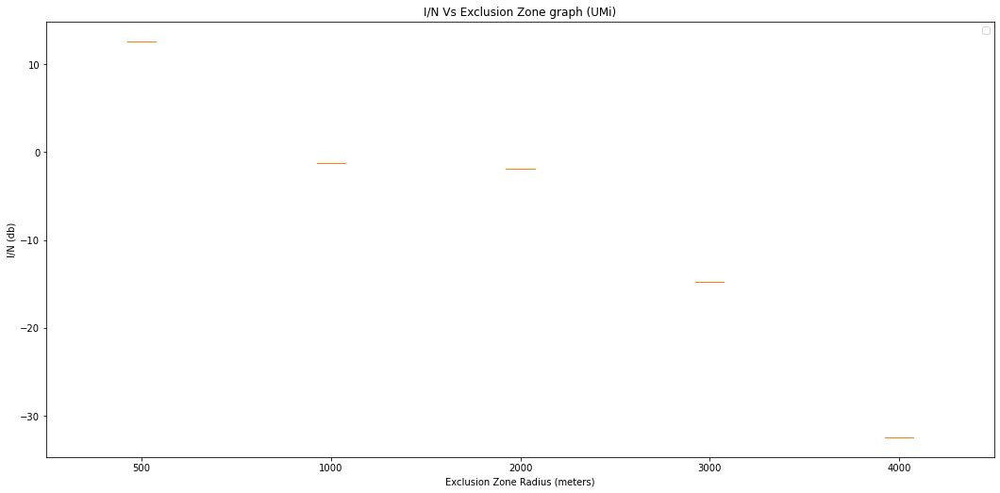

In [44]:
# EXCLUSION ZONE

# Creating dataset
# distance, interface_Noise = pairs_noAverage['UMi']
distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot([interface_Noise[exclusion_zone]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('Higher_48_degree_direc_graphUmiexclusion5km.pdf', dpi=100)
plt.show()

In [34]:
'''# EXCLUSION ZONE (-15db BS)

# Creating dataset
distance, interface_Noise = pairs_noAverage['UMi']
# distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot( [x for x in  interface_Noise[exclusion_zone] if x < -15],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('-15dbaggregatedirecgraphUmiexclusion5km.pdf', dpi=100)
plt.show()'''

"# EXCLUSION ZONE (-15db BS)\n\n# Creating dataset\ndistance, interface_Noise = pairs_noAverage['UMi']\n# distance, interface_Noise = pairs['UMi']\n \n# print(box_dict_UMi)\n \nfig, ax = plt.subplots()\n\n# Creating plot\nfor i, exclusion_zone in enumerate(exclusion_zones):\n    # key is exclusion zone\n#     ax.boxplot(interface_Noise[exclusion_zone],\n     ax.boxplot( [x for x in  interface_Noise[exclusion_zone] if x < -15],\n               patch_artist=True,\n               positions=[i],\n               boxprops=dict(facecolor='white'))\n\n# keys = sorted([key for key in box_dict_UMi])\n# ax.boxplot([box_dict_UMi[key] for key in keys])\nax.set_xticklabels([int(i) for i in exclusion_zones])\n \nax.set_title('I/N Vs Exclusion Zone graph (UMi)')\nax.set_xlabel('Exclusion Zone Radius (meters)')\nax.set_ylabel('I/N (db)')\nax.legend()\n\n# show plot\n# plt.show()\nfig.set_size_inches(18, 8.5)\n# fig.savefig('-15dbaggregatedirecgraphUmiexclusion5km.pdf', dpi=100)\nplt.show()"

In [35]:
# for key in pairs:
#   plt.scatter(pairs[key][0], pairs[key][1], label=key)

# plt.title('Average I/N Vs Distance graph')
# plt.xlabel('Distance (meter)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()

In [36]:
# for key in pairs_noAverage:
#   plt.scatter(pairs_noAverage[key][0], pairs_noAverage[key][1], label=key)

# plt.title('I/N Vs Distance graph')
# plt.xlabel('Distance (meter)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()

2022-11-05 19:50:25,597 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


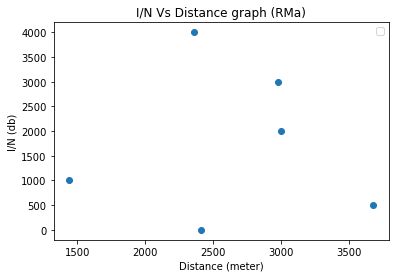

In [37]:
distance, interface_Noise = pairs_noAverage['RMa']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (RMa)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

2022-11-05 19:50:25,686 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


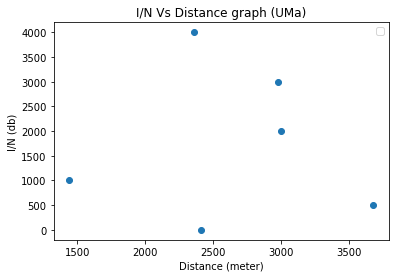

In [38]:
distance, interface_Noise = pairs_noAverage['UMa']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (UMa)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

2022-11-05 19:50:25,740 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


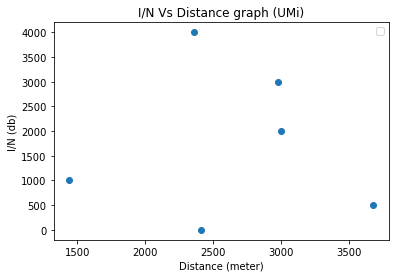

In [39]:
distance, interface_Noise = pairs_noAverage['UMi']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (UMi)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

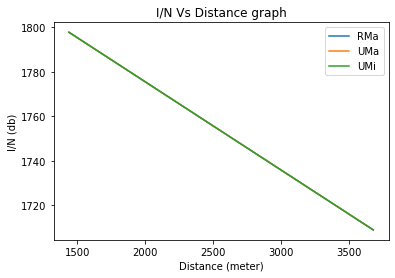

In [40]:
for key in pairs_noAverage:
  distance, interface_Noise = pairs_noAverage[key]
  distance_1D = np.array([])
  for arr in distance:
    distance_1D = np.append(distance_1D, arr)
  interface_Noise_1D = np.array([])
  for arr in interface_Noise:
    interface_Noise_1D = np.append(interface_Noise_1D, arr)
  distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance_1D, interface_Noise_1D)))
  coefficients = np.polyfit(distance_sorted, interface_Noise_sorted,1)
  # y = ax + b, where y is the average of interface_Noise_sorted
  plt.plot(np.array(distance_sorted), np.polyval(coefficients, distance_sorted), label=key)

plt.title('I/N Vs Distance graph')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

In [41]:
# from matplotlib.lines import Line2D
# output= False
# bs_ue_max_radius = 1000
# bs_ue_min_radius= 1
# base_station_count=33
# fig = plt.figure()
# ax = fig.add_subplot(111)


# fss1 = BS(radius, max_height=1.5, carr_freq=12e3, interference_type=None)
# x,y,z = 0,0,0
        
# FSS_X=np.array([])
# FSS_Y=np.array([])
# FSS_Z=np.array([])
# FSS_CHANNELS = []
# for i in range (1):
#     FSS_X = np.append(FSS_X, x)
#     FSS_Y = np.append(FSS_Y, y)
#     FSS_Z = np.append(FSS_Z, z)
#     # 0 means not in use, 1 means in use
#     channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
#     channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
#     FSS_CHANNELS.append(channels_used)
#     if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
# if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)


# BS_X=np.array([])
# BS_Y=np.array([])
# BS_Z=np.array([])

# # Randomly select base stations 
# base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

# for i in base_station_indexes:

#     lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#     bs1 = BS(radius, max_height=35, carr_freq=12e3, interference_type=None)
#     x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
#     y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
# #         z_BS = R * math.sin(math.radians(lat_BS))

#     BS_X = np.append(BS_X, x_BS - x_FSS)
#     BS_Y = np.append(BS_Y, y_BS - y_FSS)
#     BS_Z = np.append(BS_Z, 0)
#     if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))

# if output: print(BS_X,BS_Y,BS_Z)

# # Create user equipment
# UE_X=np.array([])
# UE_Y=np.array([])
# UE_Z=np.array([])
# UE_CHANNEL=np.array([])
# for p in range (len(BS_X)):
#     UE_X=np.array([])
#     UE_Y=np.array([])
#     UE_Z=np.array([])
#     UE_CHANNEL=np.array([])
#     for i in range(33):
# # number of split regions
# # i is the sector number
#         for j in range(10):
#   # number of UEs per region
#   # j is the number of the UE in one sector
#             bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
#             theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
#             # 0-120, 120-240, 240-360
#             radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

#             x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
#             y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

#             UE_X = np.append(UE_X, x1)
#             UE_Y = np.append(UE_Y, y1)
#             UE_Z = np.append(UE_Z, 1.5)

#             maximum_UEs_per_channel = 4

#             if j > maximum_UEs_per_channel * BS_Channels.channel_count:
#                 raise Exception(f"BS cannot support {j} UEs")

#             count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

#             channel = random.randint(1, BS_Channels.channel_count)

#             while count[channel] >= maximum_UEs_per_channel:
#                 channel = random.randint(1, BS_Channels.channel_count)

#             count[channel] += 1

#             UE_CHANNEL = np.append(UE_CHANNEL, channel)

#             if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
#         if output: print(UE_X,UE_Y,UE_Z)
#     ax.scatter(UE_X,UE_Y,alpha=0.8, s=30,label= 'UE Location', color='green',)
            

# ax.scatter(BS_X,BS_Y,alpha=0.8, s=30,label= 'BS Location', color='red')
# ax.scatter(FSS_X,FSS_Y,alpha=0.8, s=30,label= 'FSS Location',color='yellow')
# legend_handles = [Line2D([0], [0], marker='o', color='w', label='UE Location', markerfacecolor='g'),
#           Line2D([0], [0], marker='o', color='w', label='BS Location', markerfacecolor='r'),
#           Line2D([0], [0], marker='o', color='w', label='FSS Location', markerfacecolor='y')
# ]
          
# plt.legend(handles=legend_handles)

# # plt.legend(loc=2)
# plt.title('FSS, BS and UE Location plot')
# ax.set_xlabel('X Label')
# ax.set_ylabel('Y Label')

# # fig.savefig('graphcoex.pdf', dpi=100)
# plt.show()


In [42]:
import matplotlib.pyplot as plt
import numpy as np
 
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
plt.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (UMi)')
plt.xlabel('No. Of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
 
#show plot
plt.show()
# plt.save

KeyError: 1

In [ ]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
plt.boxplot([box_dict_UMa[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (UMa)')
plt.xlabel('No. Of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
 
# show plot
plt.show()


In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
plt.boxplot([box_dict_RMa[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (RMa)')
plt.xlabel('No. of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
# show plot
# plt.show()

 
# show plot
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
 
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
plt.boxplot([box_dict_UMi[key] for key in keys][0])
# ax.set_xticklabels([keys[0]])
 
# show plot
plt.show()


In [ ]:
# # Creating dataset
# box_dict_UMi = dict()
# distance, interface_Noise = pairs_noAverage['UMi']
# for i in range(len(interface_Noise)):
#     if distance[i] not in box_dict_UMi:
#         box_dict_UMi[distance[i]] = []
#     box_dict_UMi[distance[i]].append(interface_Noise[i])

# elevation_dict_UMi = dict()

# for p in range (len(BS_X)):
#     x, y, z = BS_X[p]-FSS_X[0], BS_Y[p]-FSS_Y[0], 10-FSS_Z[0]

#     distance_2D = math.sqrt(((FSS_X[0]-BS_X[p])**2)+((FSS_Y[0]- BS_Y[p])**2)+((FSS_Z[0]-10)**2))

#     theta_bs_es = math.degrees(math.atan(y/x)) % 360
#     phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
#     fss_phi_difference = abs(15 - phi_bs_es)

    
#     if distance_2D in box_dict_UMi:
#         elevation_dict_UMi[fss_phi_difference] = box_dict_UMi[distance_2D]

# plt.title('I/N Vs Elevation graph (UMi)')
# plt.xlabel('Elevation (degrees)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()


In [ ]:
# elevation_dict_UMi

In [ ]:
#Elevation angles (FSS towards to sky )
fig, ax=plt.subplots()

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}

contexts = sorted([context for context in FSS_phi], key=lambda x:FSS_phi[x])
boxplots = []

boxplots=ax.boxplot([pairs_noAverage[context][1] for context in contexts])
# for context in contexts:
#     distance, interface_Noise = pairs_noAverage[context]
#     boxplots.append(plt.boxplot(interface_Noise))

ax.set_xticklabels([FSS_phi[context] for context in contexts])

ax.set_title('I/N Vs Elevation graph')
ax.set_xlabel('Elevation (degrees)')
ax.set_ylabel('I/N (db)')
ax.legend()
plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmi.pdf', dpi=100)
plt.show()

In [ ]:
# # Creating dataset
# box_dict_UMa = dict()
# distance, interface_Noise = pairs_noAverage['UMa']
# for i in range(len(interface_Noise)):
#     if distance[i] not in box_dict_UMa:
#         box_dict_UMa[distance[i]] = []
#     box_dict_UMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# # print(box_dict_UMi)

# fig, ax= plt.subplots()
 
# # Creating plot
# keys = sorted([key for key in box_dict_UMa])
# for i, key in enumerate(keys):
#     # key is distance
#     # print(key)
#     # print(box_dict_UMi[key])
#     line_of_sight1 = box_dict_UMa[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMa[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# # keys = sorted([key for key in box_dict_UMi])
# # ax.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels([int(i) for i in keys])

# ax.set_title('I/N Vs Distance graph (UMa)')
# ax.set_xlabel('Distnace of Each BS to FSS (meters)')
# ax.set_ylabel('I/N (db)')
# ax.legend()
 
# # show plot
# # plt.show()
# fig.set_size_inches(18, 8.5)
# # fig.savefig('graphUMa.pdf', dpi=100)
# plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if not line_of_sight[i]:
        continue   
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1  else 'red'))
    
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='red' if not line_of_sight1))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi LOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if line_of_sight[i]:
        continue
        
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1))
    
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='red' if not line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi NLOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_RMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_RMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (RMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphRma.pdf', dpi=100)
plt.show()

In [ ]:
pathloss_UMi